## Library Import

- Importing necessary libraries for data manipulation, visualization, statistical analysis, and machine learning utilities.


In [1]:
import numpy as np 
import pandas as pd 
import matplotlib.pyplot as plt
import seaborn as sns
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from sklearn.metrics import mean_squared_error
from math import sqrt
import os
import pickle
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

## Stationarity Check and Dickey-Fuller Test

- This function `check_stationarity` visually inspects the stationarity of a time series and performs the Dickey-Fuller test.
- It takes a Series `y` as a parameter.
- It creates multiple plots to assess stationarity, including time series plot, autocorrelation plot, partial autocorrelation plot, and distribution plot.
- The Dickey-Fuller test results are printed, along with critical values, to determine stationarity.


In [2]:
def check_stationarity(y, lags_plots=48, figsize=(28,10)):
    "Use Series as parameter"
    
    # Creating plots of the DF
    y = pd.Series(y)
    fig = plt.figure()

    ax1 = plt.subplot2grid((3, 3), (0, 0), colspan=2)
    ax2 = plt.subplot2grid((3, 3), (1, 0))
    ax3 = plt.subplot2grid((3, 3), (1, 1))
    ax4 = plt.subplot2grid((3, 3), (2, 0), colspan=2)

    y.plot(ax=ax1, figsize=figsize)
    ax1.set_title('USA Temperature Variation')
    plot_acf(y, lags=lags_plots, zero=False, ax=ax2);
    plot_pacf(y, lags=lags_plots, zero=False, ax=ax3);
    sns.distplot(y, bins=int(sqrt(len(y))), ax=ax4)
    ax4.set_title('Distribution Chart')

    plt.show()
    
    print('\nResults of Dickey-Fuller Test:')
    adfinput = adfuller(y)
    adftest = pd.Series(adfinput[0:4], index=['Test Statistic','p-value','Lags Used','Number of Observations Used'])
    adftest = round(adftest,4)
    
    for key, value in adfinput[4].items():
        adftest["Critical Value (%s)"%key] = value.round(4)
        
    print(adftest)
    
    if adftest[0].round(2) < adftest[5].round(2):
        print('\nThe Test Statistics is lower than the Critical Value of 5%.\nThe serie seems to be stationary')
    else:
        print("\nThe Test Statistics is higher than the Critical Value of 5%.\nThe serie isn't stationary")
        

## Walk-Forward Validation with SARIMA Model

- This function `walk_forward` implements walk-forward validation using a SARIMA (Seasonal Autoregressive Integrated Moving Average) model.
- It takes three parameters:
  - `training_set`: The training data for model fitting.
  - `validation_set`: The validation data for forecasting.
  - `params`: A tuple containing SARIMA model parameters `((pdq), (PDQS), trend))`.
- Inside the function:
  - It initializes an empty list `history` to store the training data.
  - It iterates through each time step in the validation set:
    - Fits a SARIMA model to the historical data (`history`) using the provided parameters.
    - Forecasts one period ahead in the validation set.
    - Appends the forecasted value to the `prediction` list.
    - Updates the `history` by appending the actual value from the validation set.
- Finally, it returns the list of predictions.


In [3]:
def walk_forward(training_set, validation_set, params):
    '''
    Params: it's a tuple where you put together the following SARIMA parameters: ((pdq), (PDQS), trend)
    '''
    history = [x for x in training_set.values]
    prediction = list()
    
    # Using the SARIMA parameters and fitting the data
    pdq, PDQS, trend = params

    #Forecasting one period ahead in the validation set
    for week in range(len(validation_set)):
        model = sm.tsa.statespace.SARIMAX(history, order=pdq, seasonal_order=PDQS, trend=trend)
        result = model.fit(disp=False)
        yhat = result.predict(start=len(history), end=len(history))
        prediction.append(yhat[0])
        history.append(validation_set[week])
        
    return prediction

## Data Analysis and Visualization

- The notebook iterates through the folders and files in the specified data directory.
- For each CSV file found, it performs the following steps:
  - Reads the CSV file into a DataFrame.
  - Checks if corresponding pickle files exist. If not, continues processing.
  - Processes the data including:
    - Converting date column to datetime format.
    - Setting date column as index.
    - Handling missing values and outliers.
    - Visualizing temperature variations for each city.
    - Analyzing yearly and monthly temperature patterns.
    - Applying moving average to observe trends.
    - Conducting stationarity checks and Dickey-Fuller tests.
    - Implementing SARIMA models for forecasting.
    - Assessing model performance with RMSE metrics.
    - Saving trained models as pickle files for future use.
  - Plots the comparison between actual and extrapolated temperature values.
  - Evaluates baseline and extrapolated predictions' RMSE to quantify forecasting improvements.


Processing files in folder: Afghanistan
Processing files in folder: Albania
Processing files in folder: Algeria
Processing files in folder: American Samoa
Processing files in folder: Andorra
Processing files in folder: Angola
Processing files in folder: Anguilla
Processing files in folder: Antigua & Barbuda
Processing files in folder: Argentina
Processing files in folder: Armenia
Processing files in folder: Aruba
Processing files in folder: Australia
Processing files in folder: Austria
Processing files in folder: Azerbaijan
Processing files in folder: Bahamas
Processing files in folder: Bahrain
Processing files in folder: Bangladesh
Processing files in folder: Barbados
Processing files in folder: Belarus
Processing files in folder: Belgium
Processing files in folder: Belize
Processing files in folder: Benin
Processing files in folder: Bermuda
Processing files in folder: Bhutan
Processing files in folder: Bolivia
Processing files in folder: Bosnia & Herzegovina
Processing files in folde

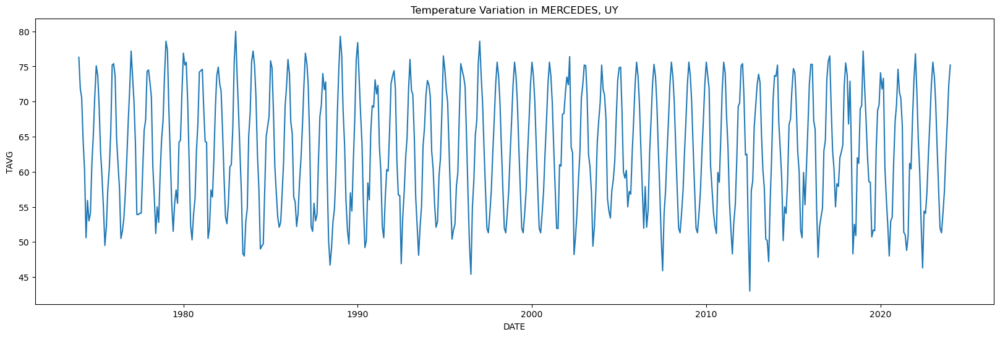

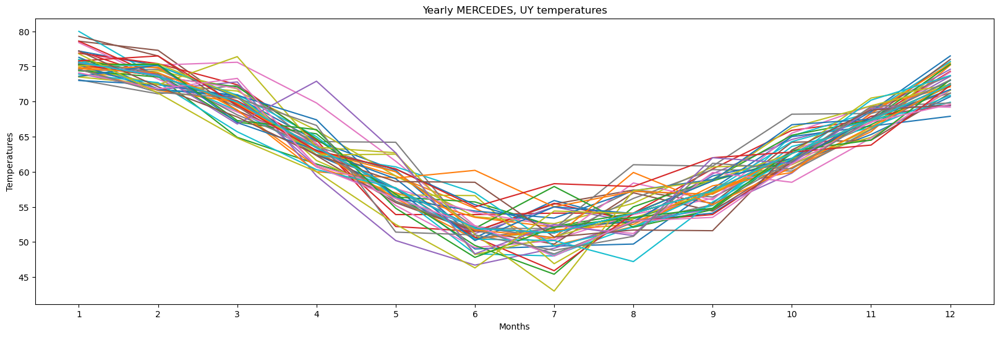

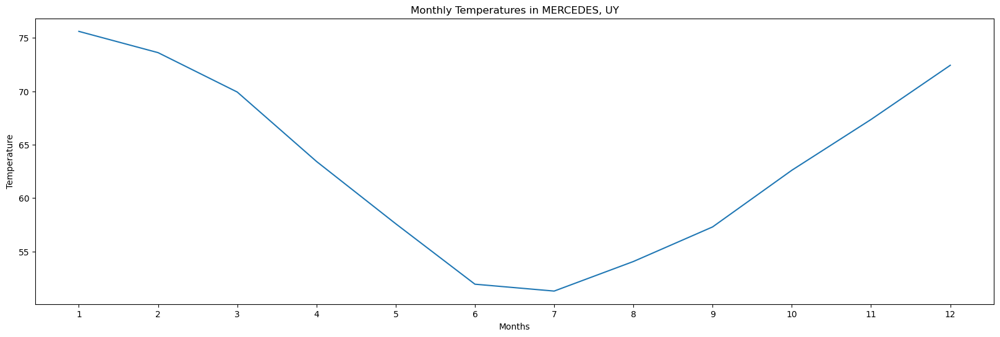

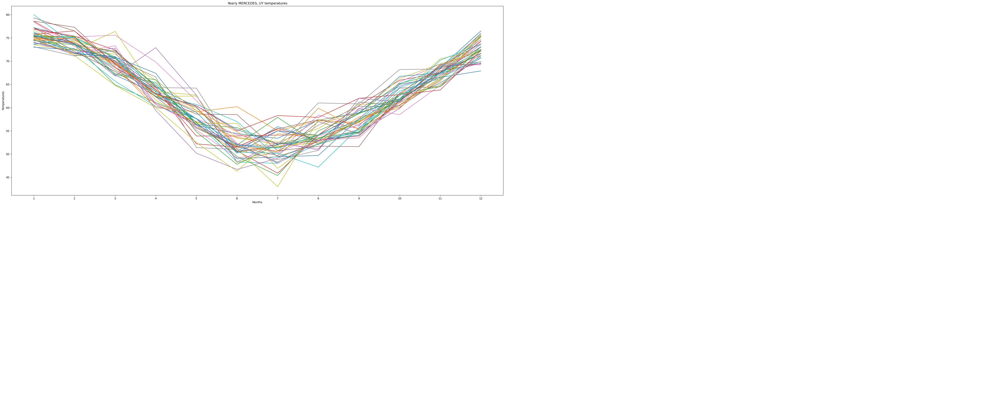

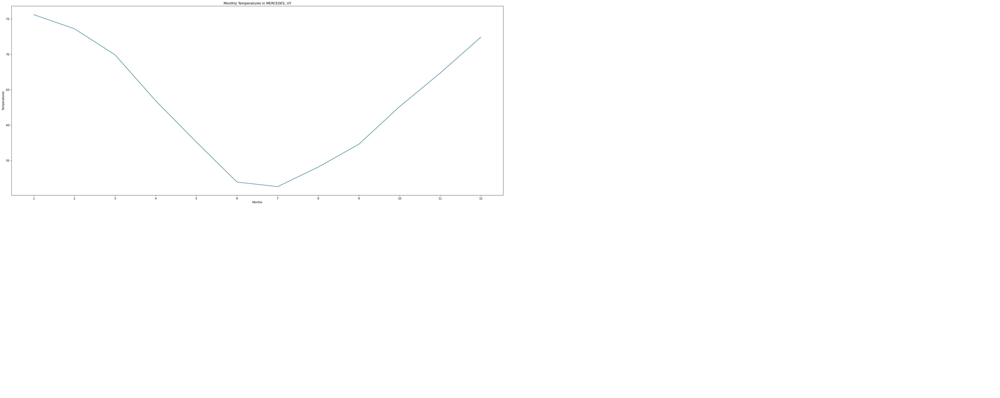

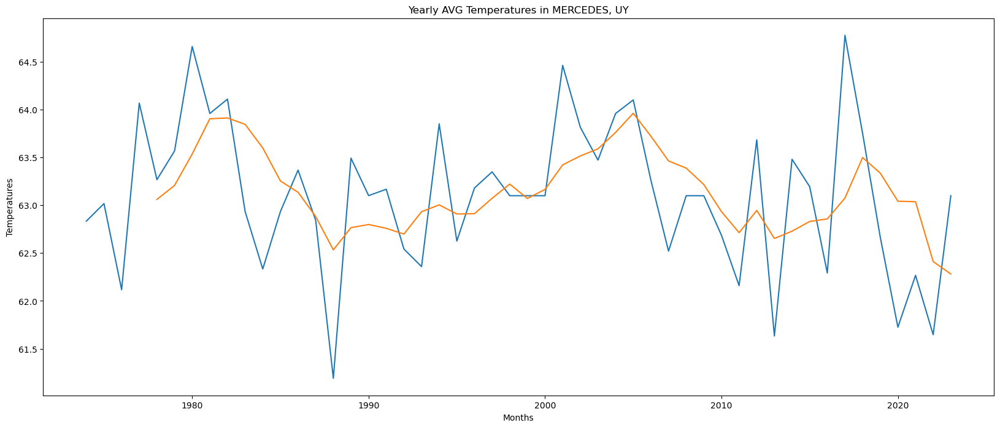

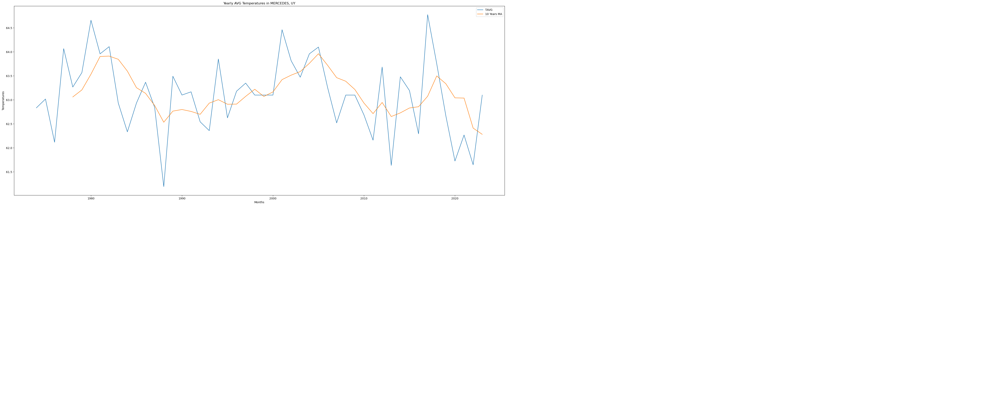

	 MERCEDES, UY  data :
                 STATION          NAME   TAVG
DATE                                        
1974-01-01  UY000086490  MERCEDES, UY  76.30
1974-02-01  UY000086490  MERCEDES, UY  71.80
1974-03-01  UY000086490  MERCEDES, UY  70.60
1974-04-01  UY000086490  MERCEDES, UY  64.40
1974-05-01  UY000086490  MERCEDES, UY  60.20
...                 ...           ...    ...
2023-09-01  UY000086490  MERCEDES, UY  57.30
2023-10-01  UY000086490  MERCEDES, UY  62.61
2023-11-01  UY000086490  MERCEDES, UY  67.36
2023-12-01  UY000086490  MERCEDES, UY  72.43
2024-01-01  UY000086490  MERCEDES, UY  75.20

[601 rows x 3 columns] 




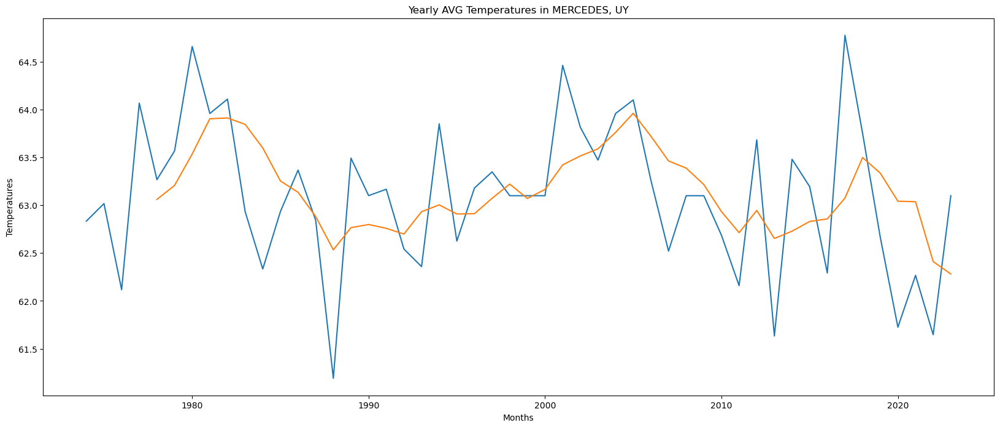

Baseline data in validation DATE
2019-02-01    77.2
2019-03-01    72.1
2019-04-01    67.8
2019-05-01    62.4
2019-06-01    58.6
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 5.6881 celsius degrees 




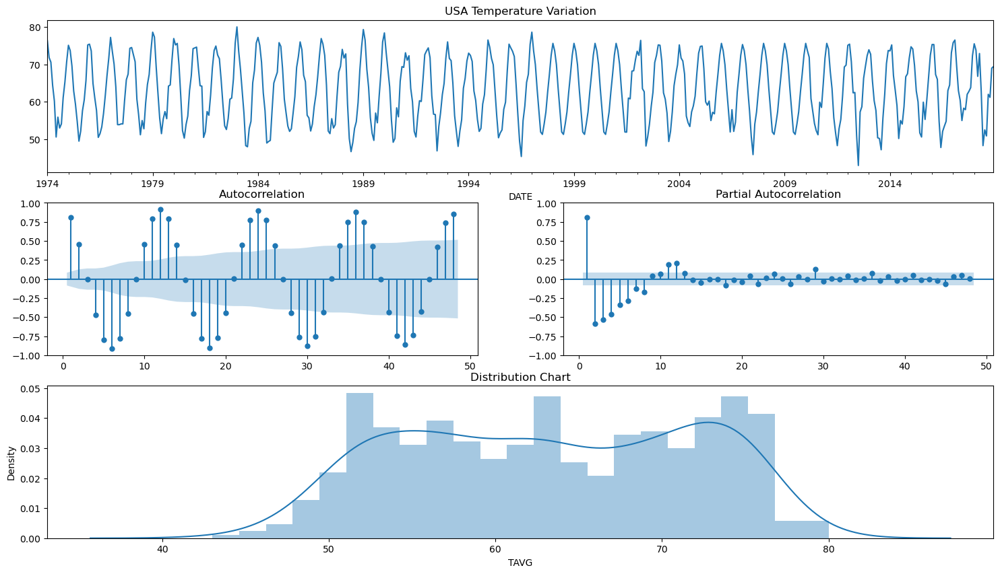


Results of Dickey-Fuller Test:
Test Statistic                  -5.2482
p-value                          0.0000
Lags Used                       17.0000
Number of Observations Used    522.0000
Critical Value (1%)             -3.4429
Critical Value (5%)             -2.8671
Critical Value (10%)            -2.5697
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


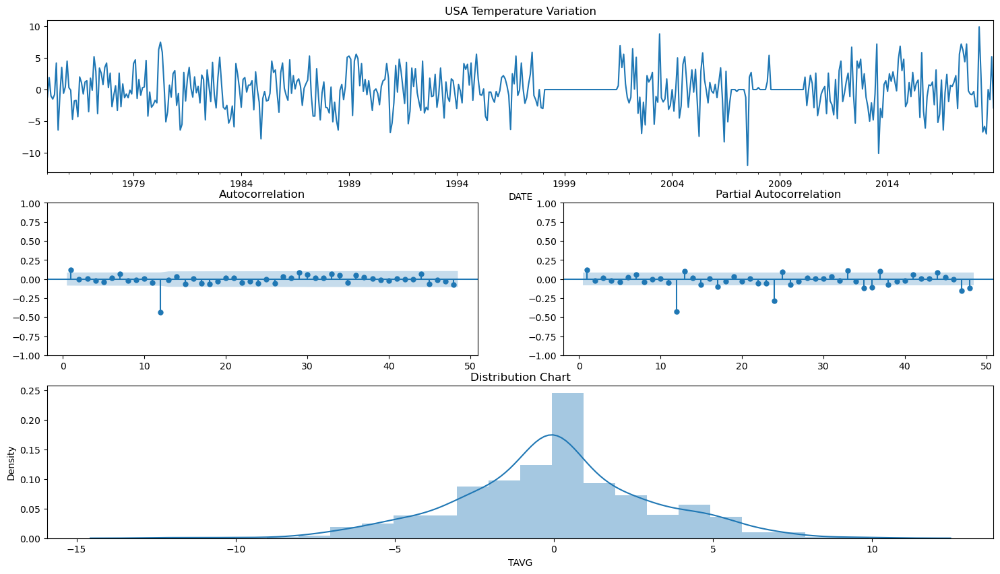


Results of Dickey-Fuller Test:
Test Statistic                  -7.7807
p-value                          0.0000
Lags Used                       16.0000
Number of Observations Used    511.0000
Critical Value (1%)             -3.4432
Critical Value (5%)             -2.8672
Critical Value (10%)            -2.5698
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 2.8062 celsius degrees
It's a decrease of -50.66% in the RMSE
                STATION          NAME  TAVG       Pred     Error
DATE                                                            
2019-01-01  UY000086490  MERCEDES, UY  77.2  75.066919  2.133081
2019-02-01  UY000086490  MERCEDES, UY  72.1  74.113696 -2.013696
2019-03-01  UY000086490  MERCEDES, UY  67.8  69.713247 -1.913247
2019-04-01  UY000086490  MERCEDES, UY  62.4  63.239241 -0.839241
2019-05-01  UY000086490  MERCEDES, UY  58.6  57.683831  0.916169 




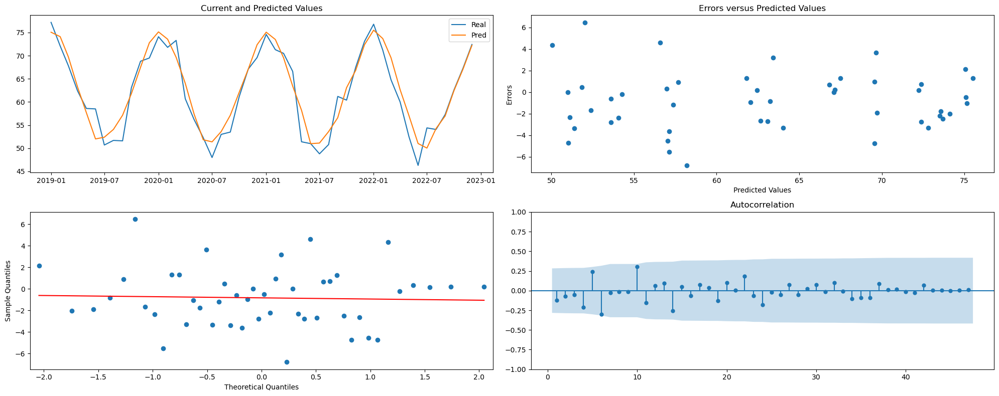

DATE
1974-01-01    76.3
1974-02-01    71.8
1974-03-01    70.6
1974-04-01    64.4
1974-05-01    60.2
Name: TAVG, dtype: float64 




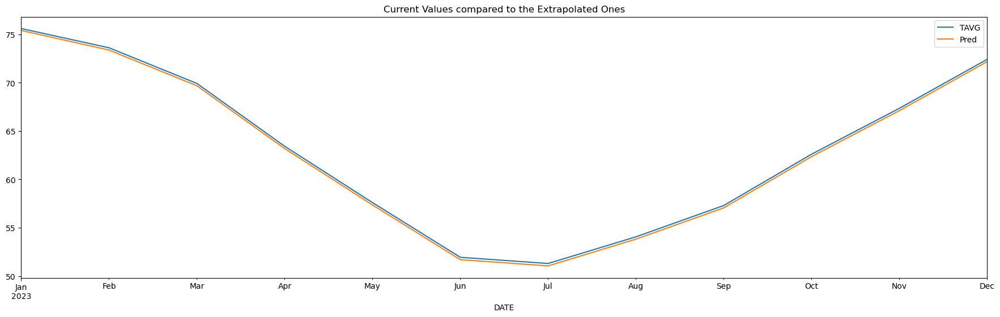

The baseline RMSE for the test baseline was 4.29 celsius degrees
The baseline RMSE for the test extrapolation was 0.24 celsius degrees
That is an improvement of 94.43%
Processing files in folder: Uzbekistan
Reading file: Uzbekistan.csv
       STATION        NAME        DATE  TAVG
0  UZM00038262  CIMBAJ, UZ  1974-01-01  13.2
1  UZM00038262  CIMBAJ, UZ  1974-02-01  12.9
2  UZM00038262  CIMBAJ, UZ  1974-03-01  36.6
3  UZM00038262  CIMBAJ, UZ  1974-04-01  54.0
4  UZM00038262  CIMBAJ, UZ  1974-05-01  71.0

                STATION        NAME  TAVG
DATE                                     
1974-01-01  UZM00038262  CIMBAJ, UZ  13.2
1974-02-01  UZM00038262  CIMBAJ, UZ  12.9
1974-03-01  UZM00038262  CIMBAJ, UZ  36.6
1974-04-01  UZM00038262  CIMBAJ, UZ  54.0
1974-05-01  UZM00038262  CIMBAJ, UZ  71.0
...                 ...         ...   ...
2023-09-01  UZM00038262  CIMBAJ, UZ  66.7
2023-10-01  UZM00038262  CIMBAJ, UZ  55.3
2023-11-01  UZM00038262  CIMBAJ, UZ  49.0
2023-12-01  UZM00038262  CIMBAJ

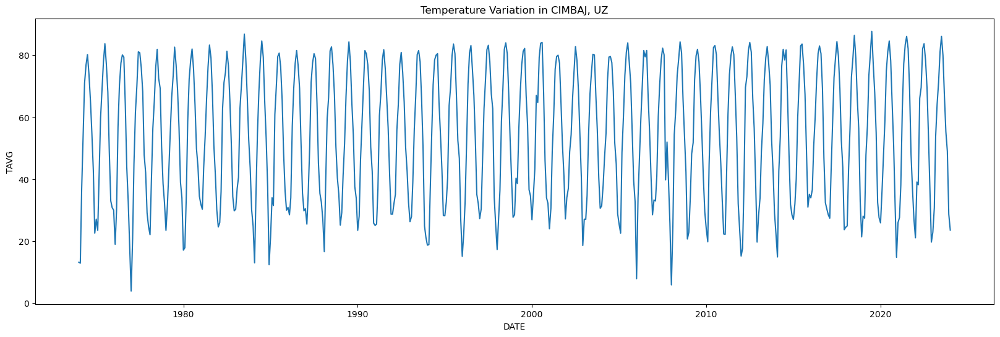

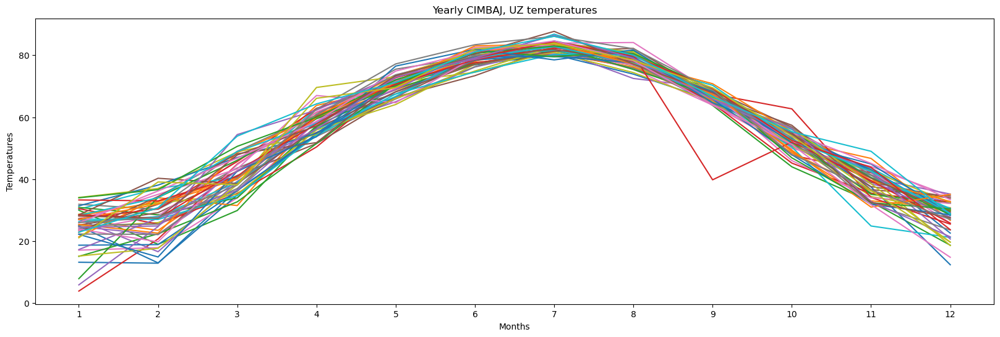

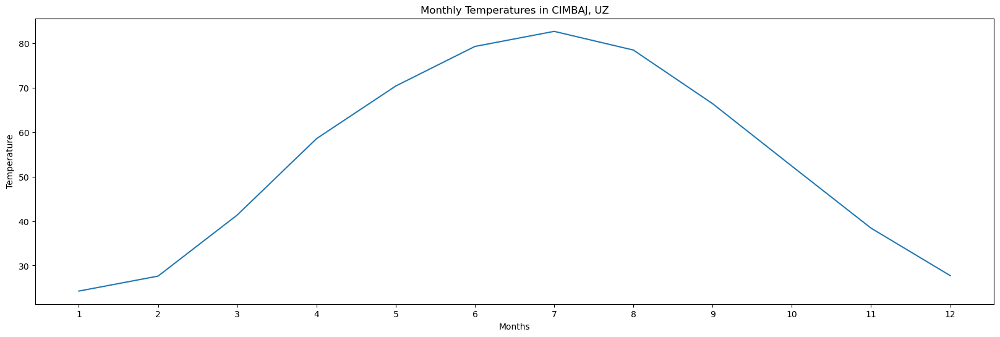

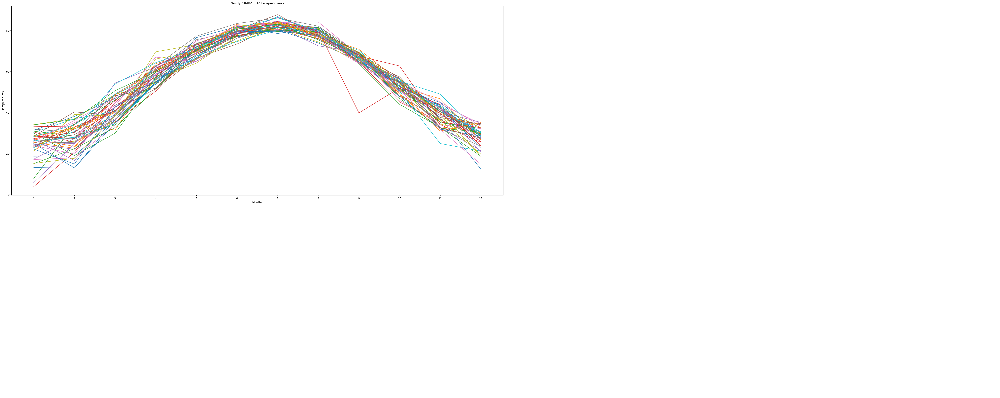

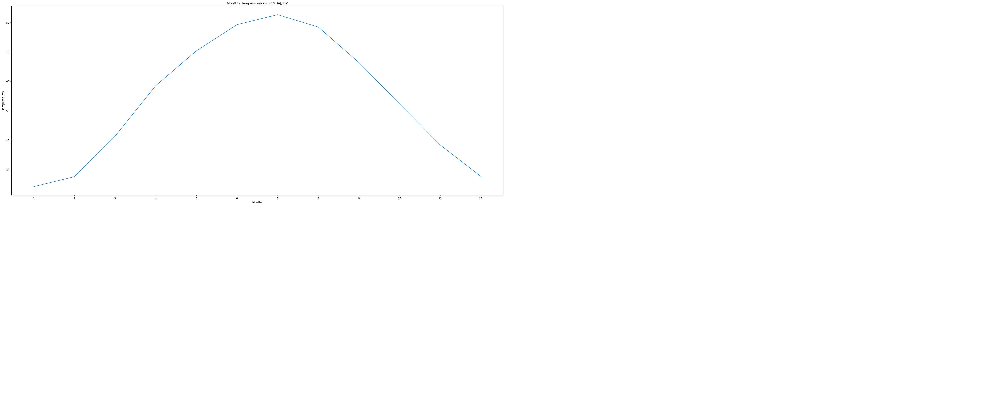

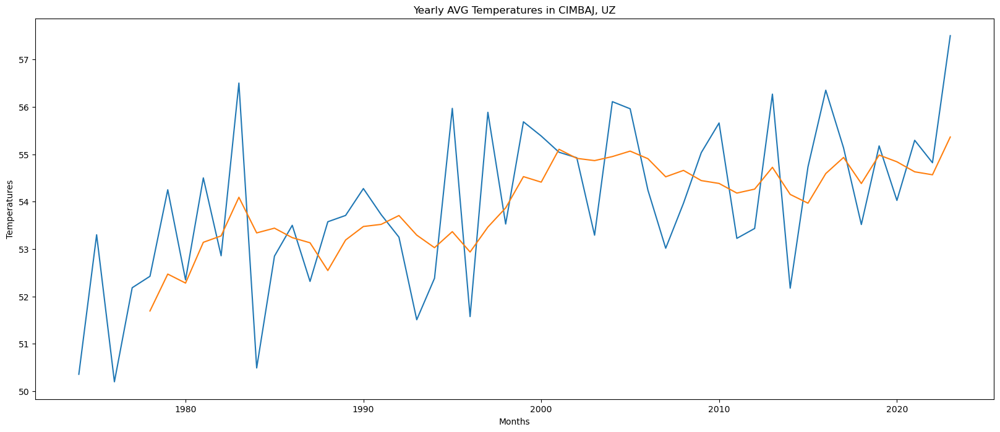

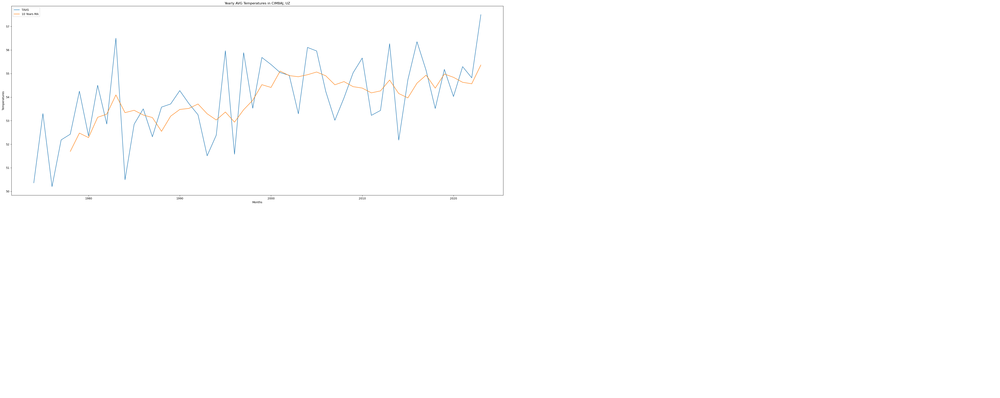

	 CIMBAJ, UZ  data :
                 STATION        NAME  TAVG
DATE                                     
1974-01-01  UZM00038262  CIMBAJ, UZ  13.2
1974-02-01  UZM00038262  CIMBAJ, UZ  12.9
1974-03-01  UZM00038262  CIMBAJ, UZ  36.6
1974-04-01  UZM00038262  CIMBAJ, UZ  54.0
1974-05-01  UZM00038262  CIMBAJ, UZ  71.0
...                 ...         ...   ...
2023-09-01  UZM00038262  CIMBAJ, UZ  66.7
2023-10-01  UZM00038262  CIMBAJ, UZ  55.3
2023-11-01  UZM00038262  CIMBAJ, UZ  49.0
2023-12-01  UZM00038262  CIMBAJ, UZ  28.7
2024-01-01  UZM00038262  CIMBAJ, UZ  23.6

[601 rows x 3 columns] 




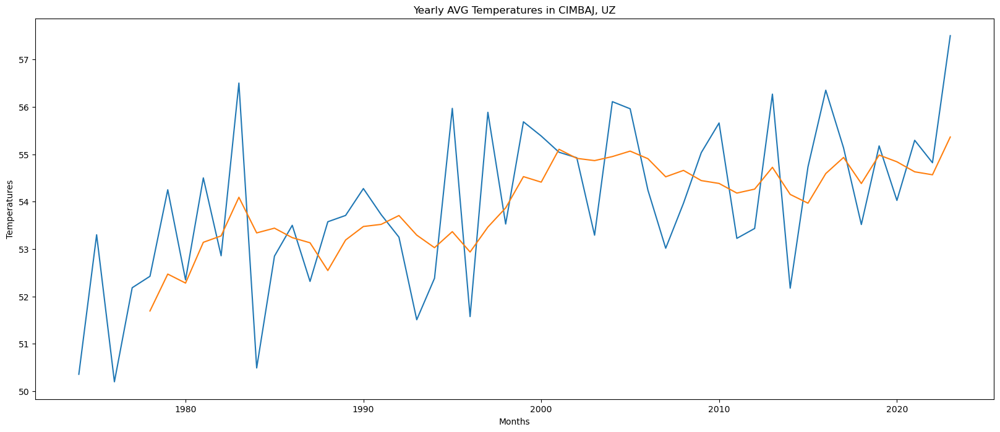

Baseline data in validation DATE
2019-02-01    28.1
2019-03-01    27.4
2019-04-01    47.8
2019-05-01    57.2
2019-06-01    73.4
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 12.802 celsius degrees 




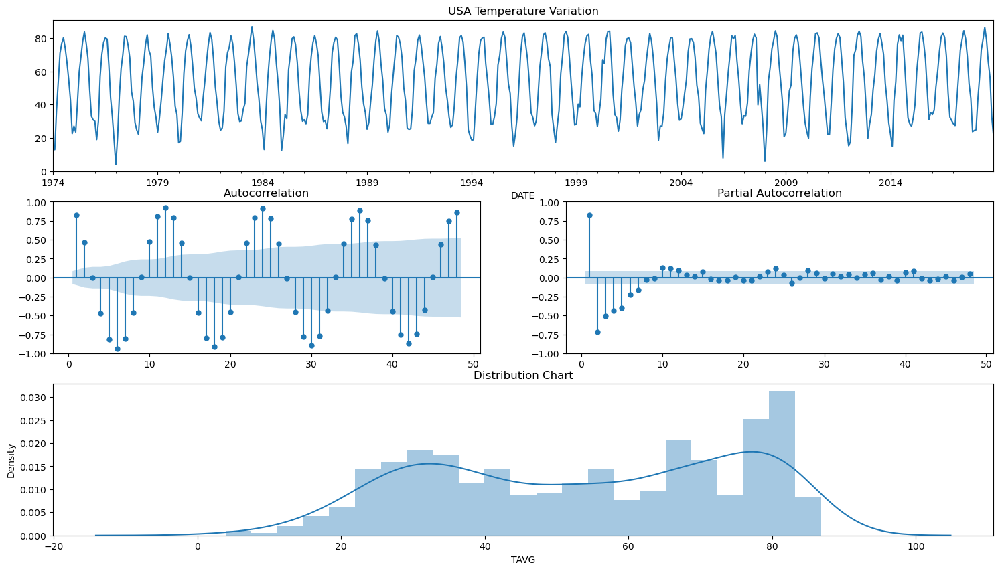


Results of Dickey-Fuller Test:
Test Statistic                  -5.7881
p-value                          0.0000
Lags Used                       17.0000
Number of Observations Used    522.0000
Critical Value (1%)             -3.4429
Critical Value (5%)             -2.8671
Critical Value (10%)            -2.5697
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


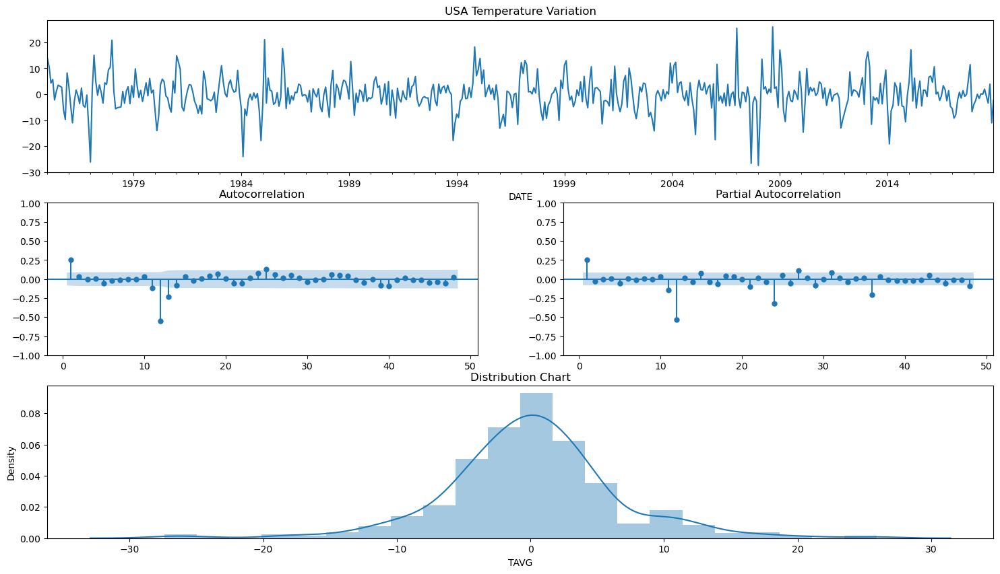


Results of Dickey-Fuller Test:
Test Statistic                 -13.2974
p-value                          0.0000
Lags Used                       11.0000
Number of Observations Used    516.0000
Critical Value (1%)             -3.4431
Critical Value (5%)             -2.8672
Critical Value (10%)            -2.5698
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 4.3506 celsius degrees
It's a decrease of -66.02% in the RMSE
                STATION        NAME  TAVG       Pred     Error
DATE                                                          
2019-01-01  UZM00038262  CIMBAJ, UZ  28.1  23.833084  4.266916
2019-02-01  UZM00038262  CIMBAJ, UZ  27.4  29.509007 -2.109007
2019-03-01  UZM00038262  CIMBAJ, UZ  47.8  43.474293  4.325707
2019-04-01  UZM00038262  CIMBAJ, UZ  57.2  60.367861 -3.167861
2019-05-01  UZM00038262  CIMBAJ, UZ  73.4  71.572923  1.827077 




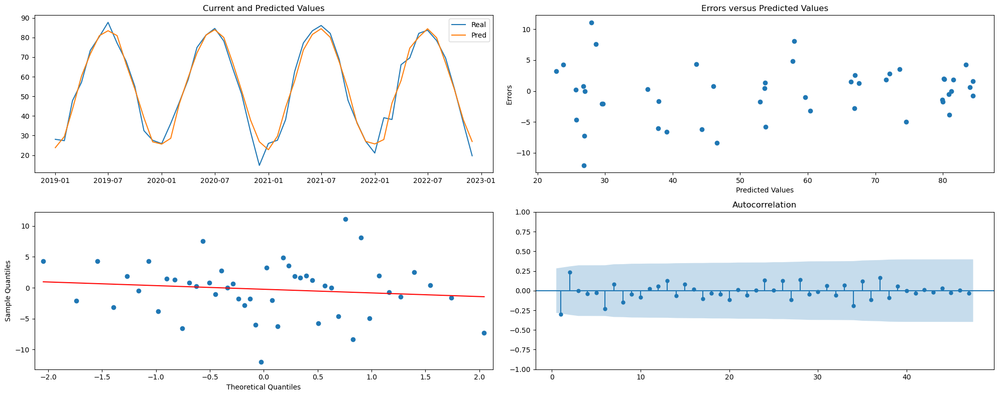

DATE
1974-01-01    13.2
1974-02-01    12.9
1974-03-01    36.6
1974-04-01    54.0
1974-05-01    71.0
Name: TAVG, dtype: float64 




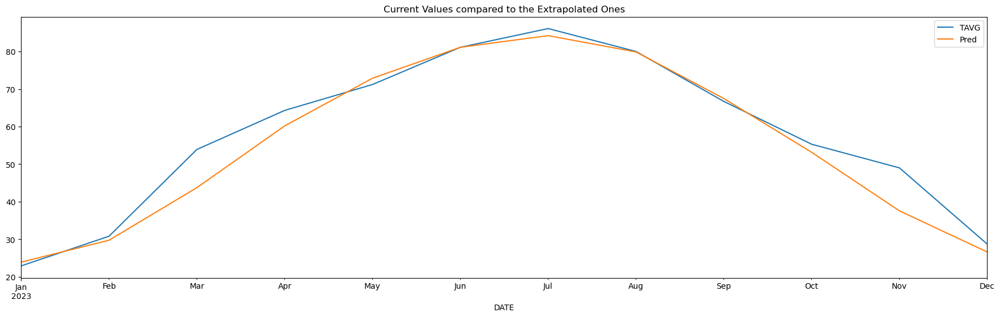

The baseline RMSE for the test baseline was 11.8 celsius degrees
The baseline RMSE for the test extrapolation was 4.74 celsius degrees
That is an improvement of 59.84%
Processing files in folder: Vanuatu
Reading file: Vanuatu.csv
   STATION     NAME        DATE  TAVG
0      103  Vanuatu  1974-01-01  80.6
1      103  Vanuatu  1974-02-01  78.9
2      103  Vanuatu  1974-03-01  79.9
3      103  Vanuatu  1974-04-01  79.6
4      103  Vanuatu  1974-05-01  78.3

            STATION     NAME   TAVG
DATE                               
1974-01-01      103  Vanuatu  80.60
1974-02-01      103  Vanuatu  78.90
1974-03-01      103  Vanuatu  79.90
1974-04-01      103  Vanuatu  79.60
1974-05-01      103  Vanuatu  78.30
...             ...      ...    ...
2023-09-01      103  Vanuatu  80.80
2023-10-01      103  Vanuatu  81.50
2023-11-01      103  Vanuatu  84.30
2023-12-01      103  Vanuatu  82.18
2024-01-01      103  Vanuatu  85.00

[601 rows x 3 columns]

Index(['STATION', 'NAME', 'TAVG'], dtype='object

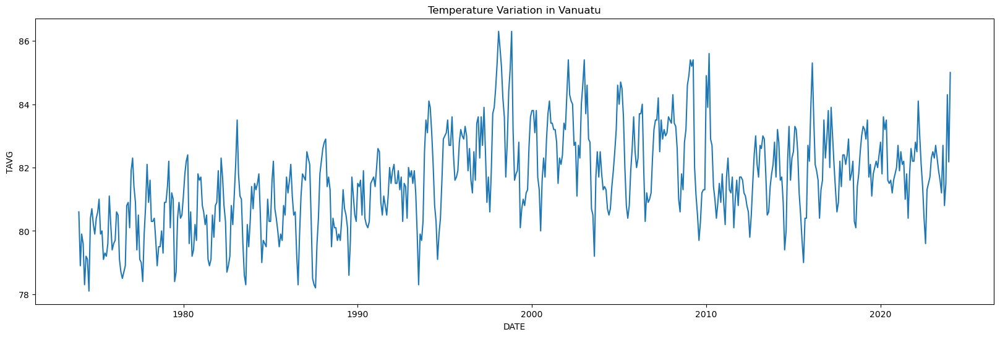

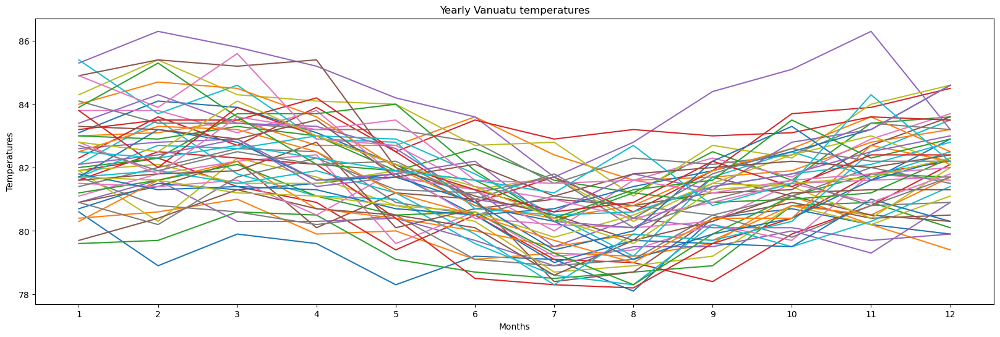

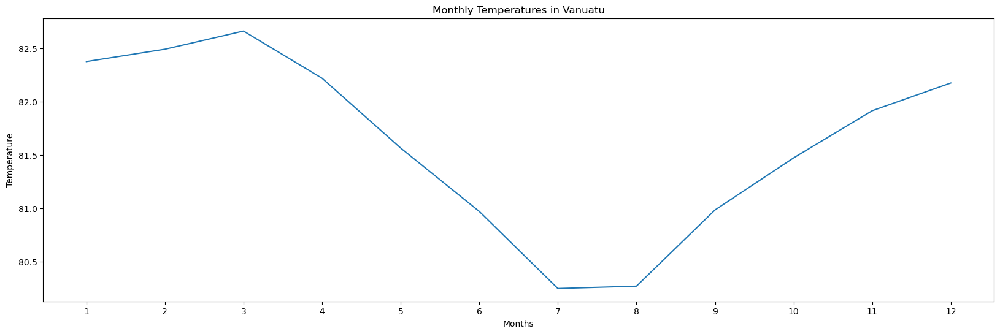

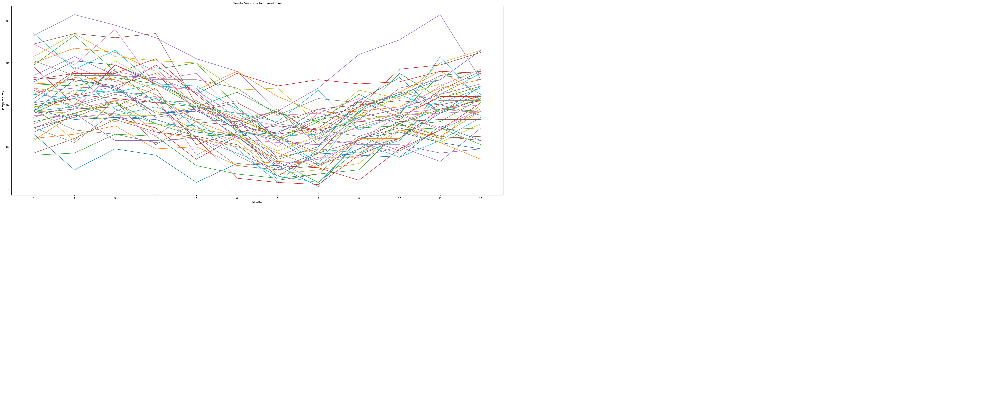

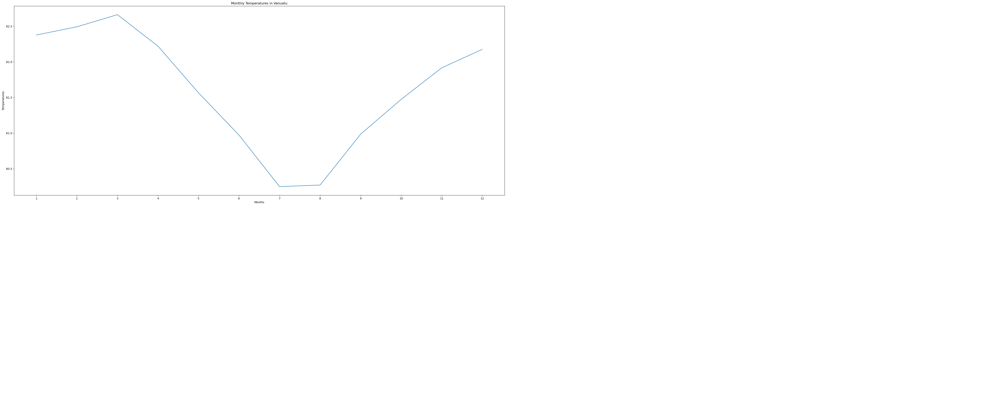

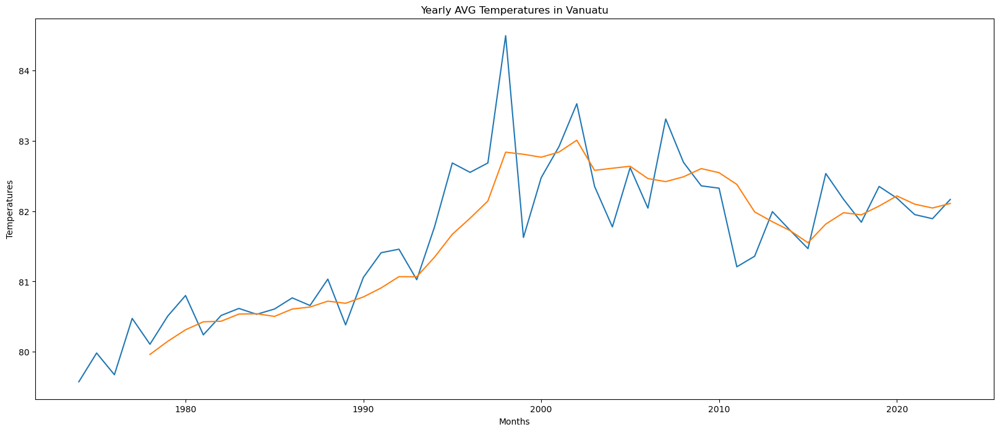

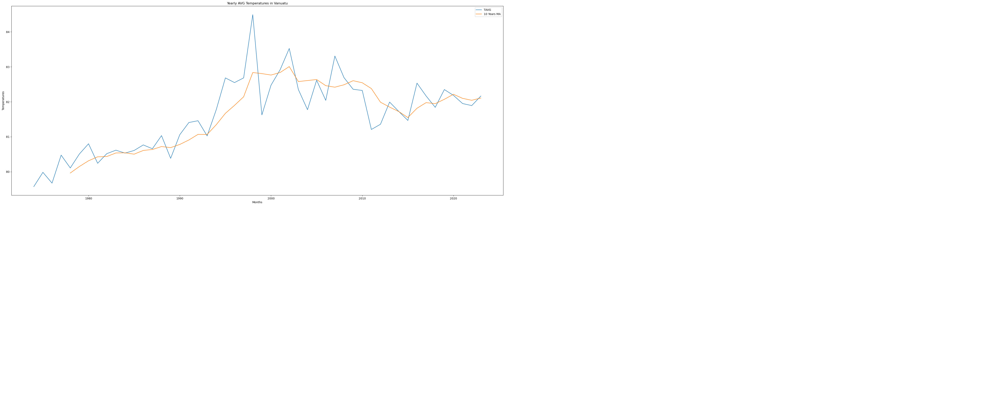

	 Vanuatu  data :
             STATION     NAME   TAVG
DATE                               
1974-01-01      103  Vanuatu  80.60
1974-02-01      103  Vanuatu  78.90
1974-03-01      103  Vanuatu  79.90
1974-04-01      103  Vanuatu  79.60
1974-05-01      103  Vanuatu  78.30
...             ...      ...    ...
2023-09-01      103  Vanuatu  80.80
2023-10-01      103  Vanuatu  81.50
2023-11-01      103  Vanuatu  84.30
2023-12-01      103  Vanuatu  82.18
2024-01-01      103  Vanuatu  85.00

[601 rows x 3 columns] 




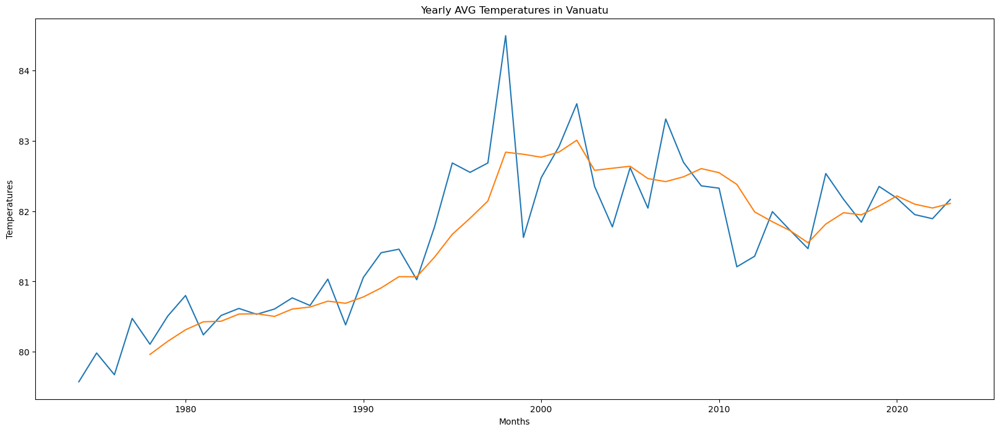

Baseline data in validation DATE
2019-02-01    83.3
2019-03-01    83.2
2019-04-01    82.9
2019-05-01    83.5
2019-06-01    81.7
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 0.8412 celsius degrees 




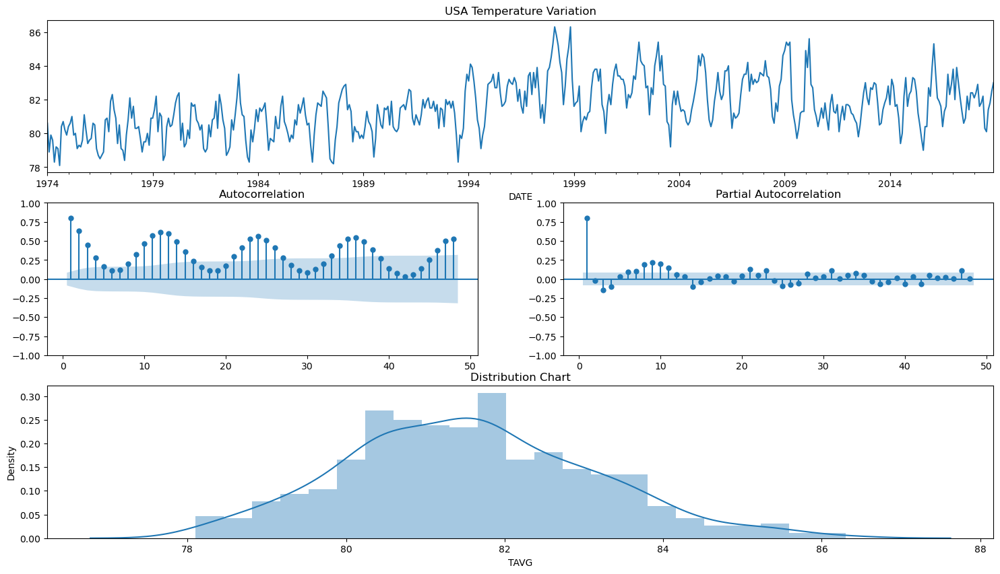


Results of Dickey-Fuller Test:
Test Statistic                  -2.6187
p-value                          0.0892
Lags Used                       13.0000
Number of Observations Used    526.0000
Critical Value (1%)             -3.4428
Critical Value (5%)             -2.8671
Critical Value (10%)            -2.5697
dtype: float64

The Test Statistics is higher than the Critical Value of 5%.
The serie isn't stationary


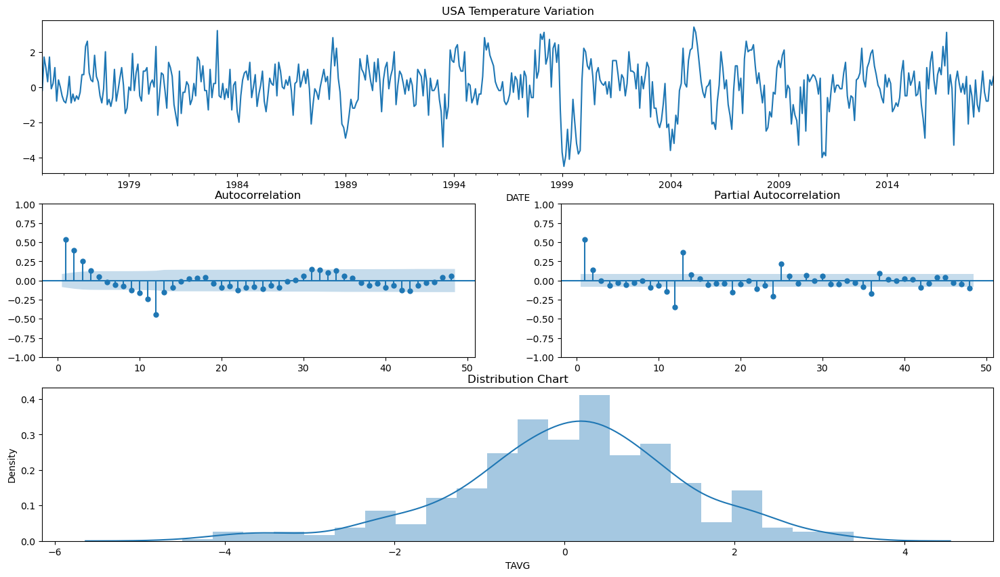


Results of Dickey-Fuller Test:
Test Statistic                  -6.6327
p-value                          0.0000
Lags Used                       18.0000
Number of Observations Used    509.0000
Critical Value (1%)             -3.4433
Critical Value (5%)             -2.8672
Critical Value (10%)            -2.5698
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 0.6429 celsius degrees
It's a decrease of -23.58% in the RMSE
            STATION     NAME  TAVG       Pred     Error
DATE                                                   
2019-01-01      103  Vanuatu  83.3  83.200097  0.099903
2019-02-01      103  Vanuatu  83.2  83.565921 -0.365921
2019-03-01      103  Vanuatu  82.9  83.516134 -0.616134
2019-04-01      103  Vanuatu  83.5  82.793830  0.706170
2019-05-01      103  Vanuatu  81.7  82.599619 -0.899619 




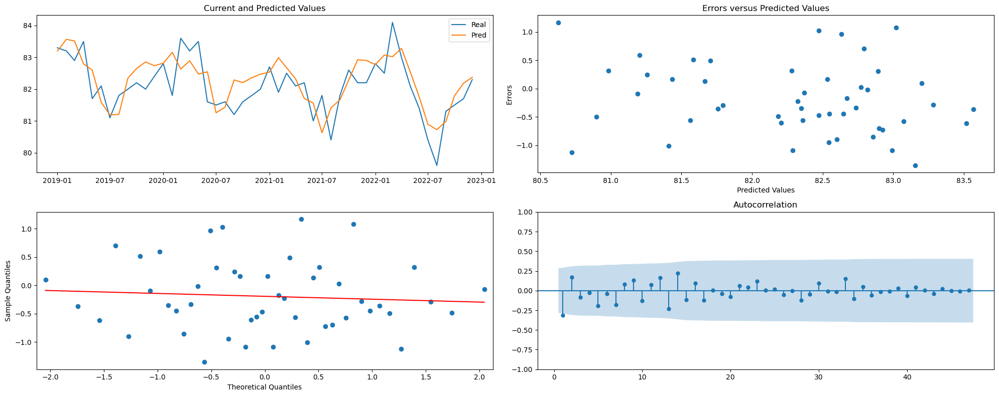

DATE
1974-01-01    80.6
1974-02-01    78.9
1974-03-01    79.9
1974-04-01    79.6
1974-05-01    78.3
Name: TAVG, dtype: float64 




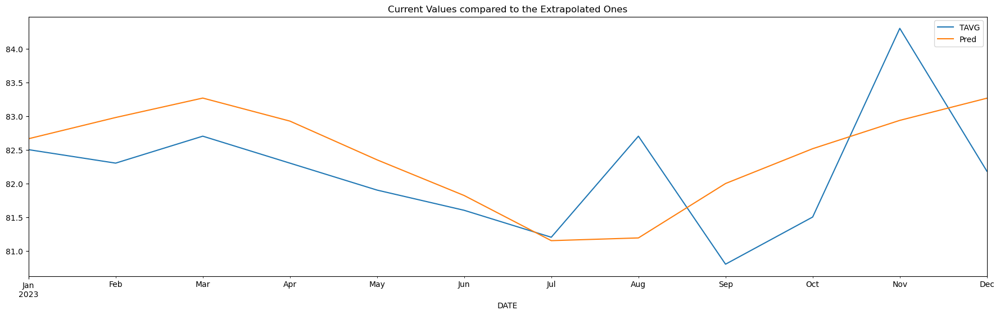

The baseline RMSE for the test baseline was 1.27 celsius degrees
The baseline RMSE for the test extrapolation was 0.88 celsius degrees
That is an improvement of 31.13%
Processing files in folder: Venezuela
Reading file: Venezuela.csv
       STATION        NAME        DATE  TAVG
0  VE000080438  MERIDA, VE  1974-01-01  64.6
1  VE000080438  MERIDA, VE  1974-02-01  65.4
2  VE000080438  MERIDA, VE  1974-03-01  65.9
3  VE000080438  MERIDA, VE  1974-04-01  68.1
4  VE000080438  MERIDA, VE  1974-05-01  67.8

                STATION        NAME   TAVG
DATE                                      
1974-01-01  VE000080438  MERIDA, VE  64.60
1974-02-01  VE000080438  MERIDA, VE  65.40
1974-03-01  VE000080438  MERIDA, VE  65.90
1974-04-01  VE000080438  MERIDA, VE  68.10
1974-05-01  VE000080438  MERIDA, VE  67.80
...                 ...         ...    ...
2013-06-01  VE000080438  MERIDA, VE  69.43
2013-07-01  VE000080438  MERIDA, VE  69.16
2013-08-01  VE000080438  MERIDA, VE  69.77
2013-09-01  VE00008043

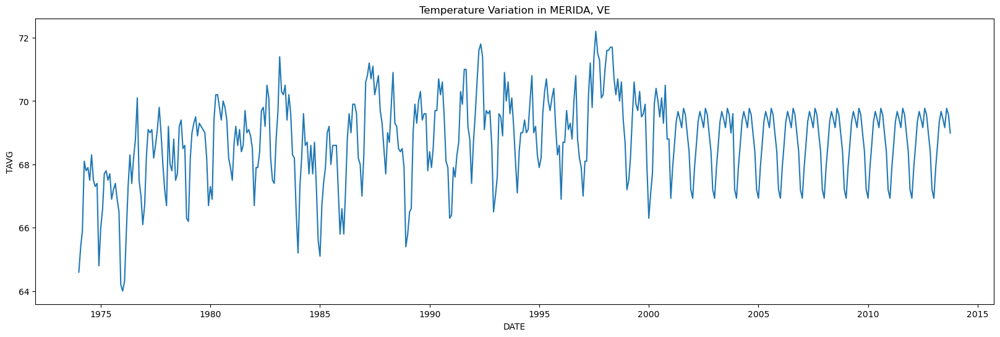

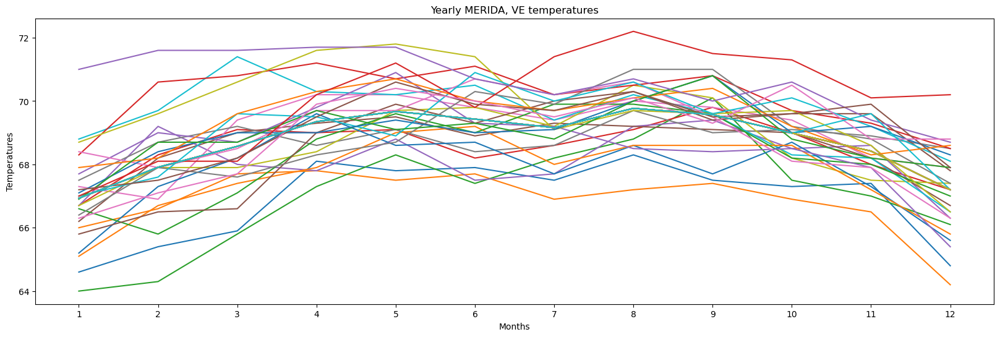

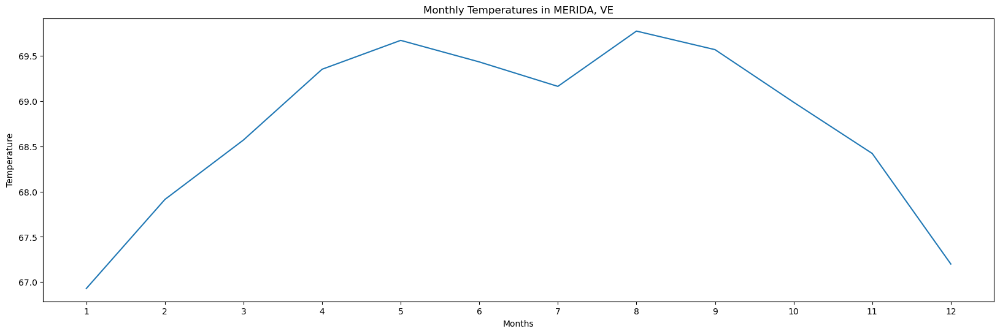

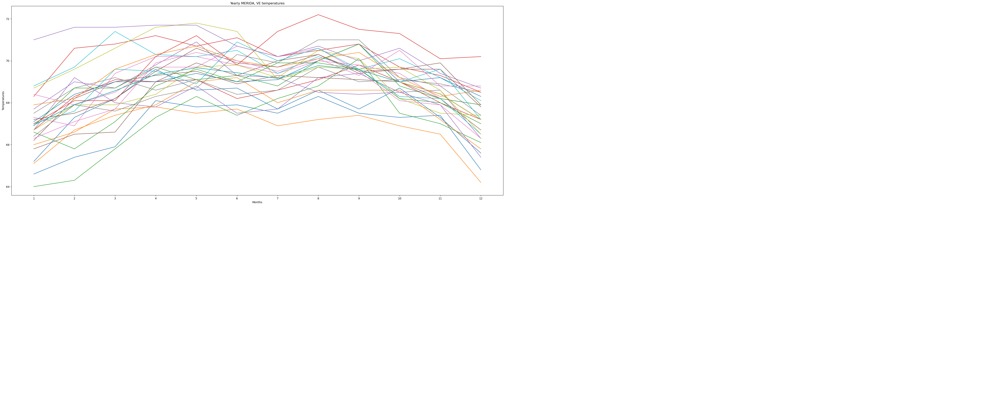

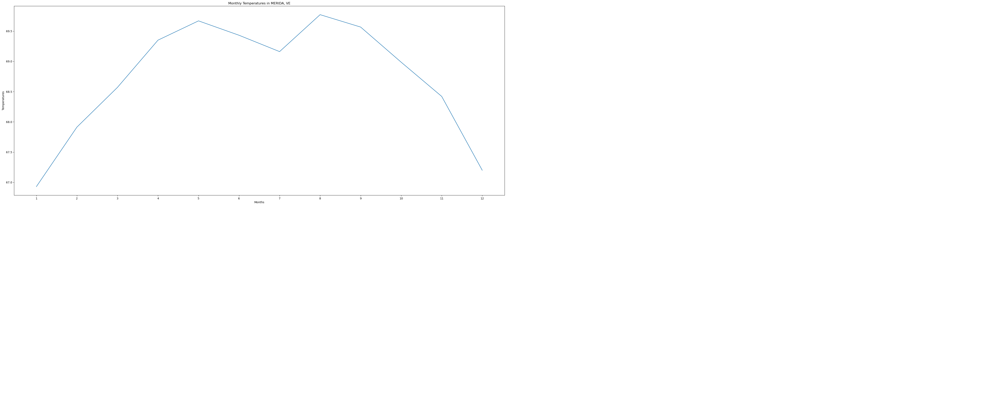

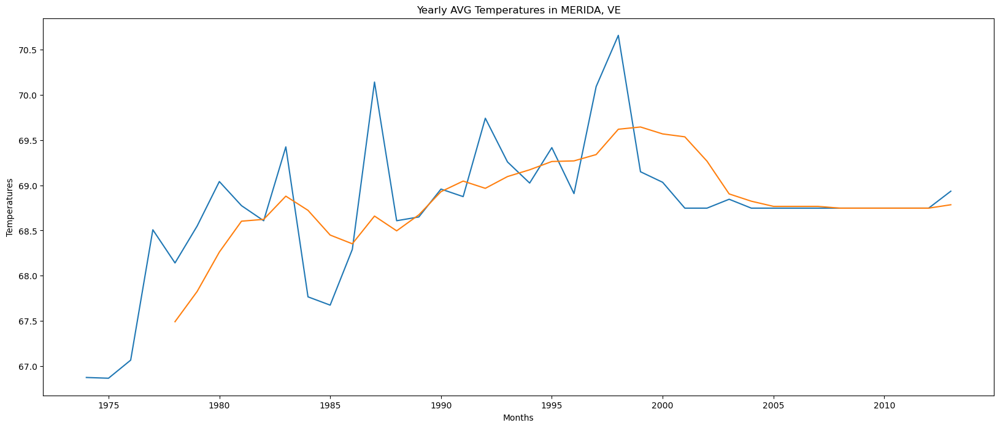

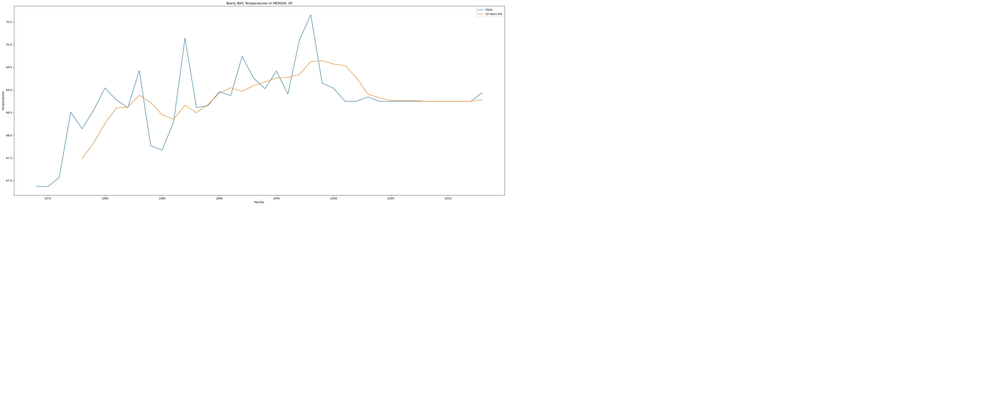

	 MERIDA, VE  data :
                 STATION        NAME   TAVG
DATE                                      
1974-01-01  VE000080438  MERIDA, VE  64.60
1974-02-01  VE000080438  MERIDA, VE  65.40
1974-03-01  VE000080438  MERIDA, VE  65.90
1974-04-01  VE000080438  MERIDA, VE  68.10
1974-05-01  VE000080438  MERIDA, VE  67.80
...                 ...         ...    ...
2013-06-01  VE000080438  MERIDA, VE  69.43
2013-07-01  VE000080438  MERIDA, VE  69.16
2013-08-01  VE000080438  MERIDA, VE  69.77
2013-09-01  VE000080438  MERIDA, VE  69.57
2013-10-01  VE000080438  MERIDA, VE  68.99

[478 rows x 3 columns] 




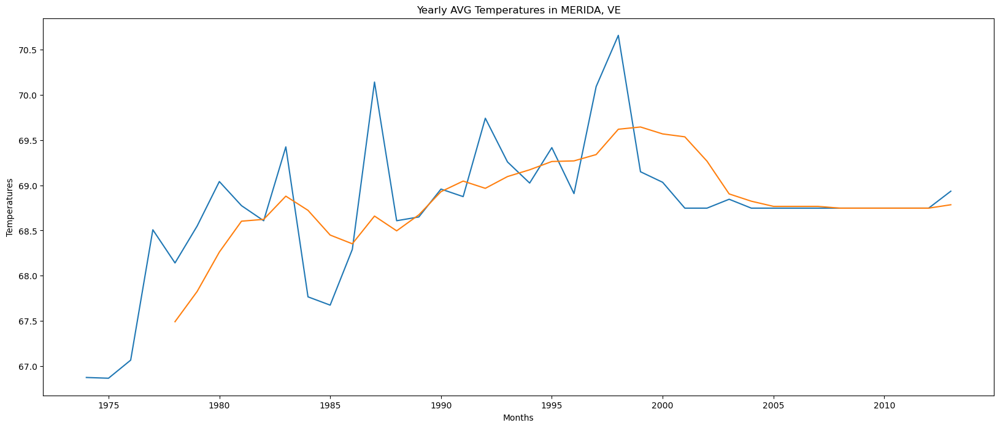

Baseline data in validation DATE
2008-12-01    68.42
2009-01-01    67.20
2009-02-01    66.93
2009-03-01    67.91
2009-04-01    68.57
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 0.6385 celsius degrees 




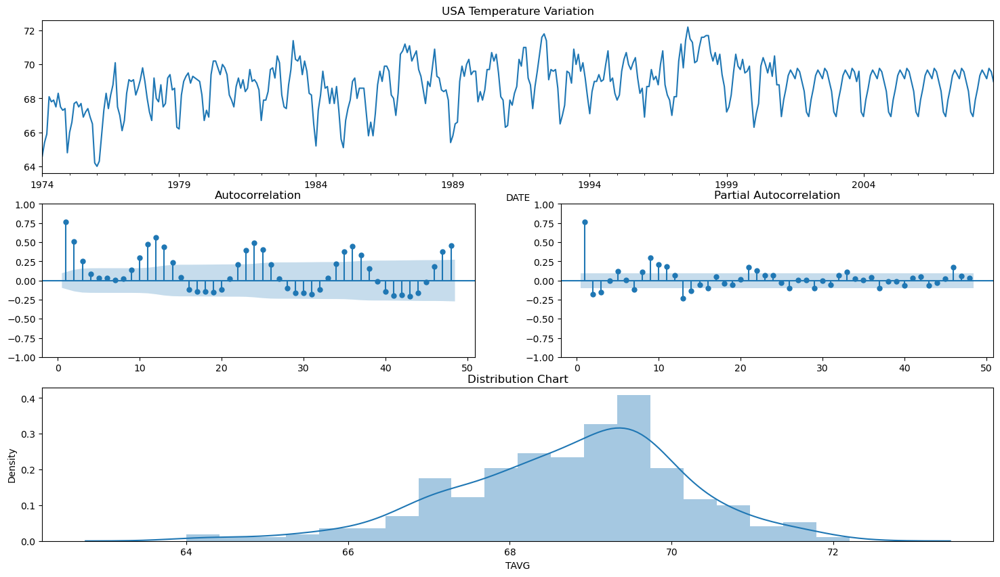


Results of Dickey-Fuller Test:
Test Statistic                  -4.1417
p-value                          0.0008
Lags Used                       15.0000
Number of Observations Used    402.0000
Critical Value (1%)             -3.4467
Critical Value (5%)             -2.8688
Critical Value (10%)            -2.5706
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


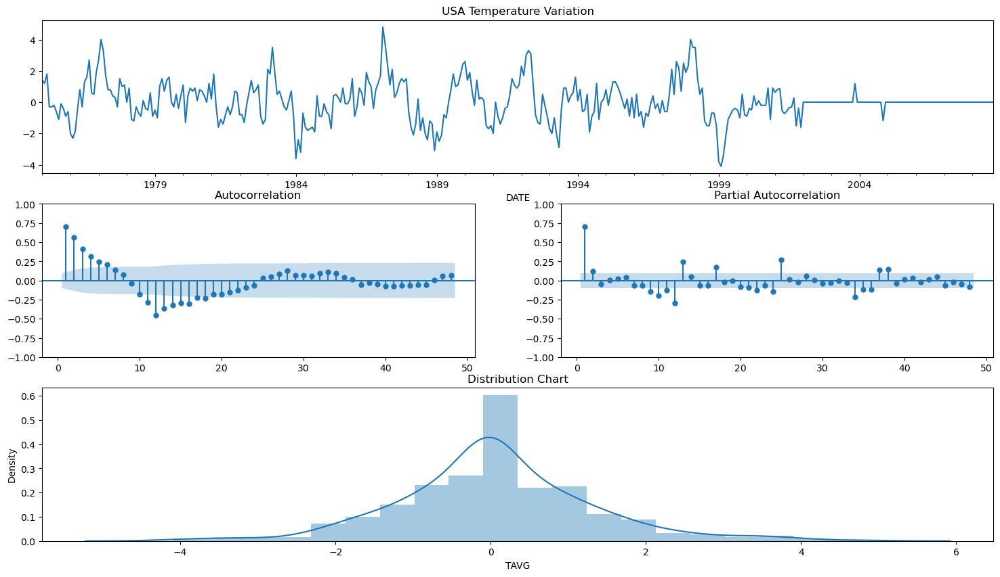


Results of Dickey-Fuller Test:
Test Statistic                  -4.9827
p-value                          0.0000
Lags Used                       16.0000
Number of Observations Used    389.0000
Critical Value (1%)             -3.4473
Critical Value (5%)             -2.8690
Critical Value (10%)            -2.5707
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 0.1259 celsius degrees
It's a decrease of -80.28% in the RMSE
                STATION        NAME   TAVG       Pred     Error
DATE                                                           
2008-11-01  VE000080438  MERIDA, VE  68.42  68.552854 -0.132854
2008-12-01  VE000080438  MERIDA, VE  67.20  67.325652 -0.125652
2009-01-01  VE000080438  MERIDA, VE  66.93  67.118492 -0.188492
2009-02-01  VE000080438  MERIDA, VE  67.91  68.066579 -0.156579
2009-03-01  VE000080438  MERIDA, VE  68.57  68.707098 -0.137098 




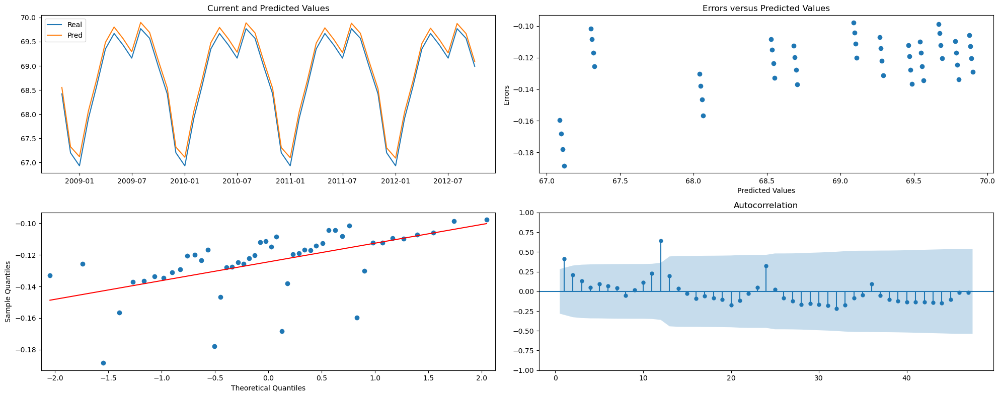

DATE
1974-01-01    64.6
1974-02-01    65.4
1974-03-01    65.9
1974-04-01    68.1
1974-05-01    67.8
Name: TAVG, dtype: float64 




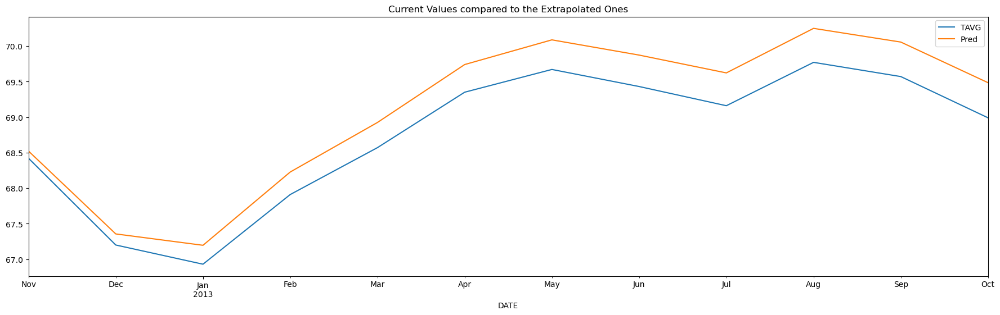

The baseline RMSE for the test baseline was 0.62 celsius degrees
The baseline RMSE for the test extrapolation was 0.38 celsius degrees
That is an improvement of 37.55%
Processing files in folder: Vietnam
Reading file: Vietnam.csv
         DATE   TAVG
0  1976-01-01  64.50
1  1976-02-01  65.31
2  1976-03-01  69.95
3  1976-04-01  77.19
4  1976-05-01  83.19

             TAVG
DATE             
1976-01-01  64.50
1976-02-01  65.31
1976-03-01  69.95
1976-04-01  77.19
1976-05-01  83.19
...           ...
2023-09-01  81.80
2023-10-01  77.86
2023-11-01  72.60
2023-12-01  63.00
2024-01-01  69.40

[577 rows x 1 columns]

Index(['TAVG'], dtype='object')
Vietnam.csv
             TAVG         NAME
DATE                          
1976-01-01  64.50  Vietnam.csv
1976-02-01  65.31  Vietnam.csv
1976-03-01  69.95  Vietnam.csv
1976-04-01  77.19  Vietnam.csv
1976-05-01  83.19  Vietnam.csv
...           ...          ...
2023-09-01  81.80  Vietnam.csv
2023-10-01  77.86  Vietnam.csv
2023-11-01  72.60  Vietnam.csv

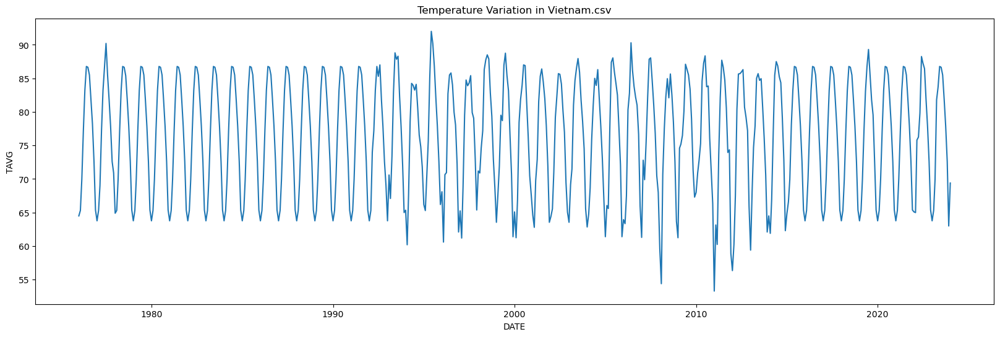

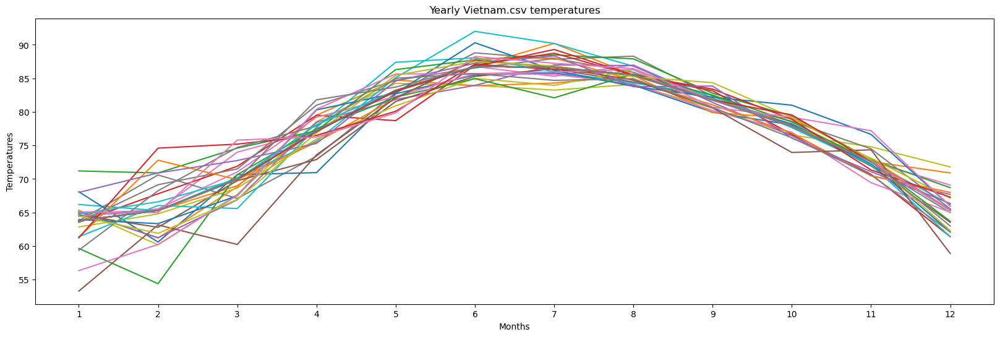

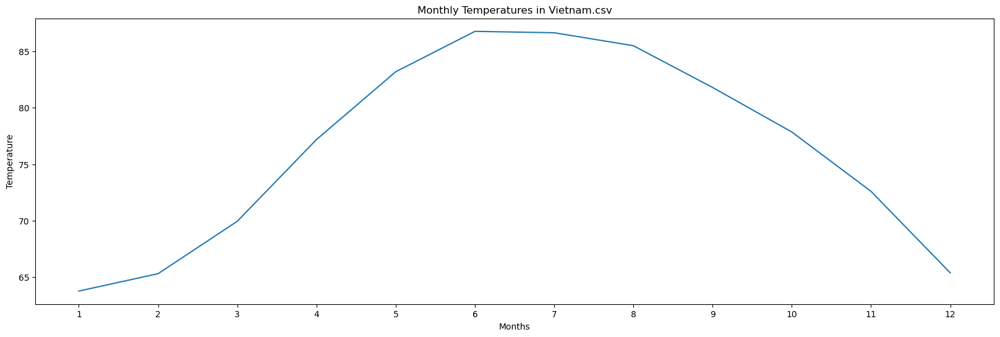

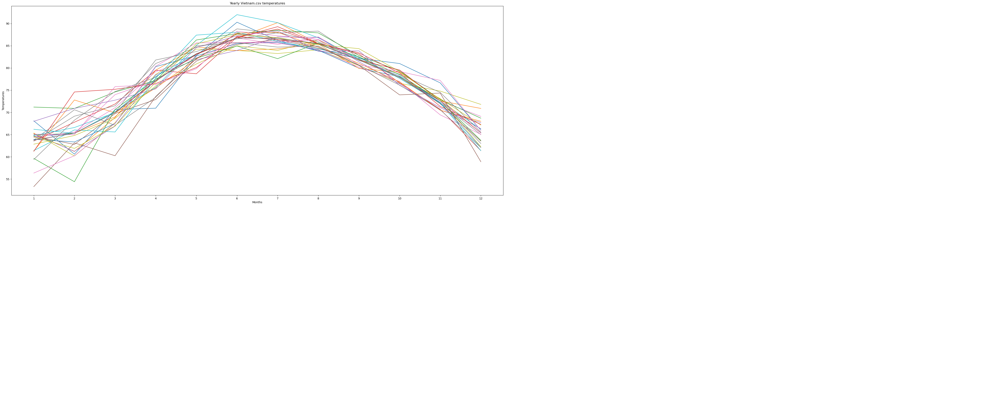

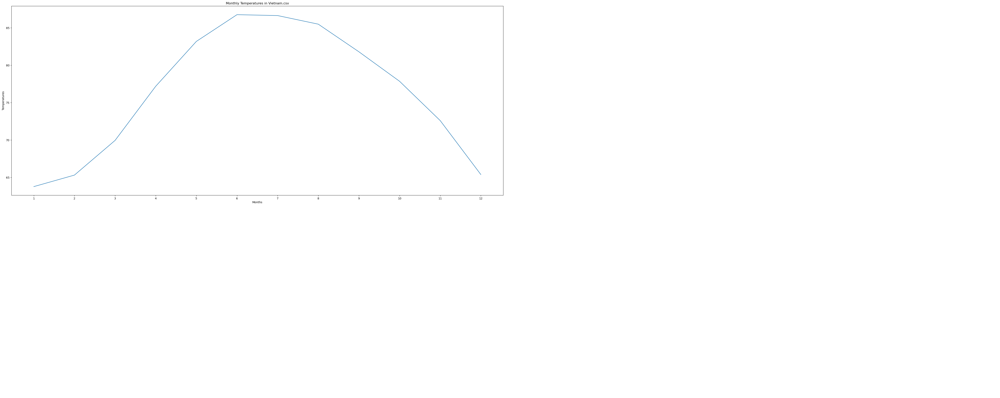

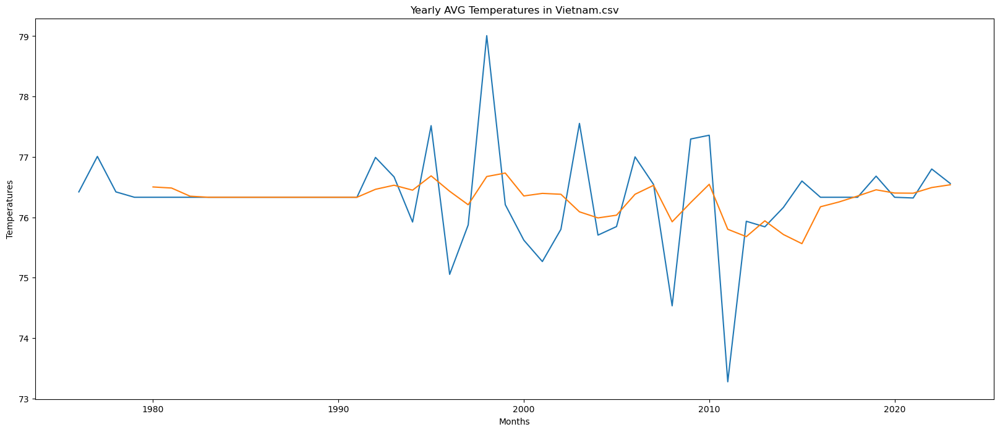

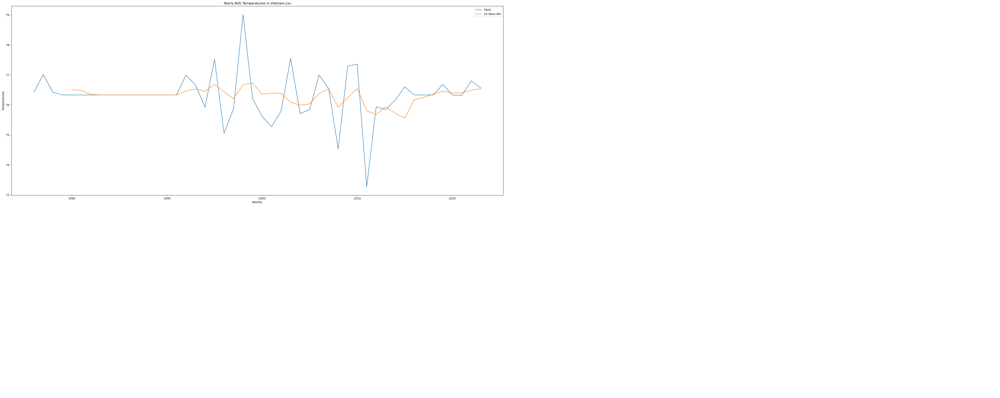

	 Vietnam.csv  data :
              TAVG         NAME
DATE                          
1976-01-01  64.50  Vietnam.csv
1976-02-01  65.31  Vietnam.csv
1976-03-01  69.95  Vietnam.csv
1976-04-01  77.19  Vietnam.csv
1976-05-01  83.19  Vietnam.csv
...           ...          ...
2023-09-01  81.80  Vietnam.csv
2023-10-01  77.86  Vietnam.csv
2023-11-01  72.60  Vietnam.csv
2023-12-01  63.00  Vietnam.csv
2024-01-01  69.40  Vietnam.csv

[577 rows x 2 columns] 




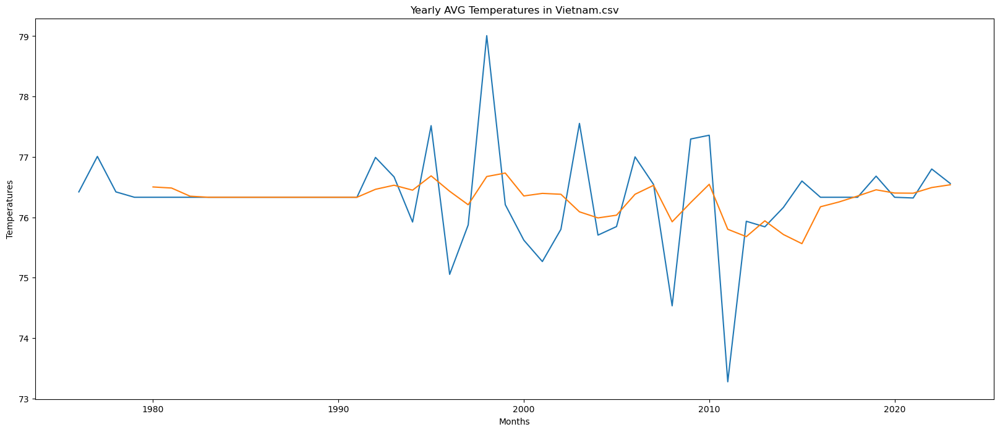

Baseline data in validation DATE
2019-02-01    63.77
2019-03-01    65.31
2019-04-01    69.95
2019-05-01    77.19
2019-06-01    83.05
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 70.4822 celsius degrees 




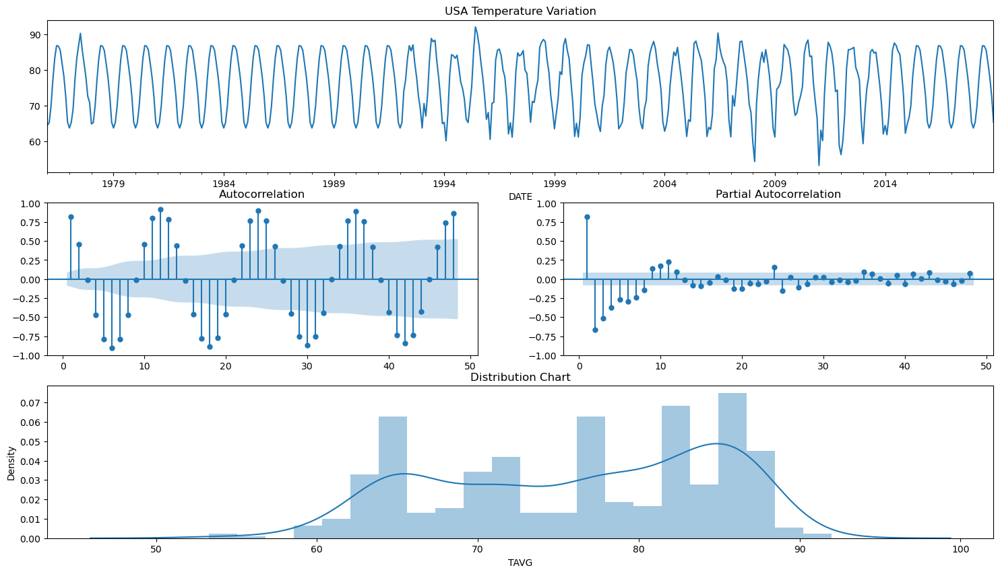


Results of Dickey-Fuller Test:
Test Statistic                  -7.6834
p-value                          0.0000
Lags Used                       19.0000
Number of Observations Used    496.0000
Critical Value (1%)             -3.4436
Critical Value (5%)             -2.8674
Critical Value (10%)            -2.5699
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


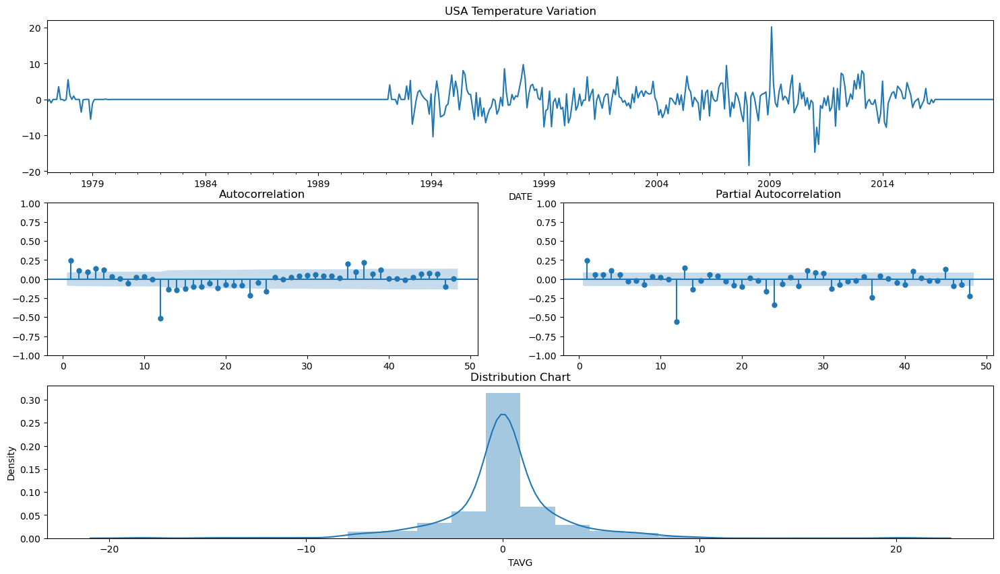


Results of Dickey-Fuller Test:
Test Statistic                  -8.8692
p-value                          0.0000
Lags Used                       13.0000
Number of Observations Used    490.0000
Critical Value (1%)             -3.4438
Critical Value (5%)             -2.8675
Critical Value (10%)            -2.5699
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 1.2525 celsius degrees
It's a decrease of -98.22% in the RMSE
             TAVG         NAME       Pred     Error
DATE                                               
2019-01-01  63.77  Vietnam.csv  63.423692  0.346308
2019-02-01  65.31  Vietnam.csv  65.182430  0.127570
2019-03-01  69.95  Vietnam.csv  69.647201  0.302799
2019-04-01  77.19  Vietnam.csv  76.977897  0.212103
2019-05-01  83.05  Vietnam.csv  83.119297 -0.069297 




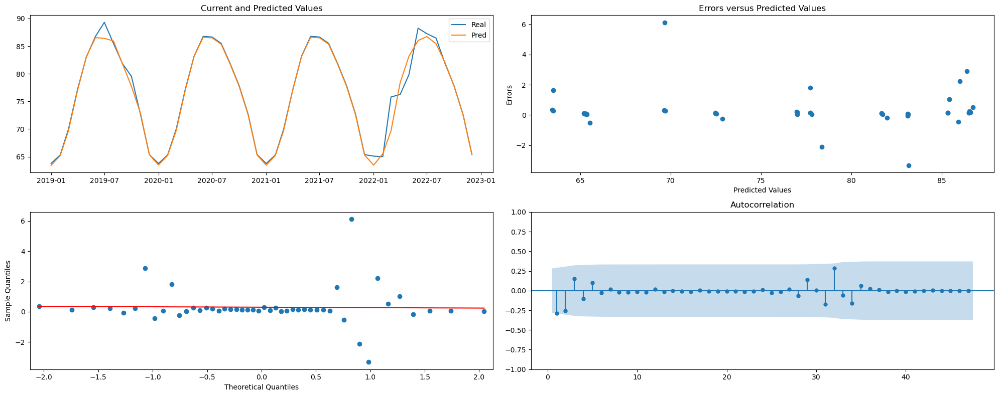

DATE
1976-01-01    64.50
1976-02-01    65.31
1976-03-01    69.95
1976-04-01    77.19
1976-05-01    83.19
Name: TAVG, dtype: float64 




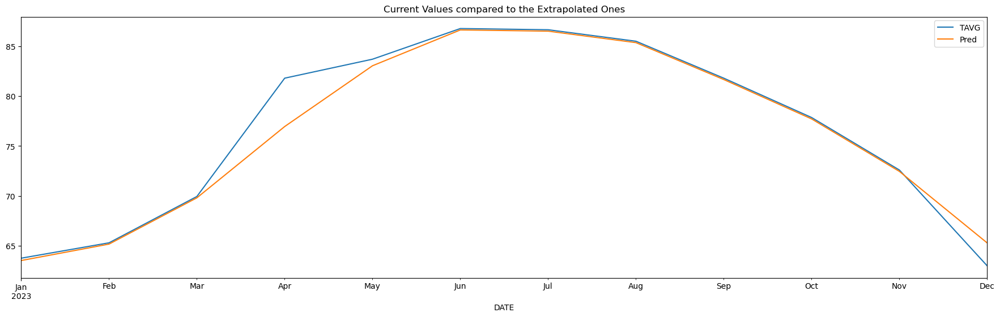

The baseline RMSE for the test baseline was 5.23 celsius degrees
The baseline RMSE for the test extrapolation was 1.56 celsius degrees
That is an improvement of 70.06%
Processing files in folder: Virgin Islands
Reading file: Virgin Islands.csv
       STATION                             NAME        DATE  TAVG
0  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  1974-01-01  78.0
1  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  1974-02-01  77.4
2  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  1974-03-01  77.4
3  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  1974-04-01  79.2
4  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  1974-05-01  81.4

                STATION                             NAME  TAVG
DATE                                                          
1974-01-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  78.0
1974-02-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  77.4
1974-03-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  77.4
1974-04-01  VQW00011624  HENRY E. ROHLSEN AI

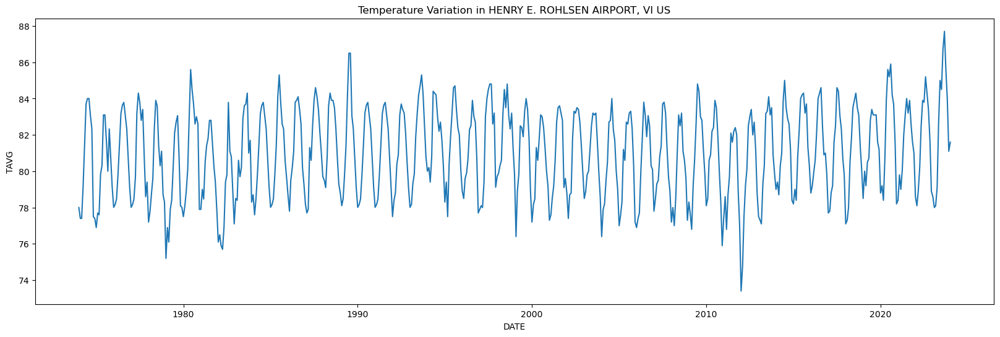

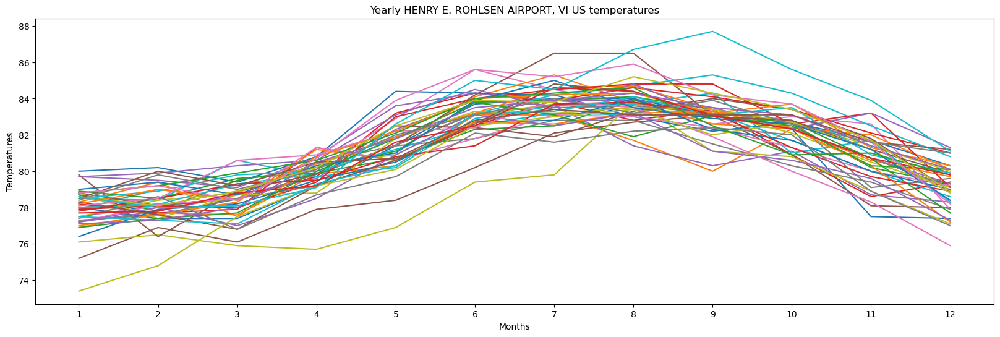

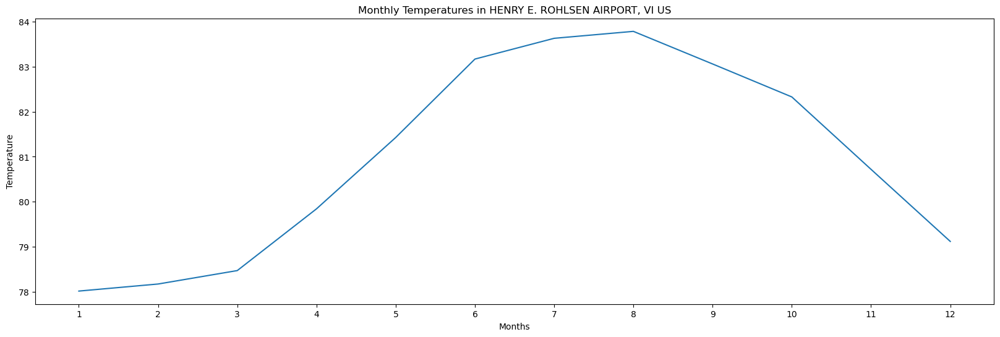

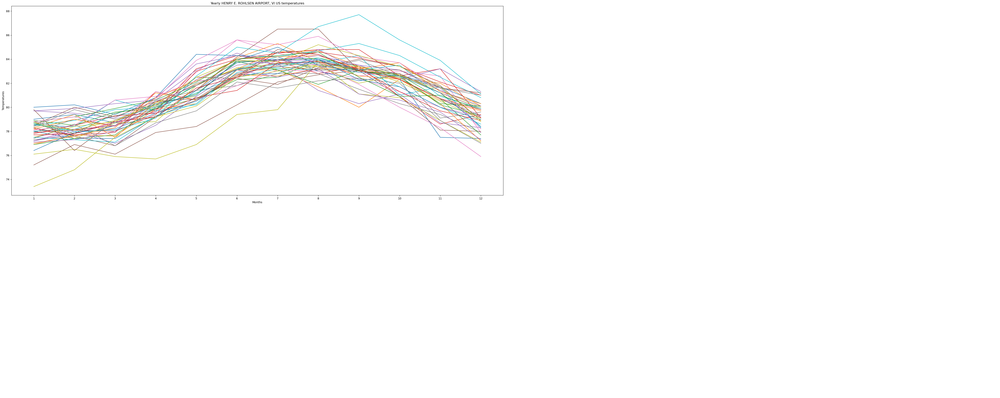

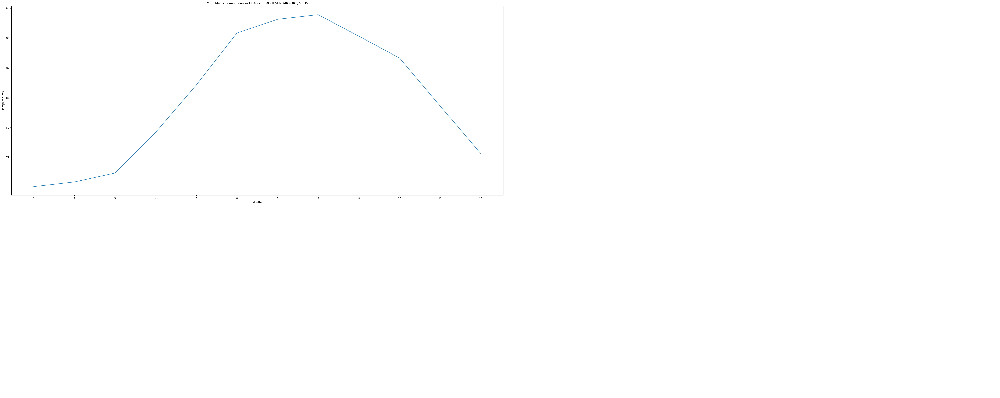

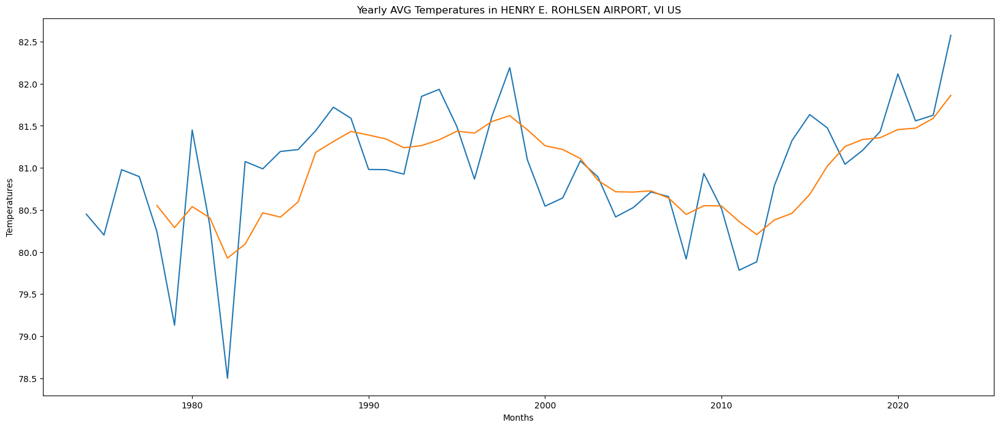

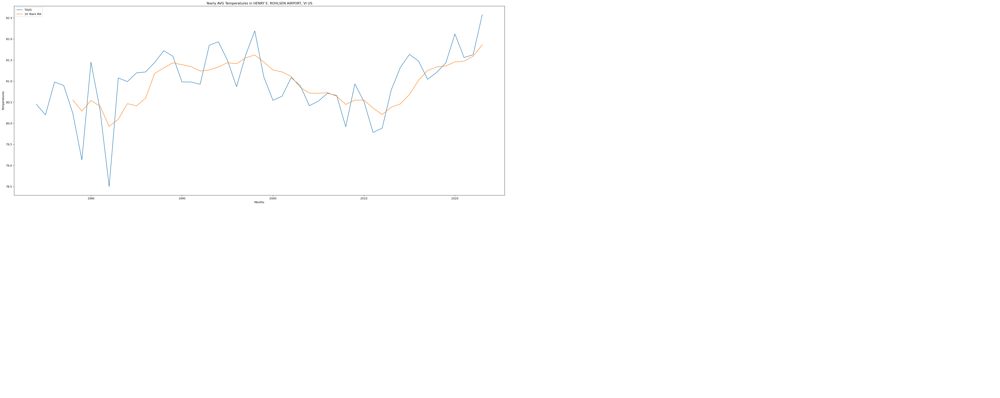

	 HENRY E. ROHLSEN AIRPORT, VI US  data :
                 STATION                             NAME  TAVG
DATE                                                          
1974-01-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  78.0
1974-02-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  77.4
1974-03-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  77.4
1974-04-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  79.2
1974-05-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  81.4
...                 ...                              ...   ...
2023-09-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  87.7
2023-10-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  85.6
2023-11-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  83.9
2023-12-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  81.1
2024-01-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  81.6

[601 rows x 3 columns] 




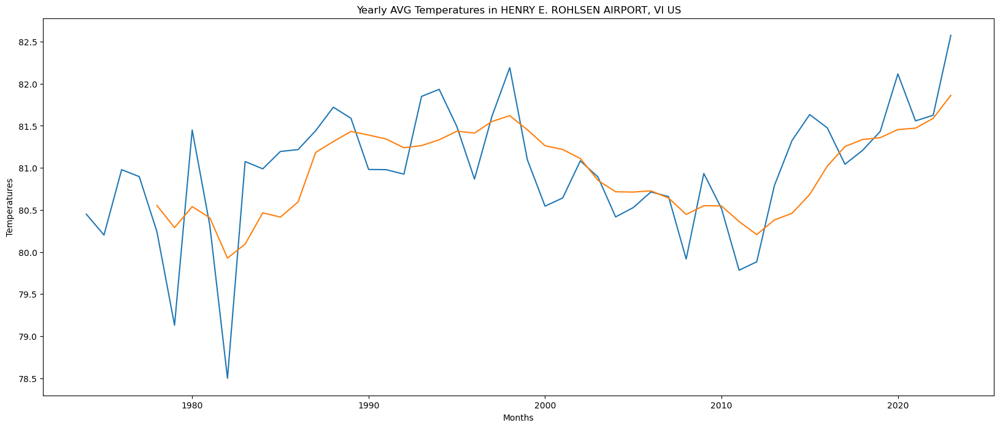

Baseline data in validation DATE
2019-02-01    78.5
2019-03-01    80.0
2019-04-01    79.2
2019-05-01    80.5
2019-06-01    80.7
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 1.4601 celsius degrees 




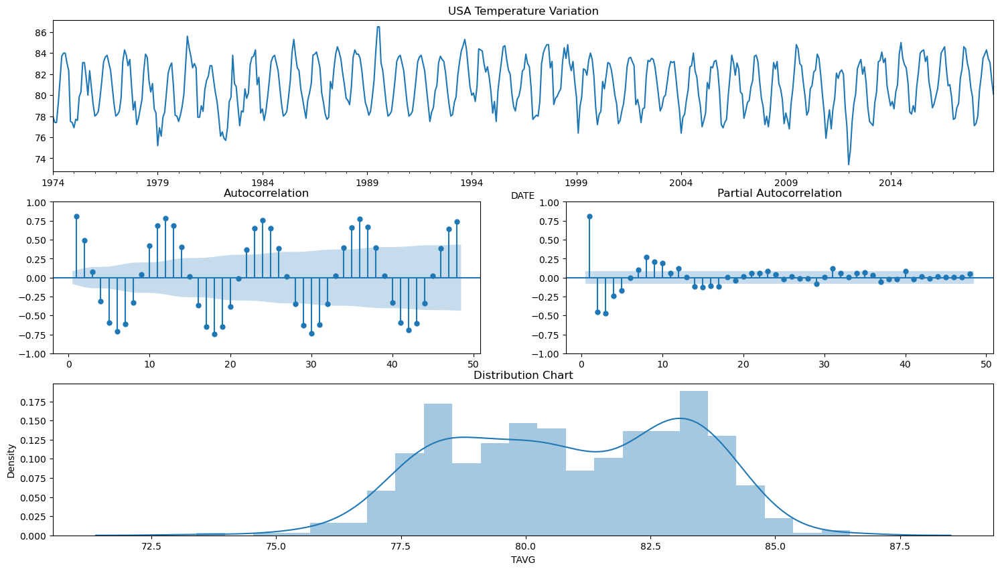


Results of Dickey-Fuller Test:
Test Statistic                  -5.6957
p-value                          0.0000
Lags Used                       16.0000
Number of Observations Used    523.0000
Critical Value (1%)             -3.4429
Critical Value (5%)             -2.8671
Critical Value (10%)            -2.5697
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


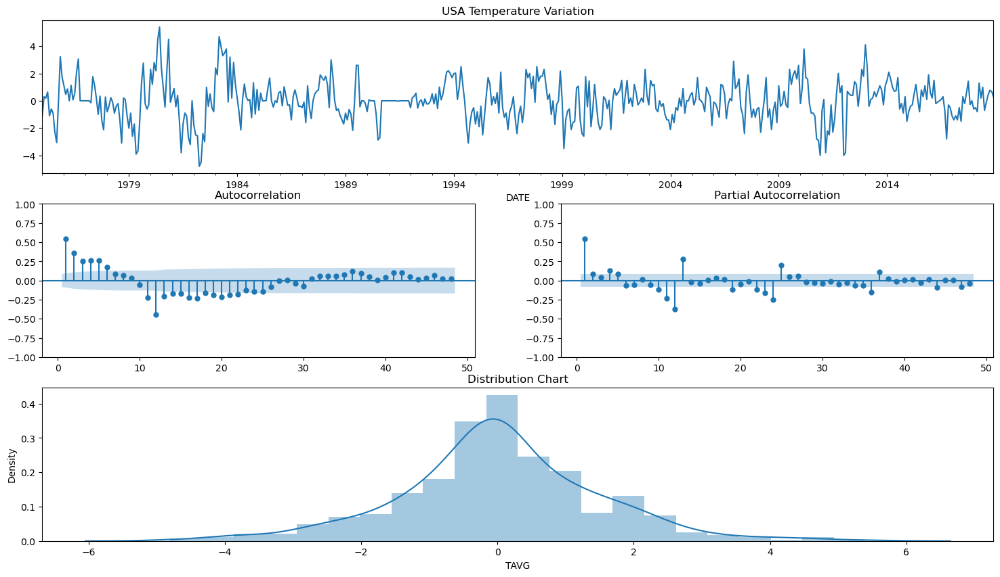


Results of Dickey-Fuller Test:
Test Statistic                  -7.5912
p-value                          0.0000
Lags Used                       12.0000
Number of Observations Used    515.0000
Critical Value (1%)             -3.4431
Critical Value (5%)             -2.8672
Critical Value (10%)            -2.5698
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 0.7838 celsius degrees
It's a decrease of -46.32% in the RMSE
                STATION                             NAME  TAVG       Pred  \
DATE                                                                        
2019-01-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  78.5  78.646172   
2019-02-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  80.0  78.640905   
2019-03-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  79.2  79.599082   
2019-04-01  VQW00011624  HENRY E. ROHLSEN AIRPORT, VI US  80.5  80.540044   


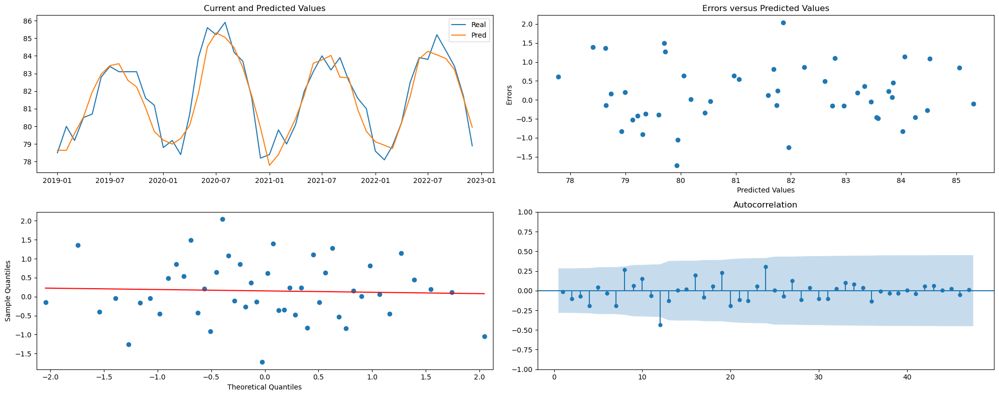

DATE
1974-01-01    78.0
1974-02-01    77.4
1974-03-01    77.4
1974-04-01    79.2
1974-05-01    81.4
Name: TAVG, dtype: float64 




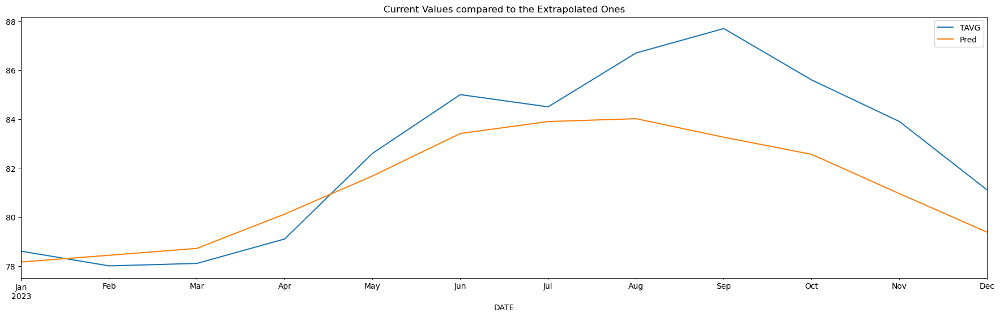

The baseline RMSE for the test baseline was 1.84 celsius degrees
The baseline RMSE for the test extrapolation was 2.11 celsius degrees
That is an improvement of -14.65%
Processing files in folder: Wallis and Futuna
Reading file: Wallis and Futuna.csv
       STATION                   NAME        DATE  TAVG
0  WF000917530  HIHIFO ILE WALLIS, WF  1974-01-01  80.4
1  WF000917530  HIHIFO ILE WALLIS, WF  1974-02-01  80.0
2  WF000917530  HIHIFO ILE WALLIS, WF  1974-03-01  80.5
3  WF000917530  HIHIFO ILE WALLIS, WF  1974-04-01  80.8
4  WF000917530  HIHIFO ILE WALLIS, WF  1974-05-01  79.0

                STATION                   NAME   TAVG
DATE                                                 
1974-01-01  WF000917530  HIHIFO ILE WALLIS, WF  80.40
1974-02-01  WF000917530  HIHIFO ILE WALLIS, WF  80.00
1974-03-01  WF000917530  HIHIFO ILE WALLIS, WF  80.50
1974-04-01  WF000917530  HIHIFO ILE WALLIS, WF  80.80
1974-05-01  WF000917530  HIHIFO ILE WALLIS, WF  79.00
...                 ...           

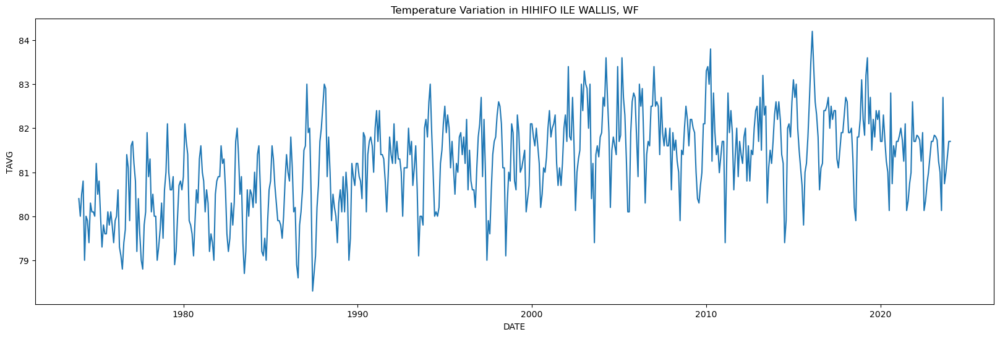

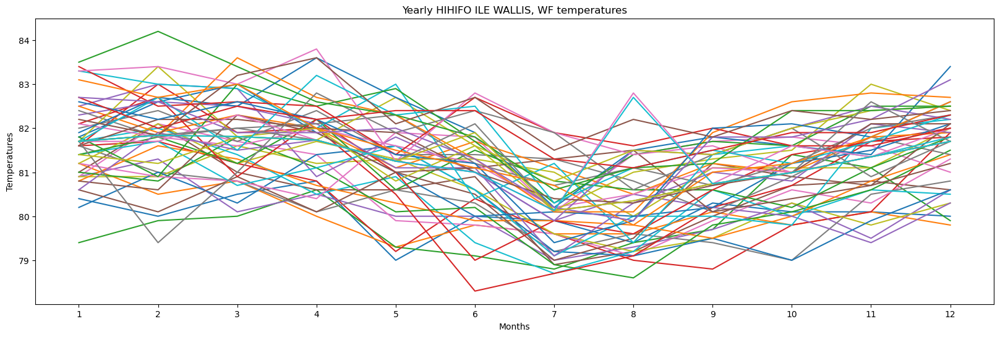

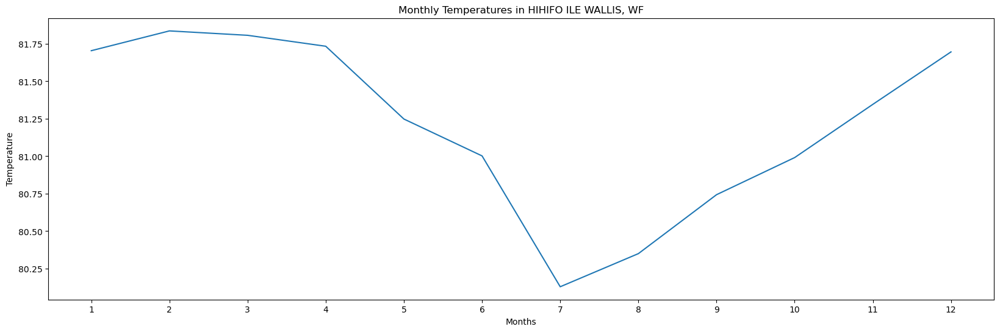

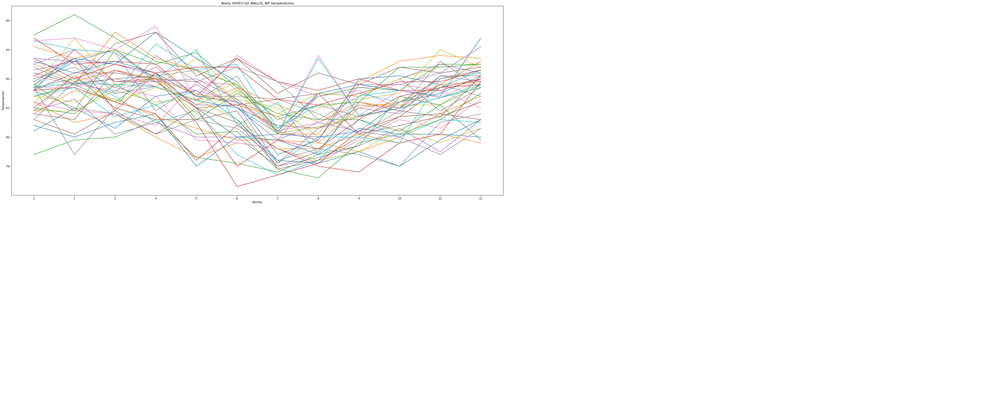

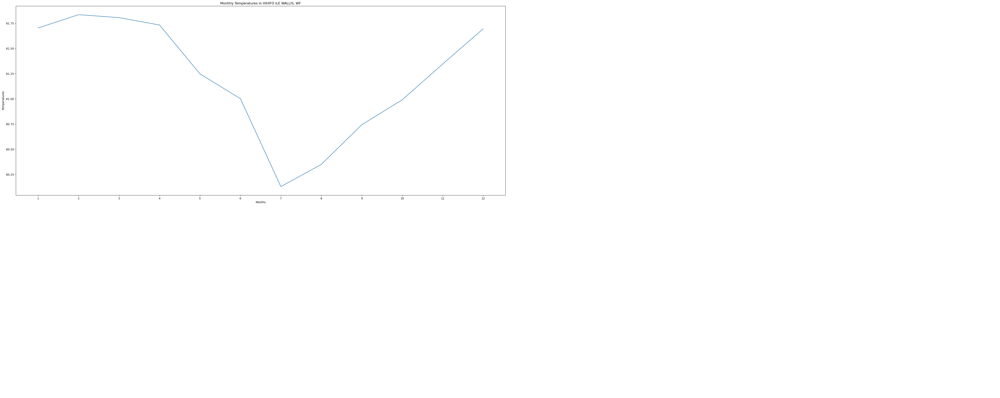

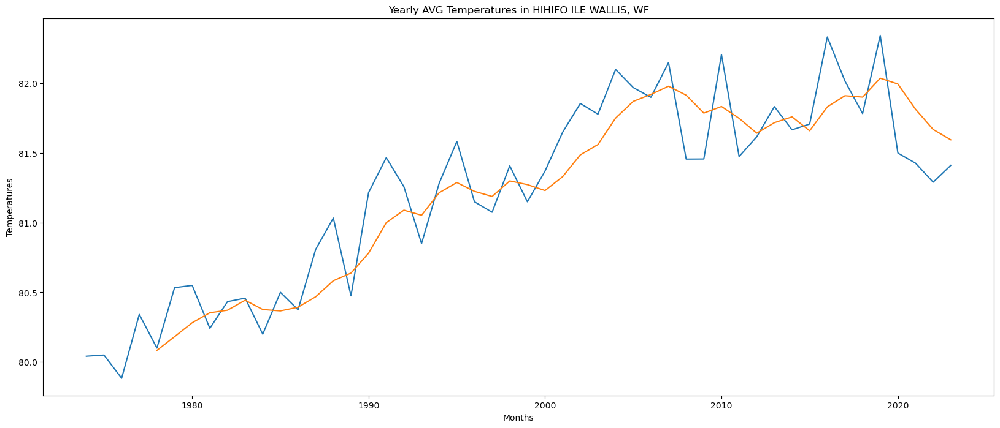

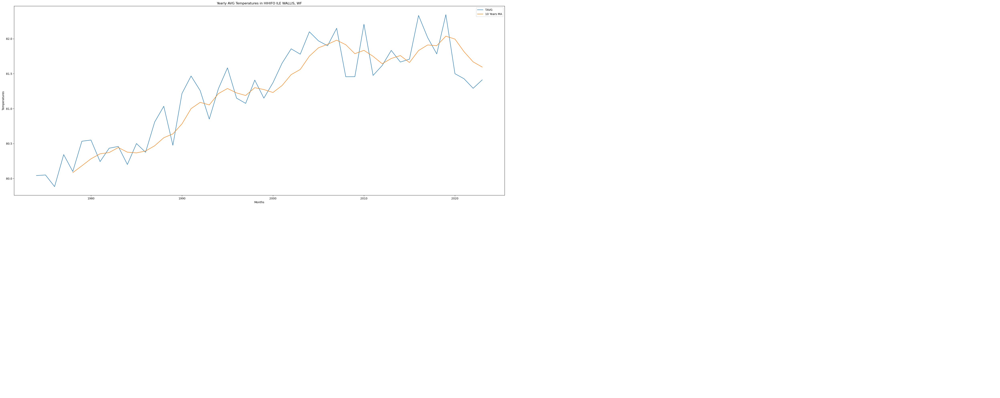

	 HIHIFO ILE WALLIS, WF  data :
                 STATION                   NAME   TAVG
DATE                                                 
1974-01-01  WF000917530  HIHIFO ILE WALLIS, WF  80.40
1974-02-01  WF000917530  HIHIFO ILE WALLIS, WF  80.00
1974-03-01  WF000917530  HIHIFO ILE WALLIS, WF  80.50
1974-04-01  WF000917530  HIHIFO ILE WALLIS, WF  80.80
1974-05-01  WF000917530  HIHIFO ILE WALLIS, WF  79.00
...                 ...                    ...    ...
2023-09-01  WF000917530  HIHIFO ILE WALLIS, WF  80.74
2023-10-01  WF000917530  HIHIFO ILE WALLIS, WF  80.99
2023-11-01  WF000917530  HIHIFO ILE WALLIS, WF  81.35
2023-12-01  WF000917530  HIHIFO ILE WALLIS, WF  81.70
2024-01-01  WF000917530  HIHIFO ILE WALLIS, WF  81.70

[601 rows x 3 columns] 




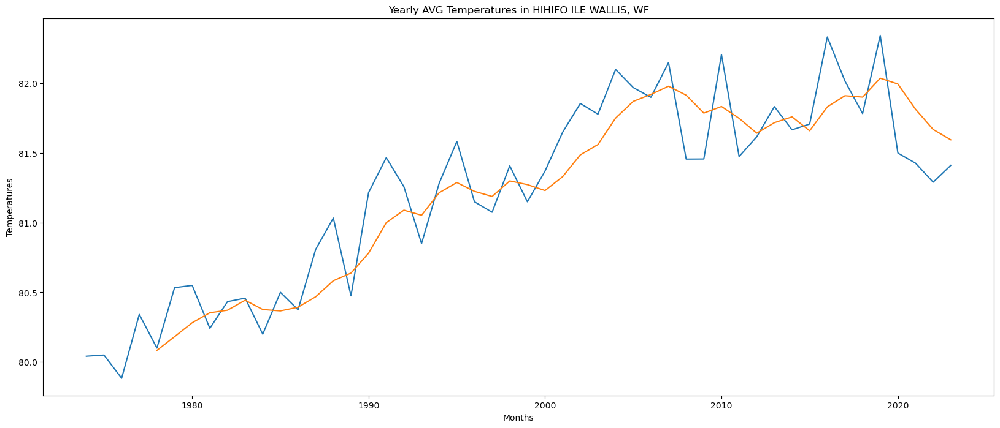

Baseline data in validation DATE
2019-02-01    82.20
2019-03-01    81.84
2019-04-01    83.20
2019-05-01    83.60
2019-06-01    82.10
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 0.8598 celsius degrees 




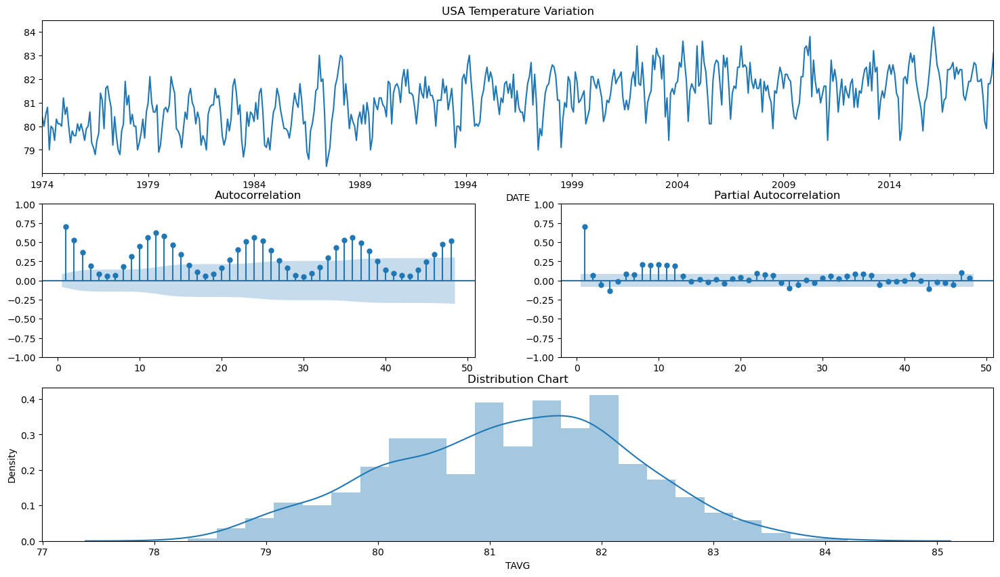


Results of Dickey-Fuller Test:
Test Statistic                  -2.0002
p-value                          0.2865
Lags Used                       12.0000
Number of Observations Used    527.0000
Critical Value (1%)             -3.4428
Critical Value (5%)             -2.8670
Critical Value (10%)            -2.5697
dtype: float64

The Test Statistics is higher than the Critical Value of 5%.
The serie isn't stationary


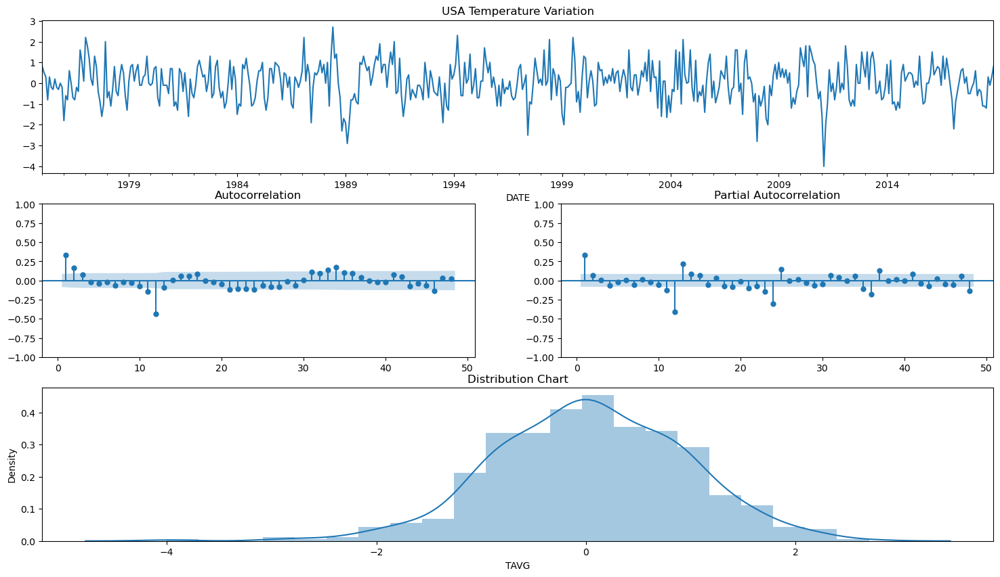


Results of Dickey-Fuller Test:
Test Statistic                  -6.5922
p-value                          0.0000
Lags Used                       18.0000
Number of Observations Used    509.0000
Critical Value (1%)             -3.4433
Critical Value (5%)             -2.8672
Critical Value (10%)            -2.5698
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 0.7008 celsius degrees
It's a decrease of -18.49% in the RMSE
                STATION                   NAME   TAVG       Pred     Error
DATE                                                                      
2019-01-01  WF000917530  HIHIFO ILE WALLIS, WF  82.20  82.900743 -0.700743
2019-02-01  WF000917530  HIHIFO ILE WALLIS, WF  81.84  82.742304 -0.902304
2019-03-01  WF000917530  HIHIFO ILE WALLIS, WF  83.20  82.447825  0.752175
2019-04-01  WF000917530  HIHIFO ILE WALLIS, WF  83.60  82.807727  0.792273
2019-05-01  

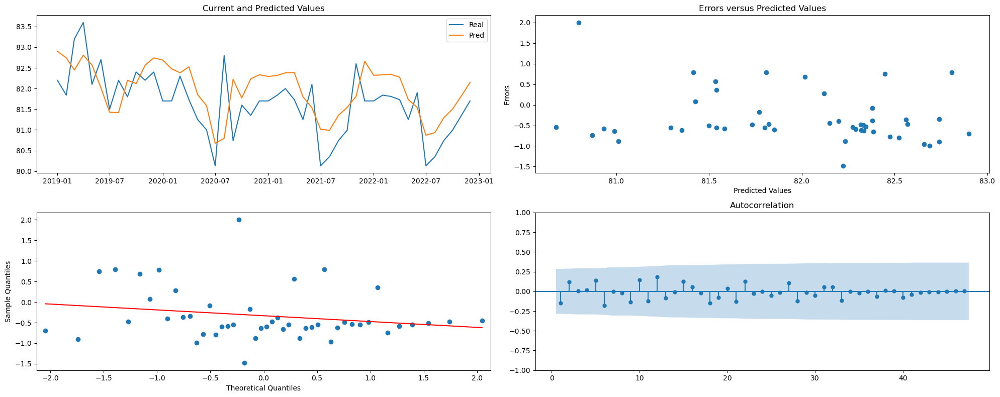

DATE
1974-01-01    80.4
1974-02-01    80.0
1974-03-01    80.5
1974-04-01    80.8
1974-05-01    79.0
Name: TAVG, dtype: float64 




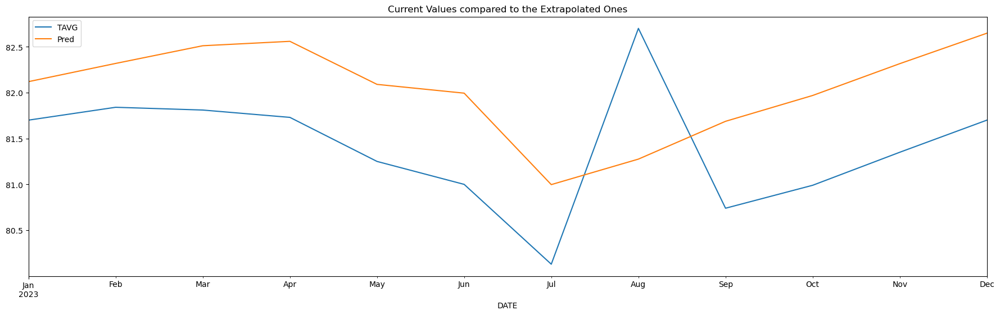

The baseline RMSE for the test baseline was 0.99 celsius degrees
The baseline RMSE for the test extrapolation was 0.9 celsius degrees
That is an improvement of 9.28%
Processing files in folder: West Bank
Reading file: West Bank.csv
         DATE   TAVG
0  1974-01-01  43.20
1  1974-02-01  52.85
2  1974-03-01  55.70
3  1974-04-01  60.50
4  1974-05-01  67.10

             TAVG
DATE             
1974-01-01  43.20
1974-02-01  52.85
1974-03-01  55.70
1974-04-01  60.50
1974-05-01  67.10
...           ...
2022-04-01  64.62
2022-05-01  70.80
2022-06-01  75.07
2022-07-01  77.78
2022-08-01  78.31

[584 rows x 1 columns]

Index(['TAVG'], dtype='object')
West Bank.csv
             TAVG           NAME
DATE                            
1974-01-01  43.20  West Bank.csv
1974-02-01  52.85  West Bank.csv
1974-03-01  55.70  West Bank.csv
1974-04-01  60.50  West Bank.csv
1974-05-01  67.10  West Bank.csv
...           ...            ...
2022-04-01  64.62  West Bank.csv
2022-05-01  70.80  West Bank.csv
2022-0

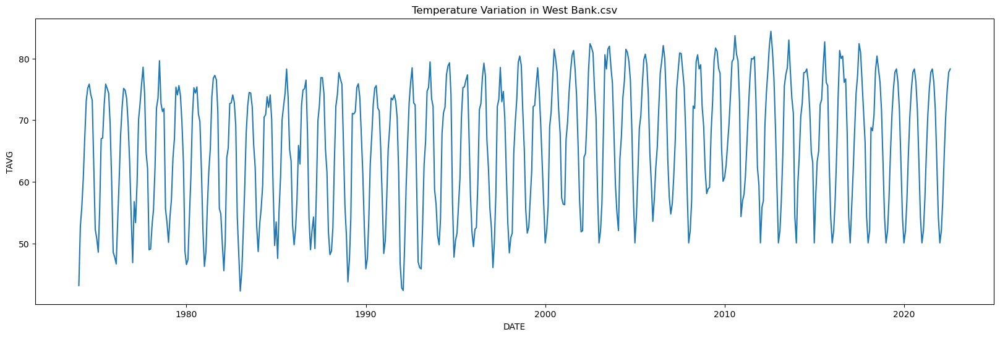

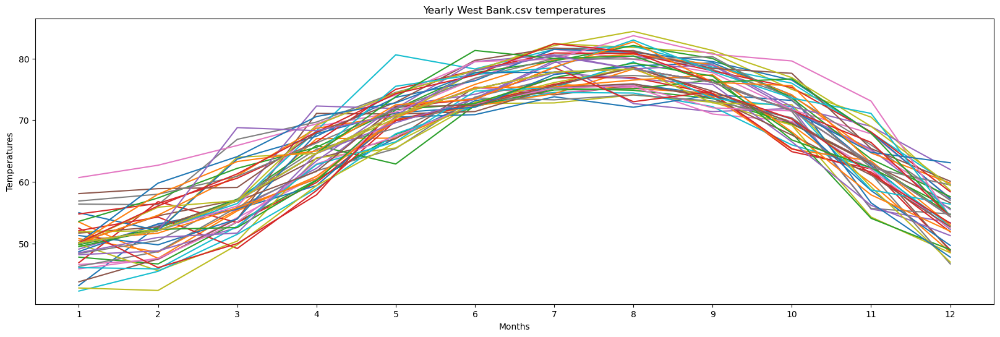

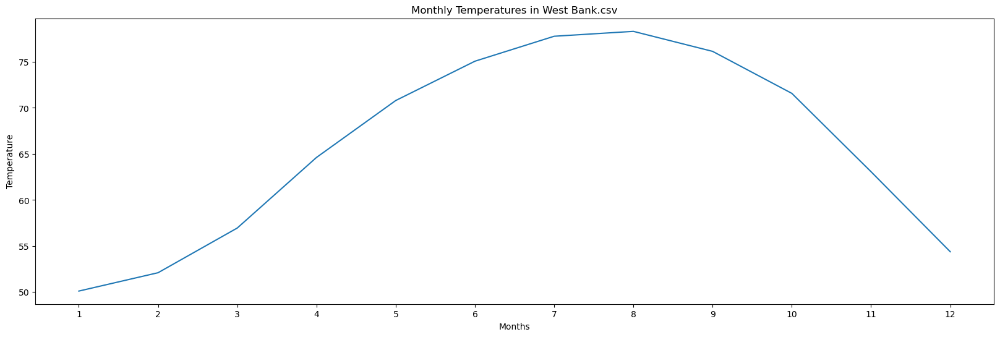

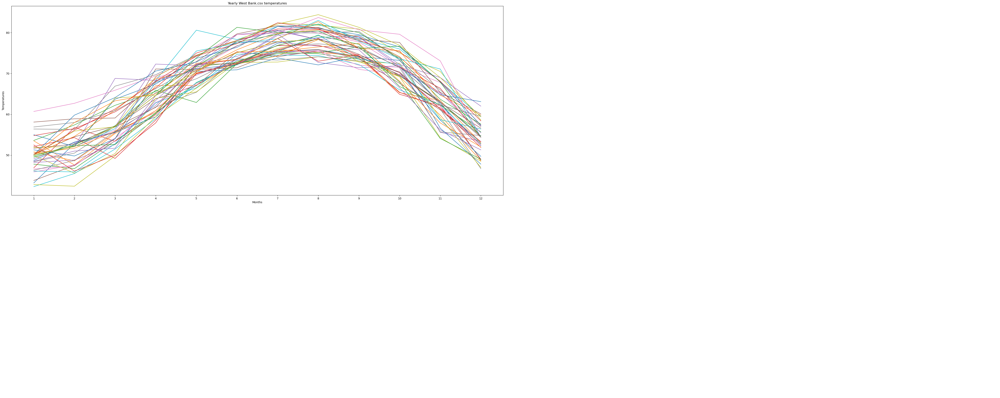

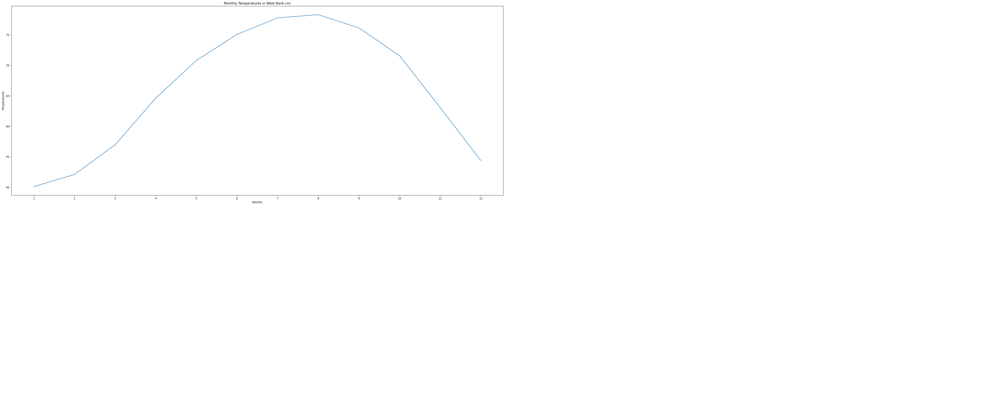

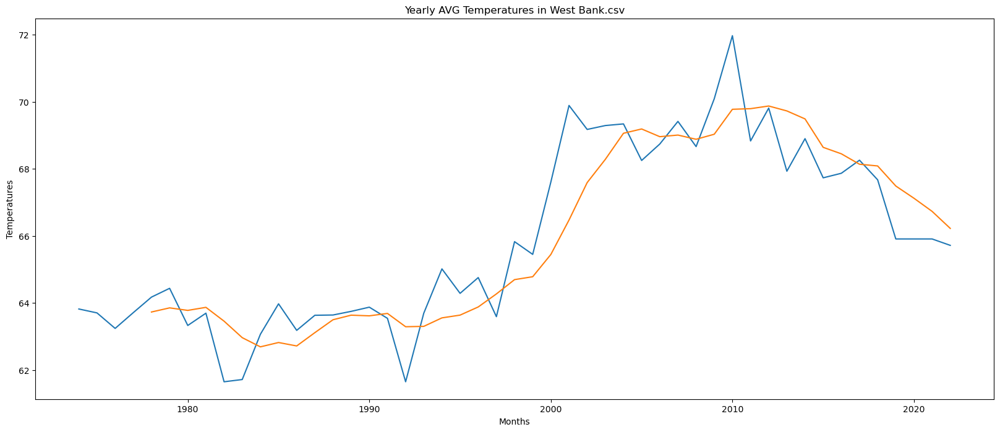

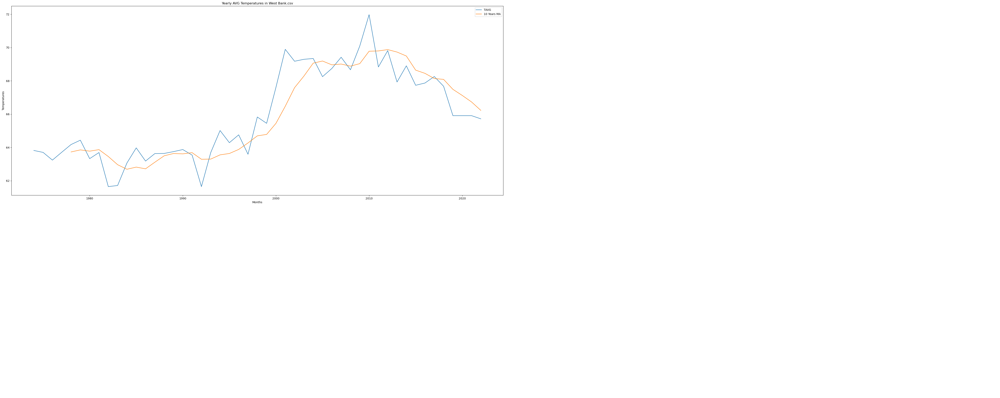

	 West Bank.csv  data :
              TAVG           NAME
DATE                            
1974-01-01  43.20  West Bank.csv
1974-02-01  52.85  West Bank.csv
1974-03-01  55.70  West Bank.csv
1974-04-01  60.50  West Bank.csv
1974-05-01  67.10  West Bank.csv
...           ...            ...
2022-04-01  64.62  West Bank.csv
2022-05-01  70.80  West Bank.csv
2022-06-01  75.07  West Bank.csv
2022-07-01  77.78  West Bank.csv
2022-08-01  78.31  West Bank.csv

[584 rows x 2 columns] 




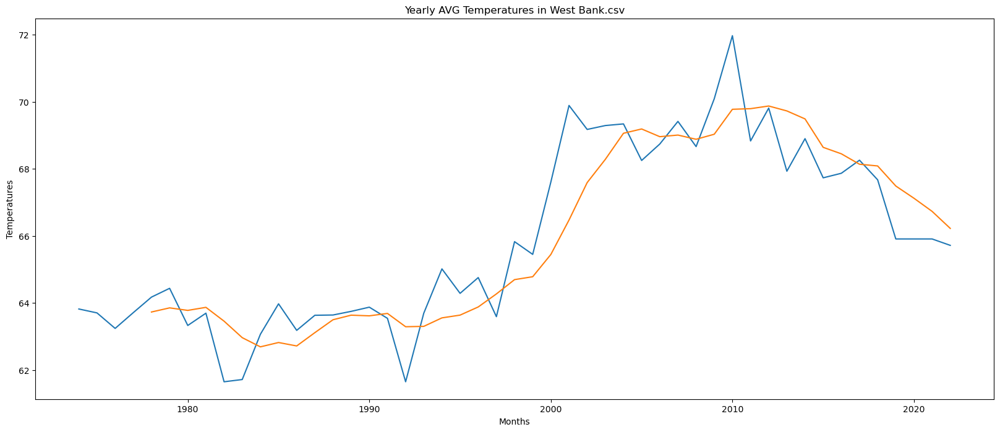

Baseline data in validation DATE
2017-10-01    76.14
2017-11-01    71.58
2017-12-01    66.40
2018-01-01    54.38
2018-02-01    50.11
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 60.2402 celsius degrees 




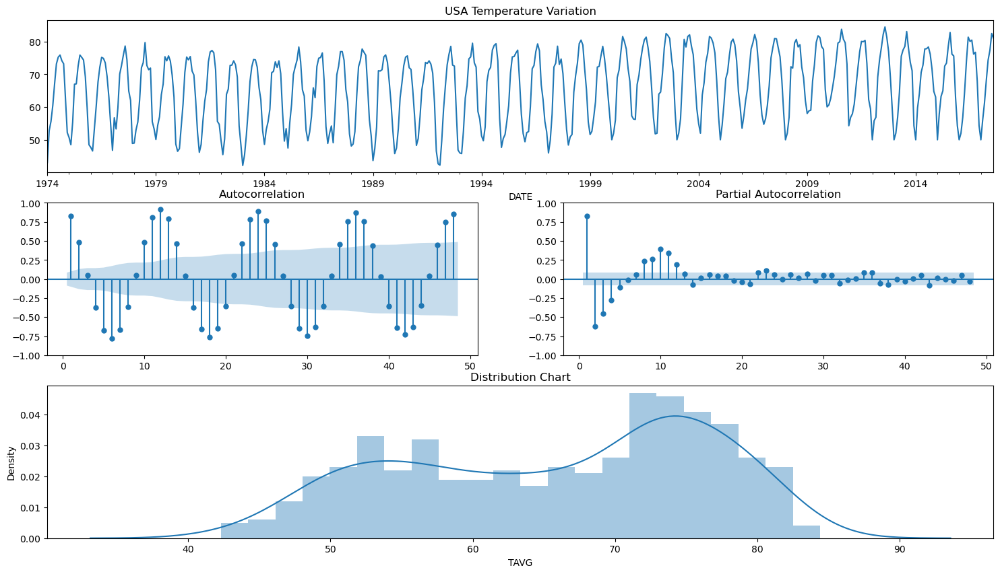


Results of Dickey-Fuller Test:
Test Statistic                  -1.4423
p-value                          0.5619
Lags Used                       13.0000
Number of Observations Used    510.0000
Critical Value (1%)             -3.4432
Critical Value (5%)             -2.8672
Critical Value (10%)            -2.5698
dtype: float64

The Test Statistics is higher than the Critical Value of 5%.
The serie isn't stationary


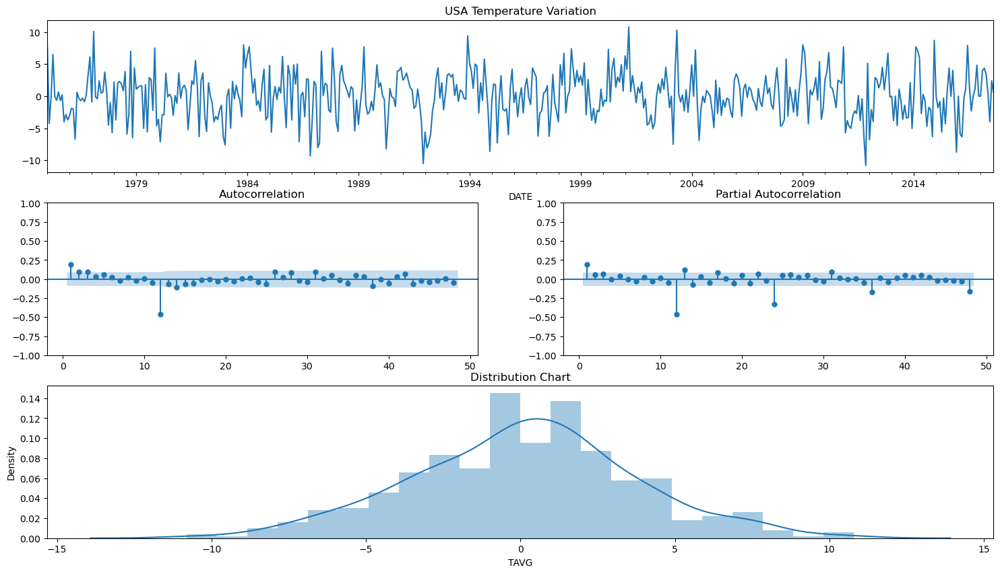


Results of Dickey-Fuller Test:
Test Statistic                  -8.3669
p-value                          0.0000
Lags Used                       13.0000
Number of Observations Used    498.0000
Critical Value (1%)             -3.4435
Critical Value (5%)             -2.8674
Critical Value (10%)            -2.5699
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 2.405 celsius degrees
It's a decrease of -96.01% in the RMSE
             TAVG           NAME       Pred     Error
DATE                                                 
2017-09-01  76.14  West Bank.csv  79.590005 -3.450005
2017-10-01  71.58  West Bank.csv  74.446196 -2.866196
2017-11-01  66.40  West Bank.csv  65.313989  1.086011
2017-12-01  54.38  West Bank.csv  57.338768 -2.958768
2018-01-01  50.11  West Bank.csv  52.273452 -2.163452 




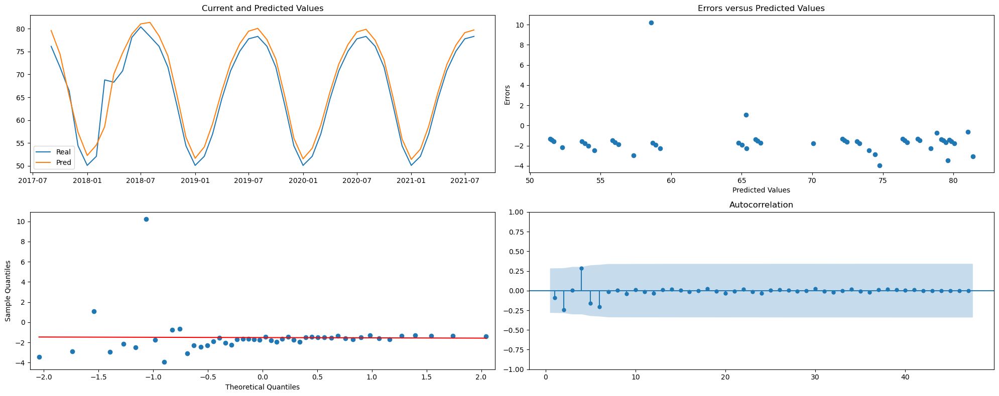

DATE
1974-01-01    43.20
1974-02-01    52.85
1974-03-01    55.70
1974-04-01    60.50
1974-05-01    67.10
Name: TAVG, dtype: float64 




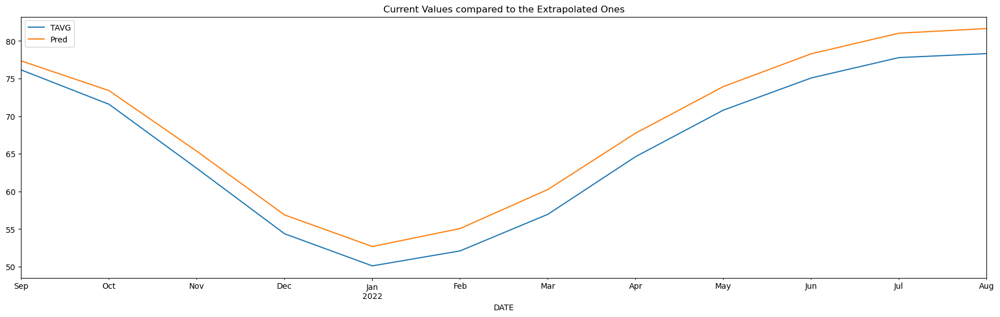

The baseline RMSE for the test baseline was 5.3 celsius degrees
The baseline RMSE for the test extrapolation was 2.8 celsius degrees
That is an improvement of 47.21%
Processing files in folder: Western Sahara
Reading file: Western Sahara.csv
       STATION                          NAME        DATE  TAVG
0  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  1974-01-01  62.6
1  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  1974-02-01  63.3
2  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  1974-03-01  62.7
3  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  1974-04-01  63.0
4  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  1974-05-01  66.6

                STATION                          NAME   TAVG
DATE                                                        
1974-01-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  62.60
1974-02-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  63.30
1974-03-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  62.70
1974-04-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  63.00
1974-05-01  S

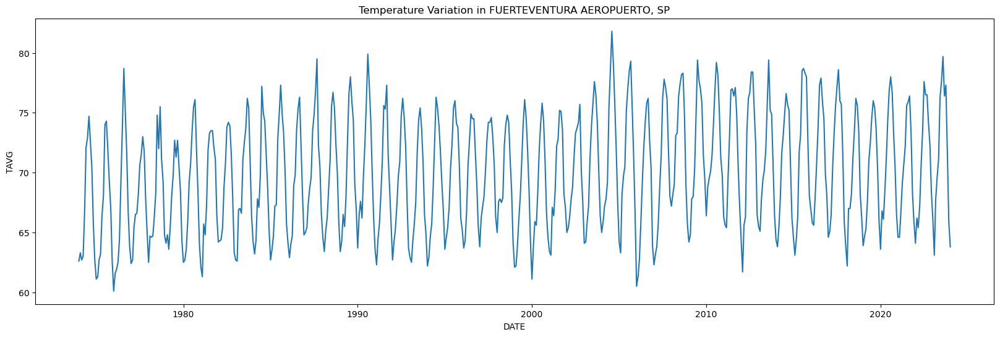

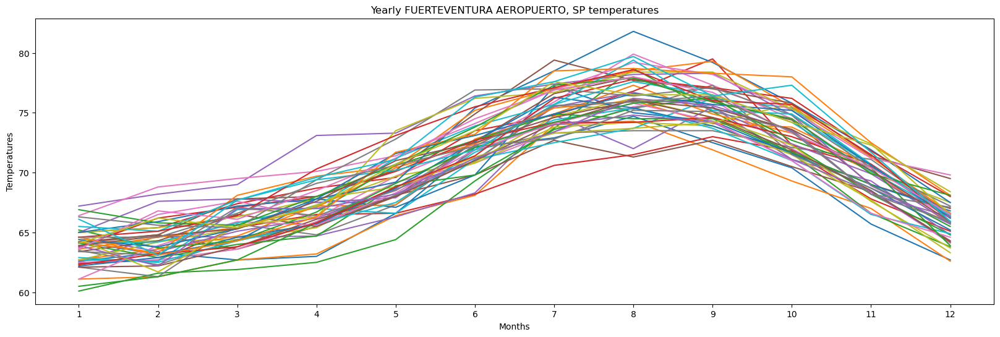

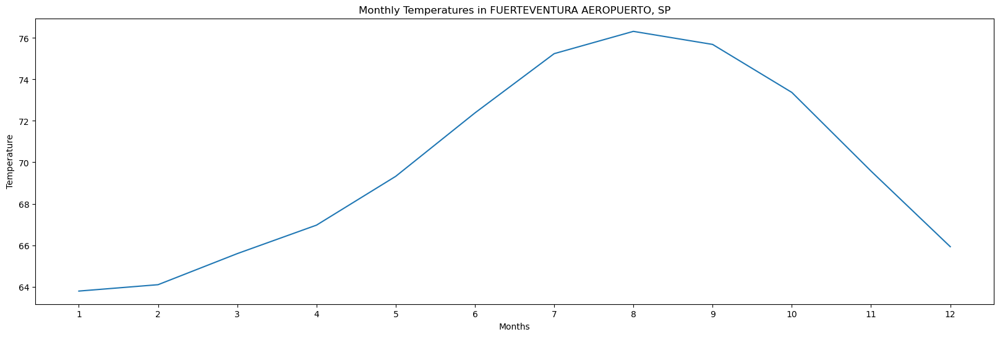

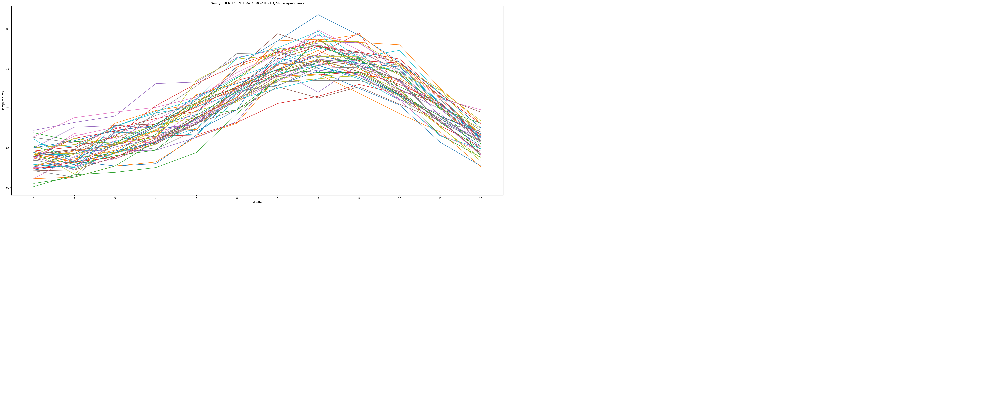

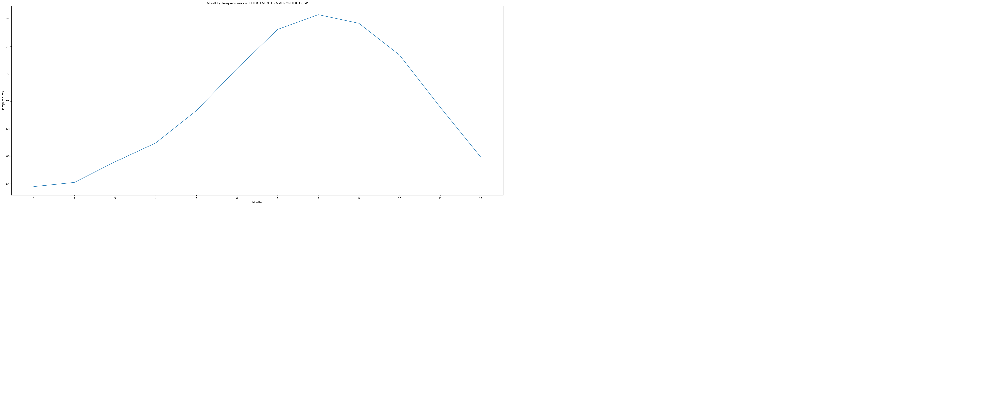

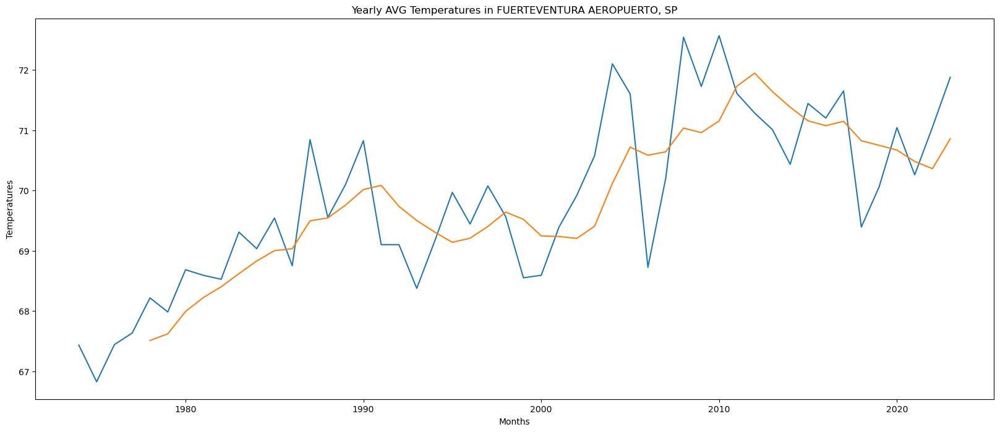

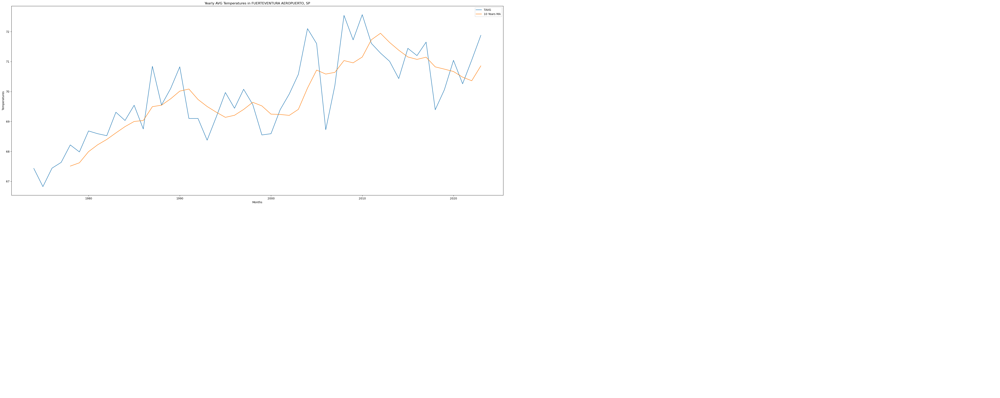

	 FUERTEVENTURA AEROPUERTO, SP  data :
                 STATION                          NAME   TAVG
DATE                                                        
1974-01-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  62.60
1974-02-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  63.30
1974-03-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  62.70
1974-04-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  63.00
1974-05-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  66.60
...                 ...                           ...    ...
2023-09-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  76.40
2023-10-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  77.30
2023-11-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  71.70
2023-12-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  65.93
2024-01-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  63.79

[601 rows x 3 columns] 




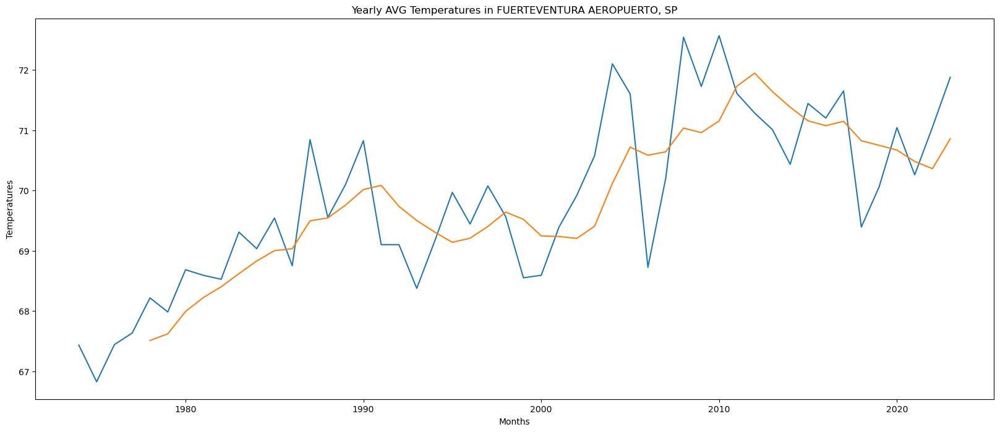

Baseline data in validation DATE
2019-02-01    63.9
2019-03-01    64.7
2019-04-01    65.3
2019-05-01    67.6
2019-06-01    71.0
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 2.4821 celsius degrees 




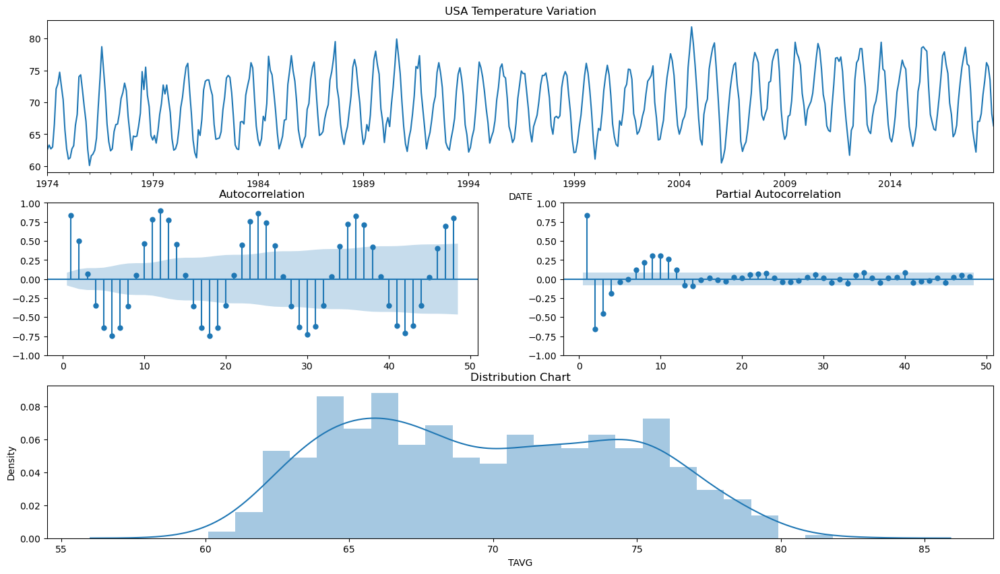


Results of Dickey-Fuller Test:
Test Statistic                  -3.1192
p-value                          0.0252
Lags Used                       14.0000
Number of Observations Used    525.0000
Critical Value (1%)             -3.4429
Critical Value (5%)             -2.8671
Critical Value (10%)            -2.5697
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


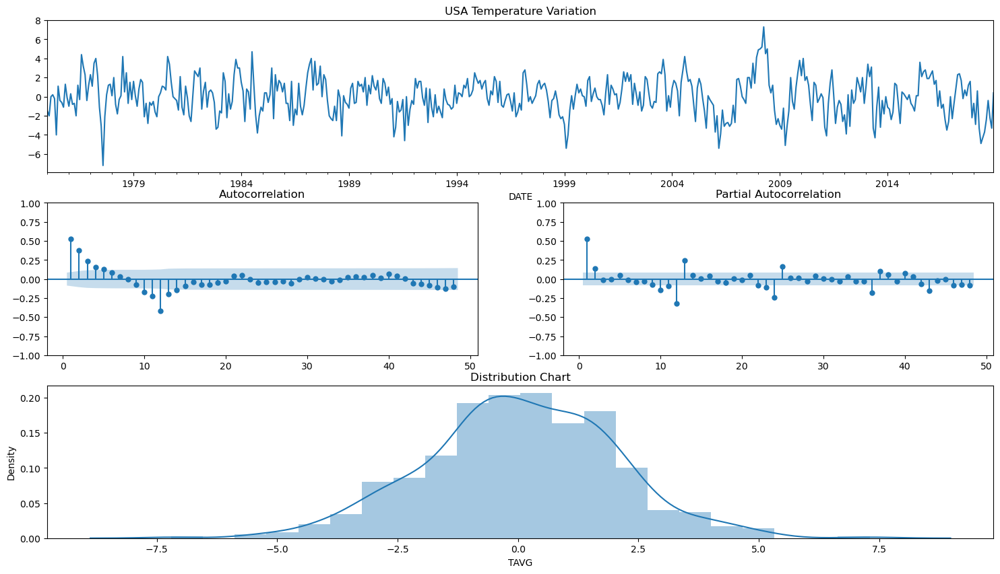


Results of Dickey-Fuller Test:
Test Statistic                  -7.5164
p-value                          0.0000
Lags Used                       12.0000
Number of Observations Used    515.0000
Critical Value (1%)             -3.4431
Critical Value (5%)             -2.8672
Critical Value (10%)            -2.5698
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 0.9895 celsius degrees
It's a decrease of -60.13% in the RMSE
                STATION                          NAME  TAVG       Pred  \
DATE                                                                     
2019-01-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  63.9  64.299480   
2019-02-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  64.7  64.445897   
2019-03-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  65.3  66.554233   
2019-04-01  SPE00120197  FUERTEVENTURA AEROPUERTO, SP  67.6  67.718130   
2019-05-01  SPE001

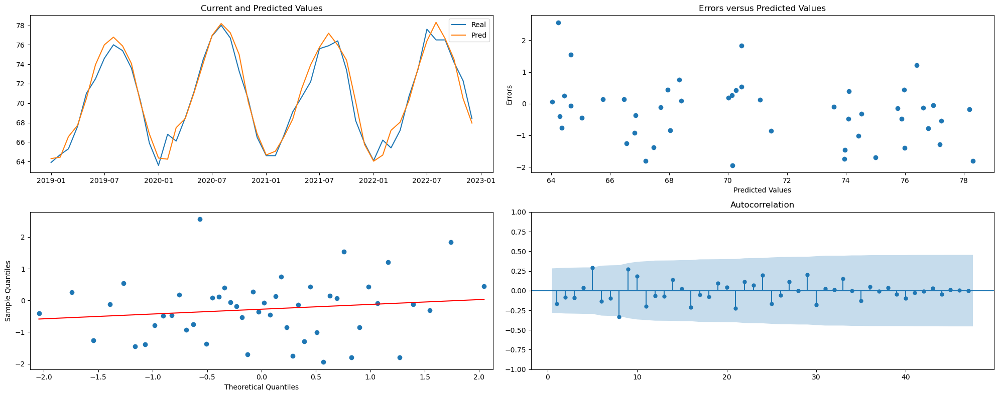

DATE
1974-01-01    62.6
1974-02-01    63.3
1974-03-01    62.7
1974-04-01    63.0
1974-05-01    66.6
Name: TAVG, dtype: float64 




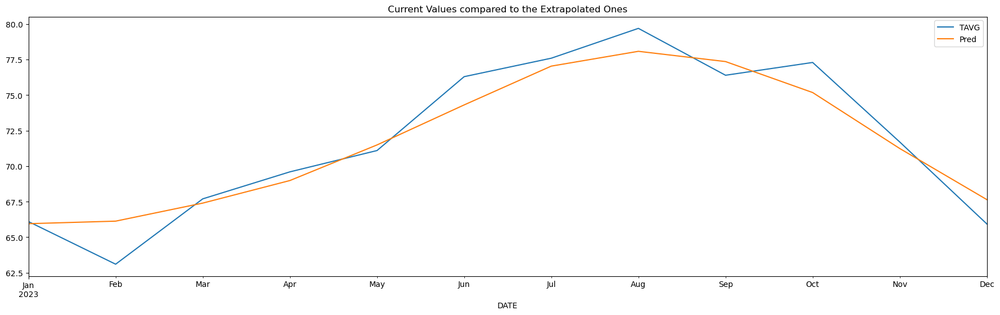

The baseline RMSE for the test baseline was 3.48 celsius degrees
The baseline RMSE for the test extrapolation was 1.45 celsius degrees
That is an improvement of 58.34%
Processing files in folder: Yemen
Reading file: Yemen.csv
       STATION          NAME        DATE  TAVG
0  SAM00041136  SHARURAH, SA  1985-02-01  62.7
1  SAM00041136  SHARURAH, SA  1985-03-01  79.1
2  SAM00041136  SHARURAH, SA  1985-04-01  83.5
3  SAM00041136  SHARURAH, SA  1985-05-01  88.3
4  SAM00041136  SHARURAH, SA  1985-06-01  89.0

                STATION          NAME   TAVG
DATE                                        
1985-02-01  SAM00041136  SHARURAH, SA  62.70
1985-03-01  SAM00041136  SHARURAH, SA  79.10
1985-04-01  SAM00041136  SHARURAH, SA  83.50
1985-05-01  SAM00041136  SHARURAH, SA  88.30
1985-06-01  SAM00041136  SHARURAH, SA  89.00
...                 ...           ...    ...
2023-08-01  SAM00041136  SHARURAH, SA  98.10
2023-09-01  SAM00041136  SHARURAH, SA  89.84
2023-10-01  SAM00041136  SHARURAH, SA  86

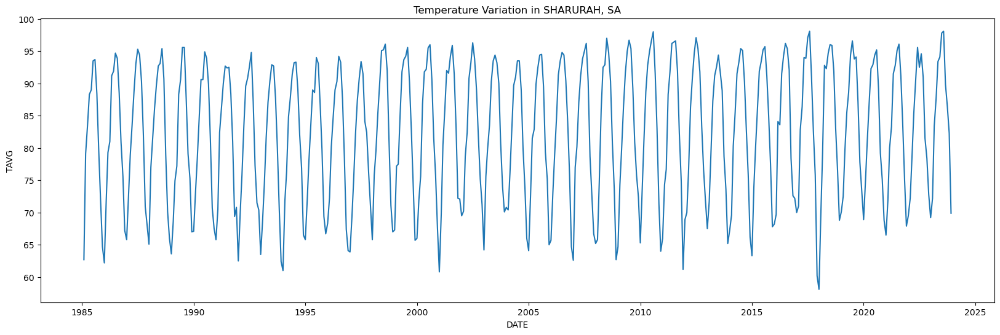

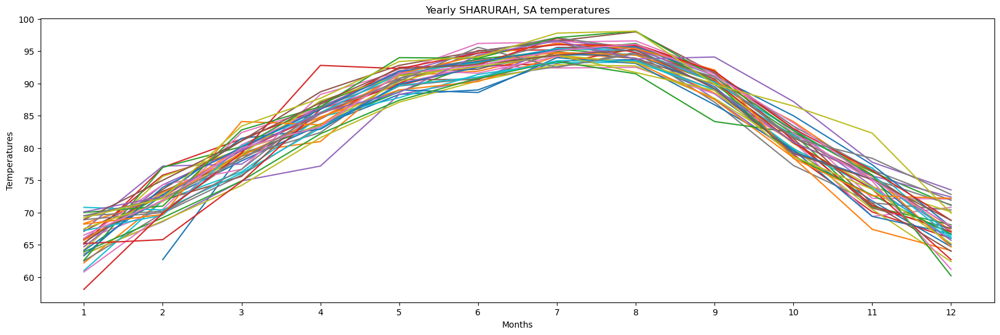

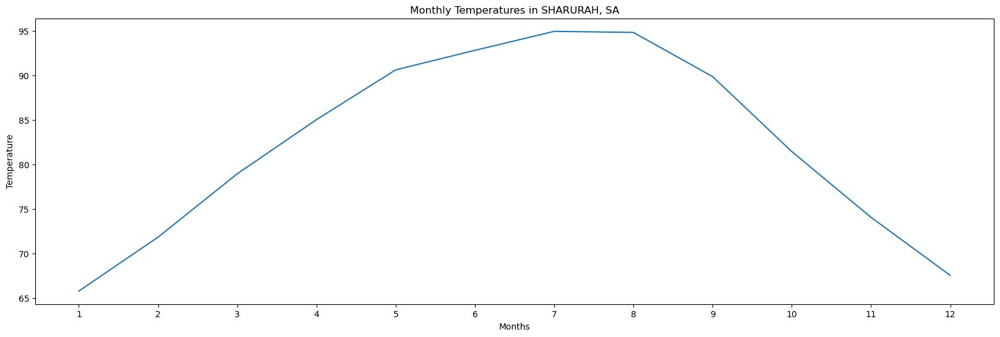

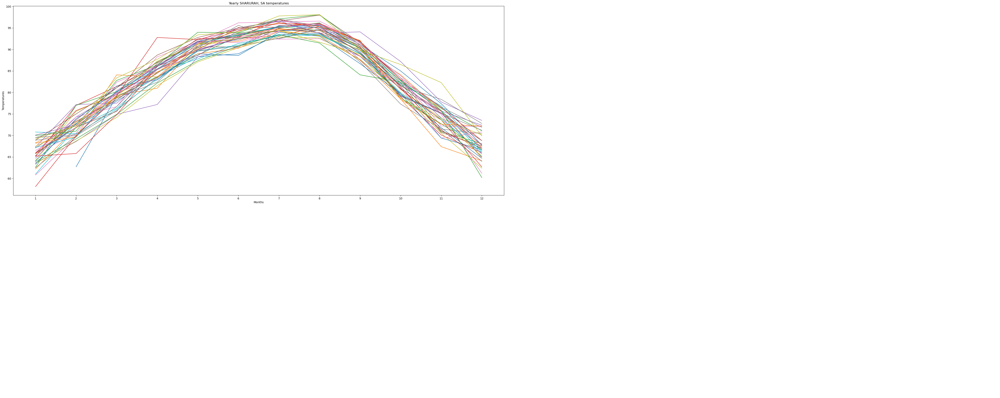

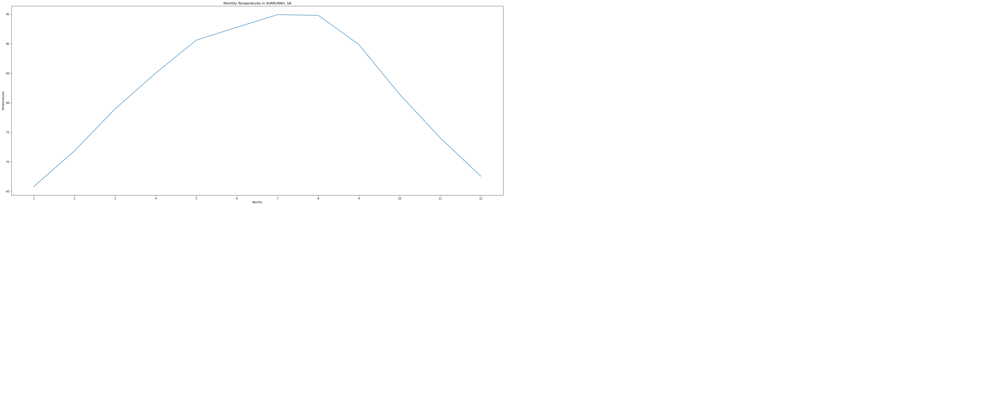

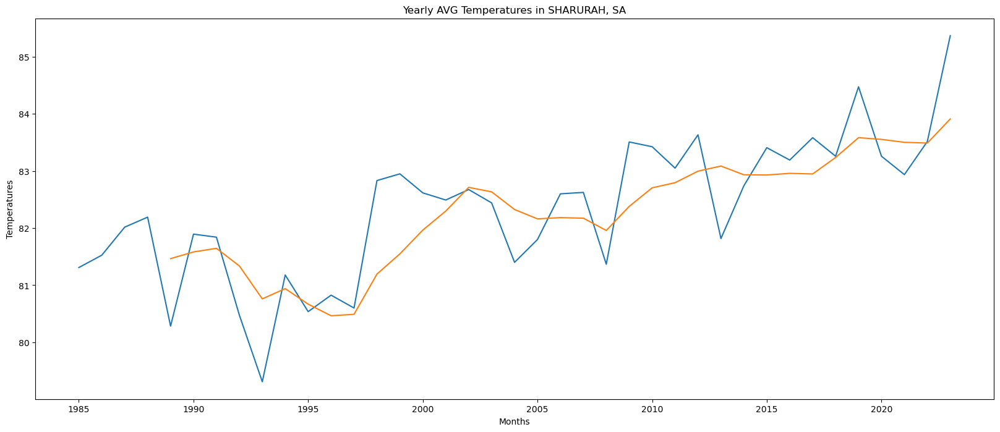

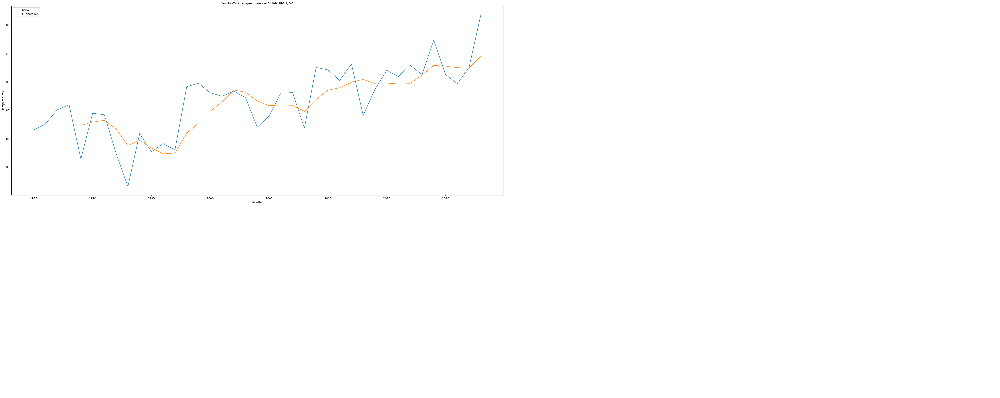

	 SHARURAH, SA  data :
                 STATION          NAME   TAVG
DATE                                        
1985-02-01  SAM00041136  SHARURAH, SA  62.70
1985-03-01  SAM00041136  SHARURAH, SA  79.10
1985-04-01  SAM00041136  SHARURAH, SA  83.50
1985-05-01  SAM00041136  SHARURAH, SA  88.30
1985-06-01  SAM00041136  SHARURAH, SA  89.00
...                 ...           ...    ...
2023-08-01  SAM00041136  SHARURAH, SA  98.10
2023-09-01  SAM00041136  SHARURAH, SA  89.84
2023-10-01  SAM00041136  SHARURAH, SA  86.50
2023-11-01  SAM00041136  SHARURAH, SA  82.30
2023-12-01  SAM00041136  SHARURAH, SA  69.90

[467 rows x 3 columns] 




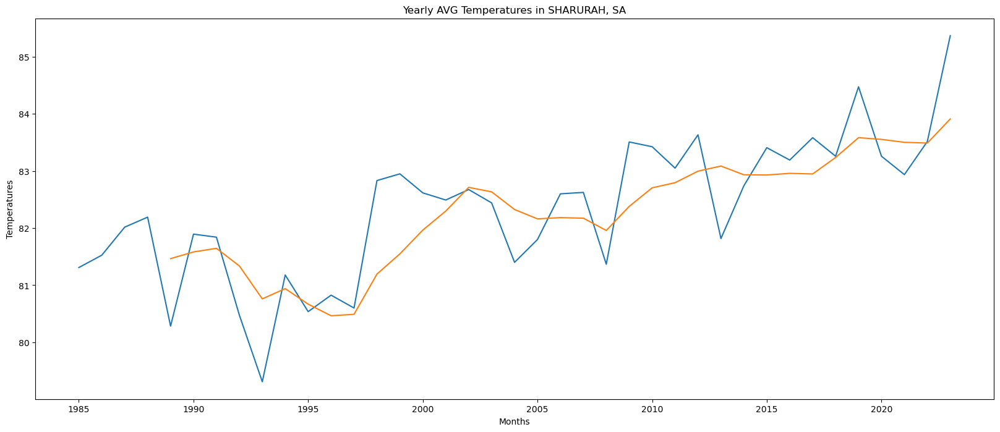

Baseline data in validation DATE
2019-02-01    70.1
2019-03-01    72.5
2019-04-01    79.6
2019-05-01    85.5
2019-06-01    88.6
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 5.3723 celsius degrees 




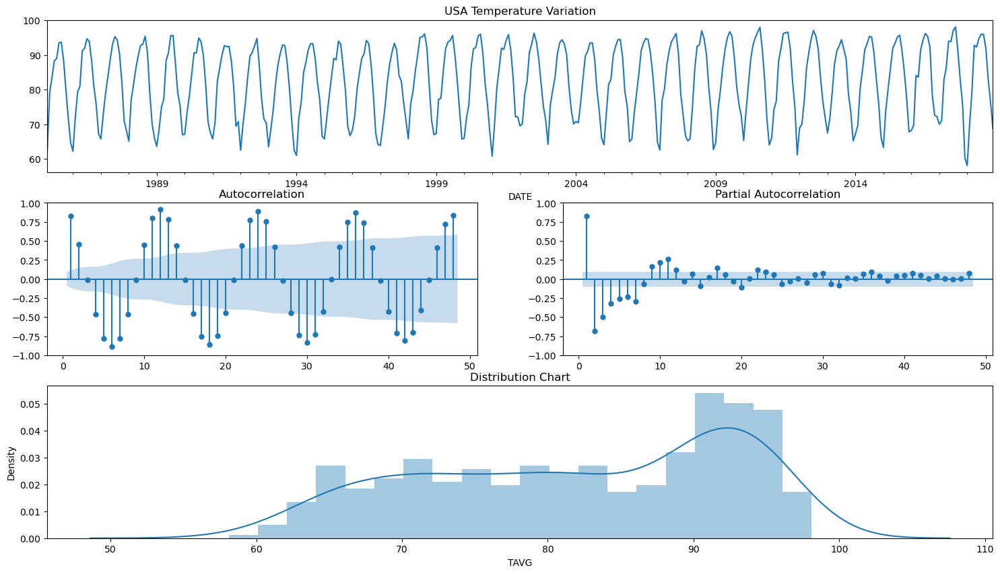


Results of Dickey-Fuller Test:
Test Statistic                  -3.6250
p-value                          0.0053
Lags Used                       15.0000
Number of Observations Used    391.0000
Critical Value (1%)             -3.4472
Critical Value (5%)             -2.8690
Critical Value (10%)            -2.5707
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


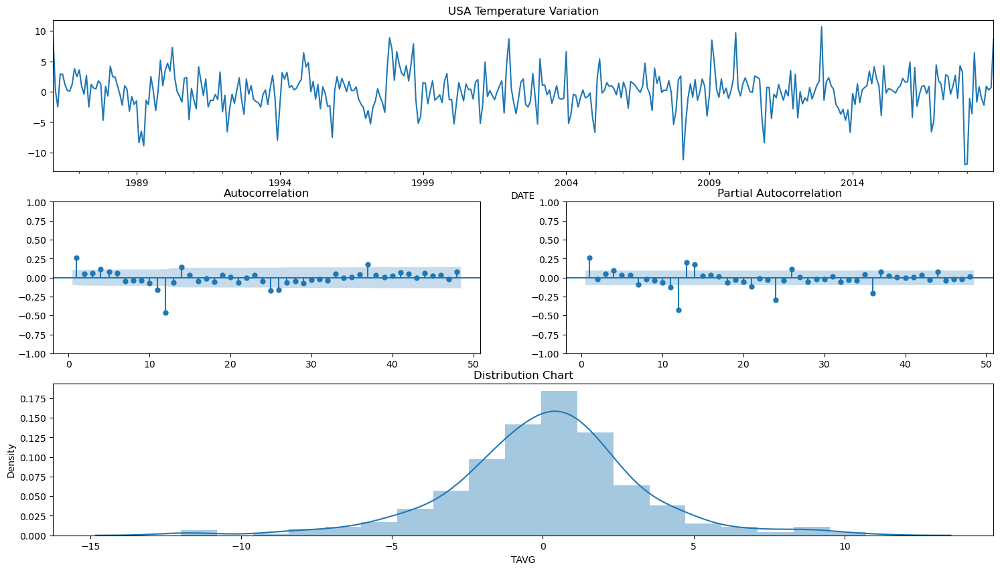


Results of Dickey-Fuller Test:
Test Statistic                  -5.8138
p-value                          0.0000
Lags Used                       13.0000
Number of Observations Used    381.0000
Critical Value (1%)             -3.4476
Critical Value (5%)             -2.8692
Critical Value (10%)            -2.5708
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 1.9361 celsius degrees
It's a decrease of -63.96% in the RMSE
                STATION          NAME  TAVG       Pred     Error
DATE                                                            
2019-01-01  SAM00041136  SHARURAH, SA  70.1  66.824485  3.275515
2019-02-01  SAM00041136  SHARURAH, SA  72.5  73.815198 -1.315198
2019-03-01  SAM00041136  SHARURAH, SA  79.6  80.398288 -0.798288
2019-04-01  SAM00041136  SHARURAH, SA  85.5  86.662344 -1.162344
2019-05-01  SAM00041136  SHARURAH, SA  88.6  91.761689 -3.161689 




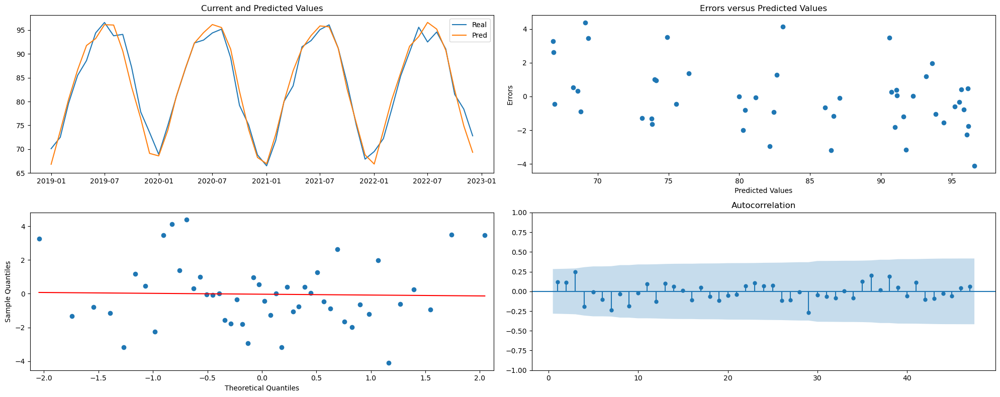

DATE
1985-02-01    62.7
1985-03-01    79.1
1985-04-01    83.5
1985-05-01    88.3
1985-06-01    89.0
Name: TAVG, dtype: float64 




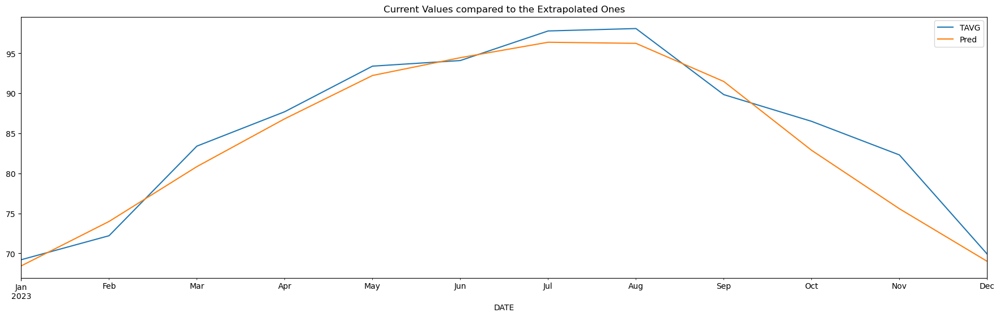

The baseline RMSE for the test baseline was 6.13 celsius degrees
The baseline RMSE for the test extrapolation was 2.58 celsius degrees
That is an improvement of 57.87%
Processing files in folder: Zambia
Reading file: Zambia.csv
         DATE   TAVG    NAME  STATION
0  1974-01-01  73.71  Zambia       20
1  1974-02-01  73.08  Zambia       20
2  1974-03-01  71.86  Zambia       20
3  1974-04-01  67.56  Zambia       20
4  1974-05-01  64.50  Zambia       20

             TAVG    NAME  STATION
DATE                              
1974-01-01  73.71  Zambia       20
1974-02-01  73.08  Zambia       20
1974-03-01  71.86  Zambia       20
1974-04-01  67.56  Zambia       20
1974-05-01  64.50  Zambia       20
...           ...     ...      ...
2023-09-01  77.00  Zambia       20
2023-10-01  70.40  Zambia       20
2023-11-01  71.10  Zambia       20
2023-12-01  74.82  Zambia       20
2024-01-01  86.90  Zambia       20

[601 rows x 3 columns]

Index(['TAVG', 'NAME', 'STATION'], dtype='object')
            

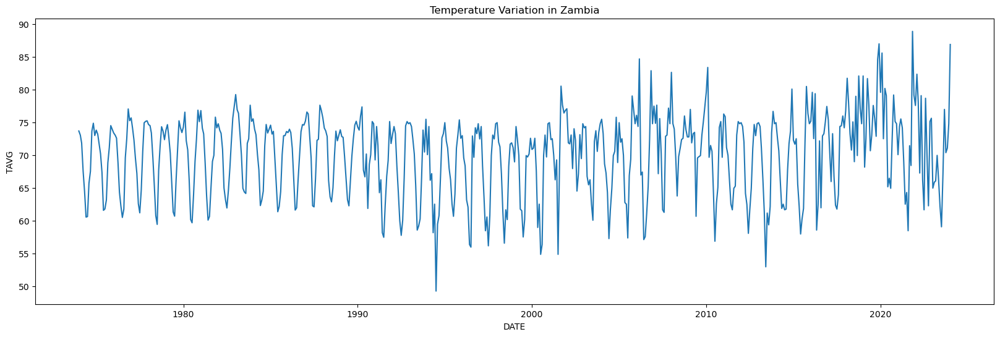

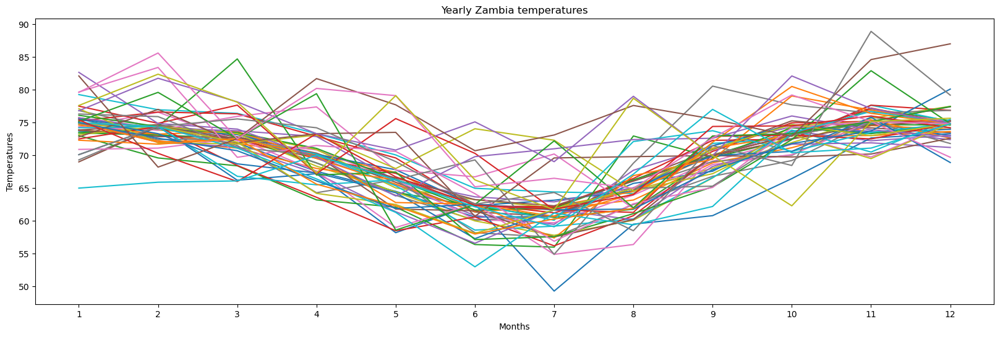

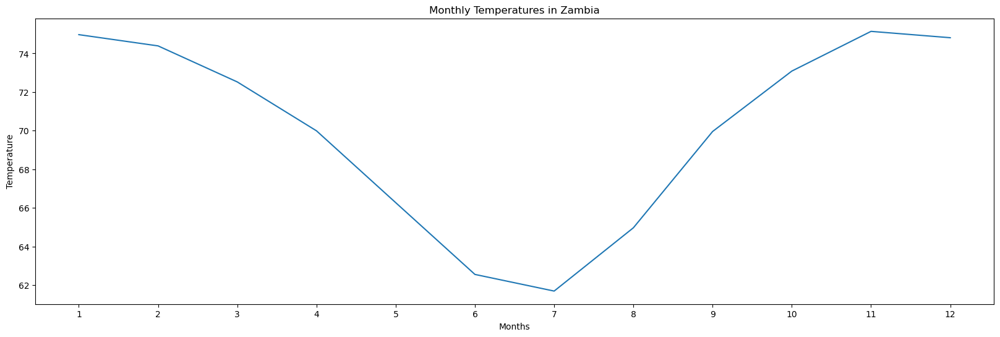

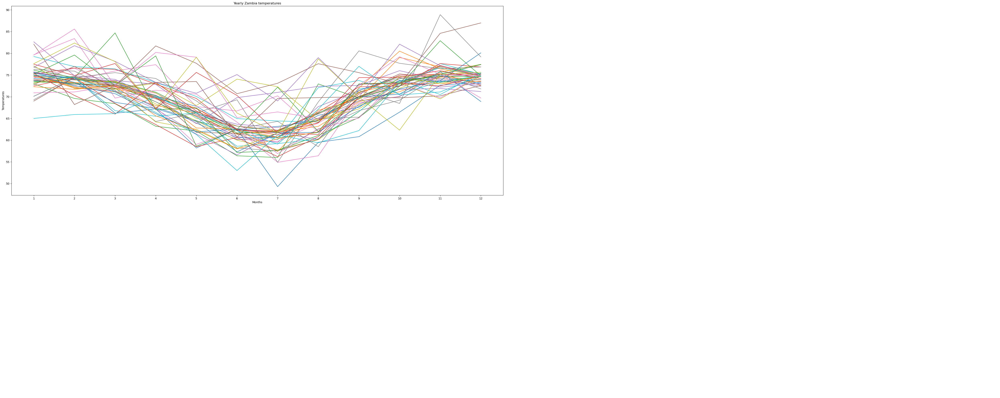

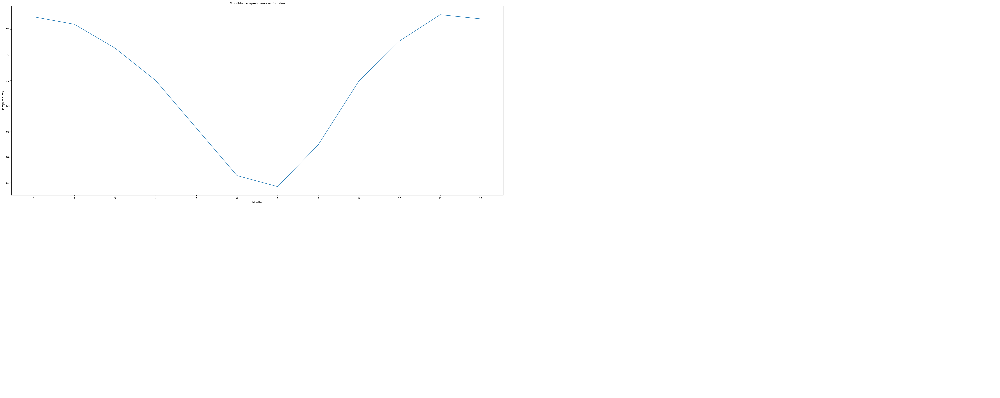

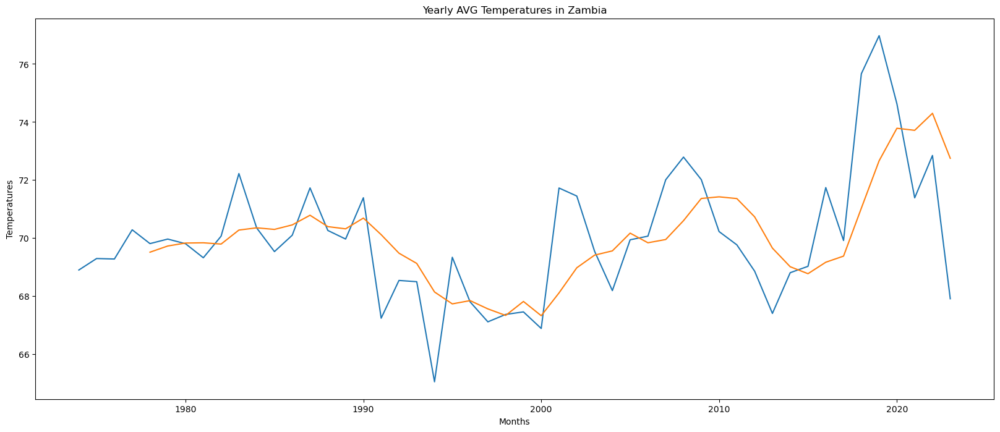

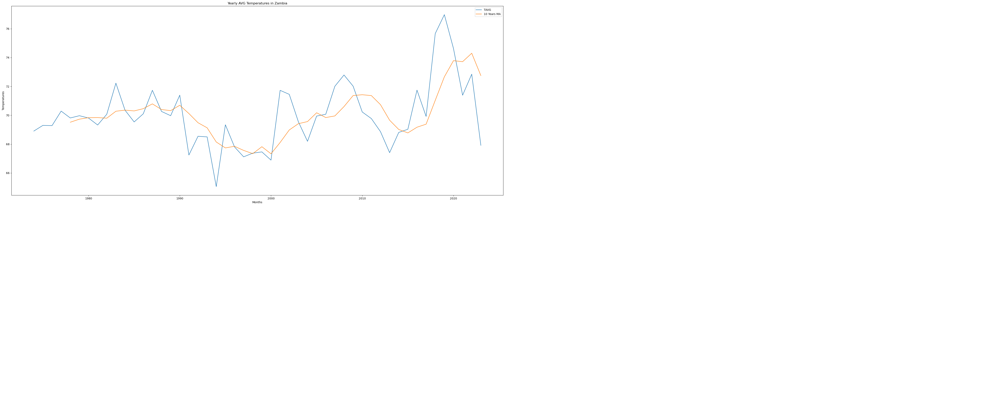

	 Zambia  data :
              TAVG    NAME  STATION
DATE                              
1974-01-01  73.71  Zambia       20
1974-02-01  73.08  Zambia       20
1974-03-01  71.86  Zambia       20
1974-04-01  67.56  Zambia       20
1974-05-01  64.50  Zambia       20
...           ...     ...      ...
2023-09-01  77.00  Zambia       20
2023-10-01  70.40  Zambia       20
2023-11-01  71.10  Zambia       20
2023-12-01  74.82  Zambia       20
2024-01-01  86.90  Zambia       20

[601 rows x 3 columns] 




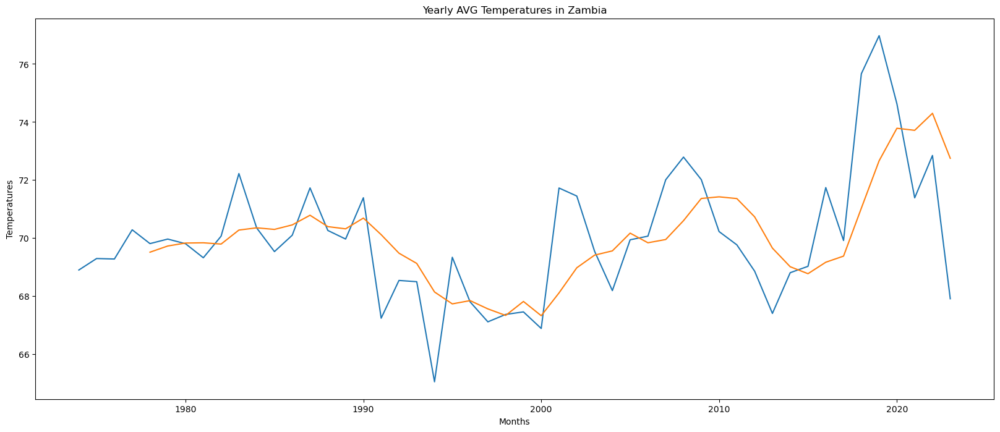

Baseline data in validation DATE
2019-02-01    82.10
2019-03-01    68.20
2019-04-01    72.53
2019-05-01    81.70
2019-06-01    77.70
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 54.3777 celsius degrees 




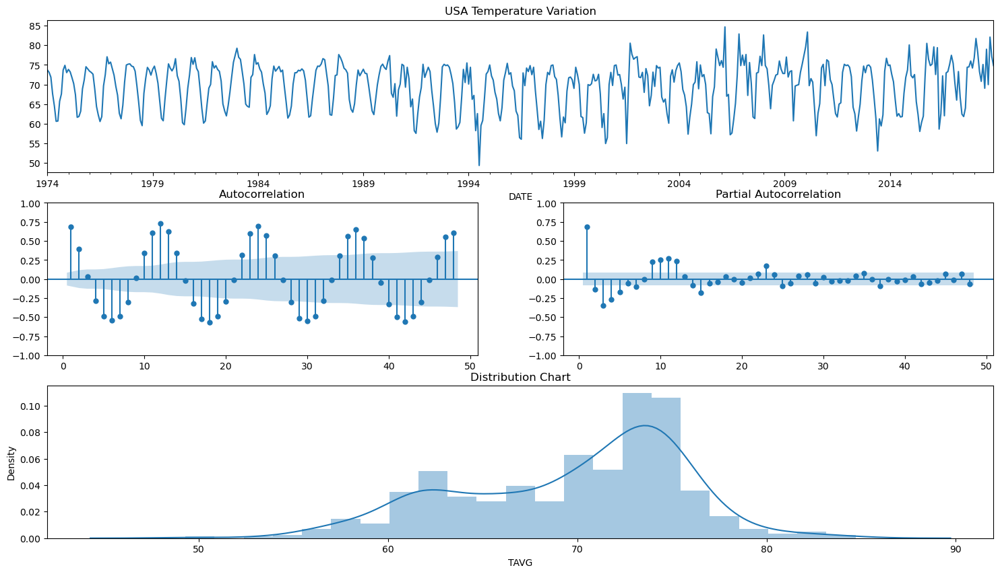


Results of Dickey-Fuller Test:
Test Statistic                  -3.3332
p-value                          0.0135
Lags Used                       15.0000
Number of Observations Used    524.0000
Critical Value (1%)             -3.4429
Critical Value (5%)             -2.8671
Critical Value (10%)            -2.5697
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


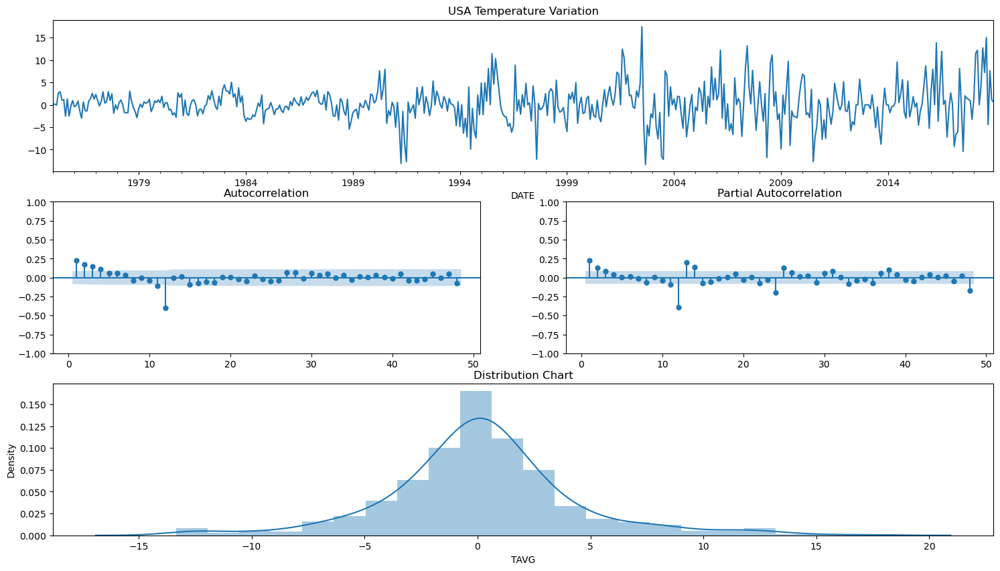


Results of Dickey-Fuller Test:
Test Statistic                  -6.6904
p-value                          0.0000
Lags Used                       15.0000
Number of Observations Used    512.0000
Critical Value (1%)             -3.4432
Critical Value (5%)             -2.8672
Critical Value (10%)            -2.5698
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 6.1537 celsius degrees
It's a decrease of -88.68% in the RMSE
             TAVG    NAME  STATION       Pred      Error
DATE                                                    
2019-01-01  82.10  Zambia       20  76.686909   5.413091
2019-02-01  68.20  Zambia       20  76.643890  -8.443890
2019-03-01  72.53  Zambia       20  72.952231  -0.422231
2019-04-01  81.70  Zambia       20  69.415160  12.284840
2019-05-01  77.70  Zambia       20  67.346639  10.353361 




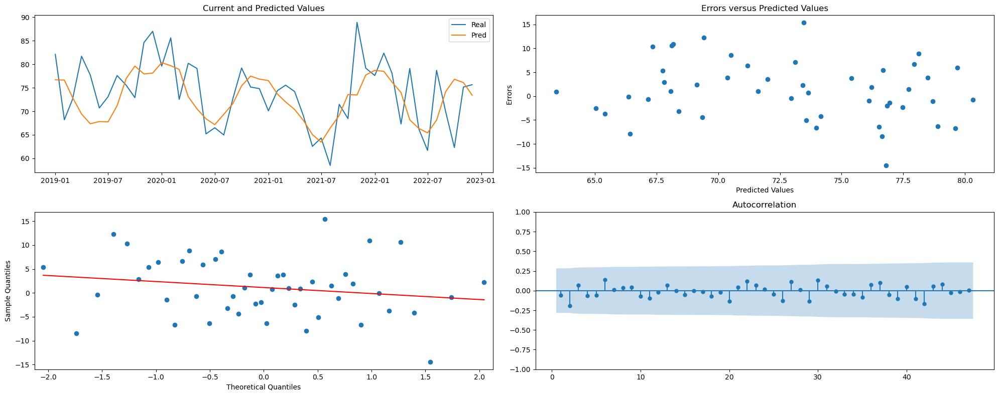

DATE
1974-01-01    73.71
1974-02-01    73.08
1974-03-01    71.86
1974-04-01    67.56
1974-05-01    64.50
Name: TAVG, dtype: float64 




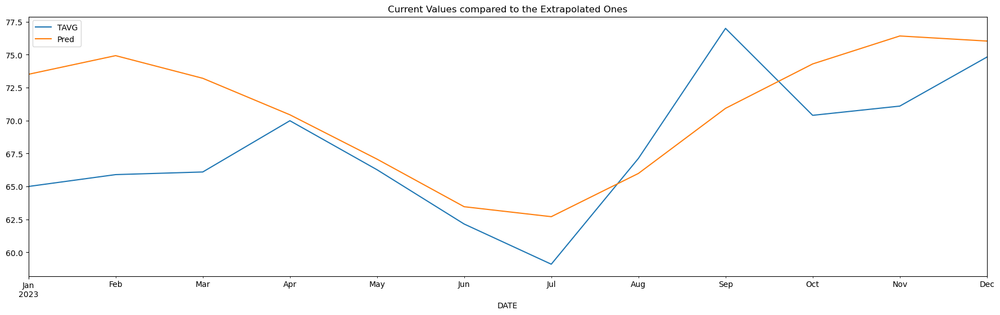

The baseline RMSE for the test baseline was 4.79 celsius degrees
The baseline RMSE for the test extrapolation was 5.03 celsius degrees
That is an improvement of -4.86%
Processing files in folder: Zimbabwe
Reading file: Zimbabwe.csv
         DATE   TAVG
0  1974-01-01  70.65
1  1974-02-01  69.95
2  1974-03-01  68.50
3  1974-04-01  63.25
4  1974-05-01  59.70

             TAVG
DATE             
1974-01-01  70.65
1974-02-01  69.95
1974-03-01  68.50
1974-04-01  63.25
1974-05-01  59.70
...           ...
2017-06-01  57.70
2017-07-01  57.00
2017-08-01  59.80
2017-09-01  67.66
2017-10-01  72.60

[526 rows x 1 columns]

Index(['TAVG'], dtype='object')
Zimbabwe.csv
             TAVG          NAME
DATE                           
1974-01-01  70.65  Zimbabwe.csv
1974-02-01  69.95  Zimbabwe.csv
1974-03-01  68.50  Zimbabwe.csv
1974-04-01  63.25  Zimbabwe.csv
1974-05-01  59.70  Zimbabwe.csv
...           ...           ...
2017-06-01  57.70  Zimbabwe.csv
2017-07-01  57.00  Zimbabwe.csv
2017-08-01  59.80

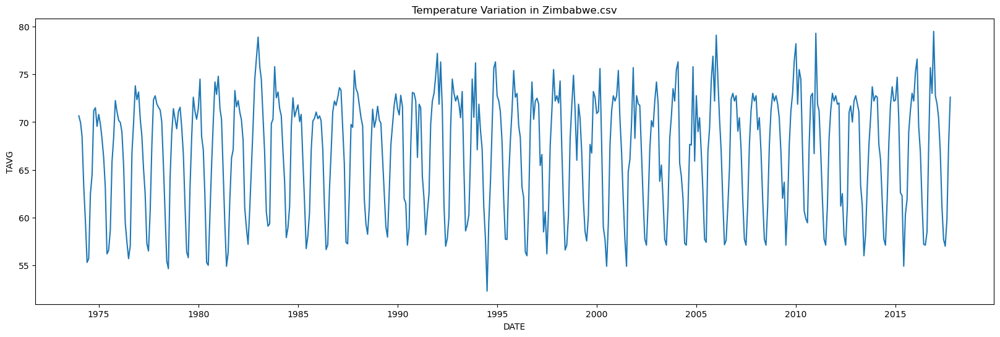

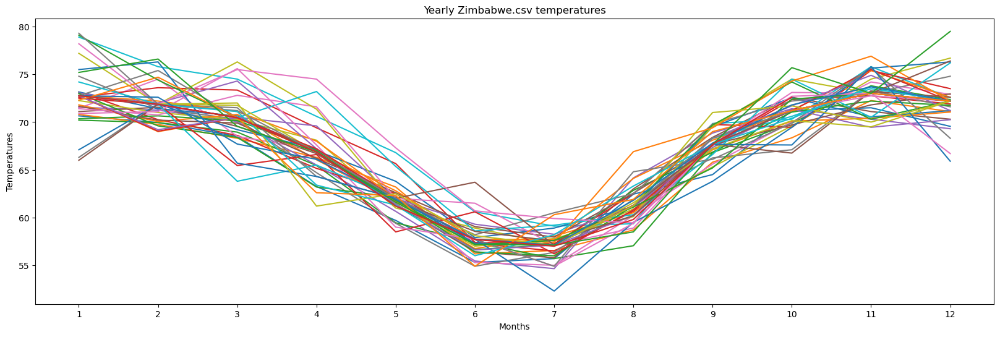

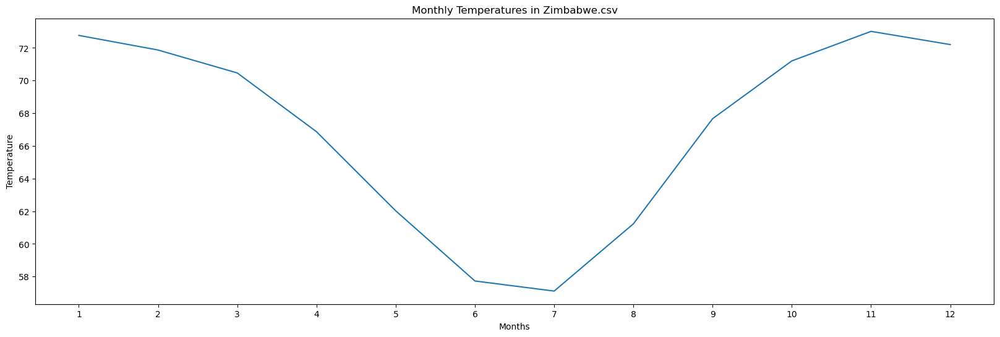

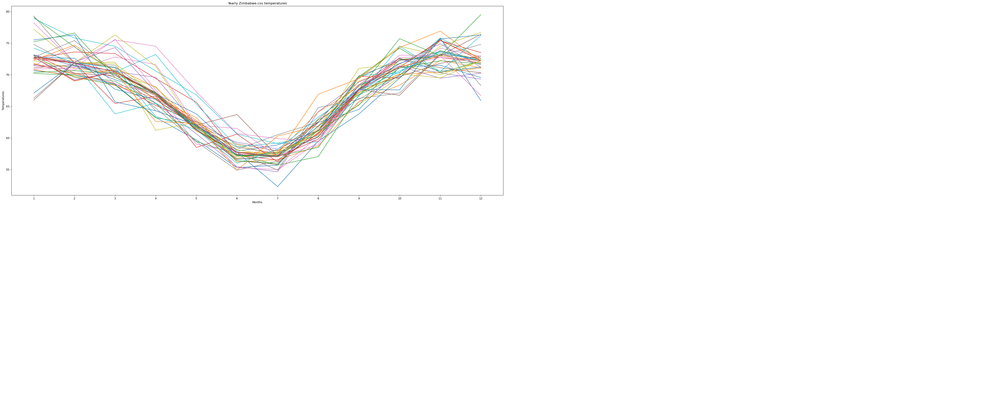

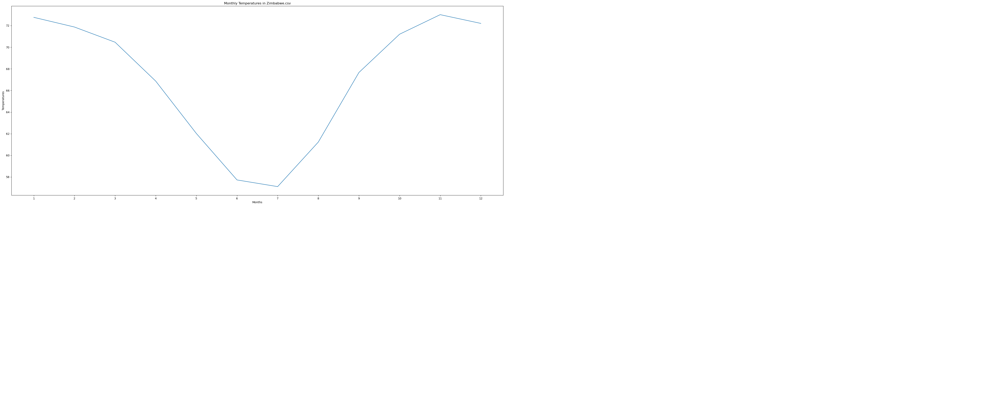

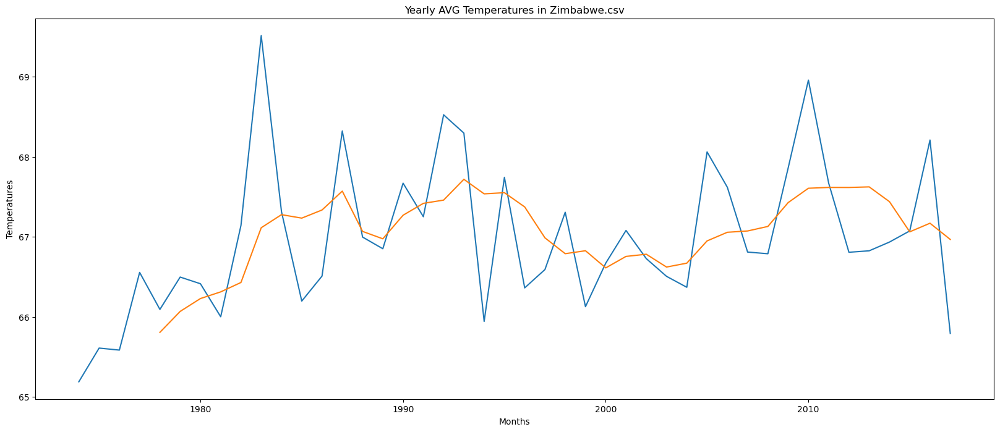

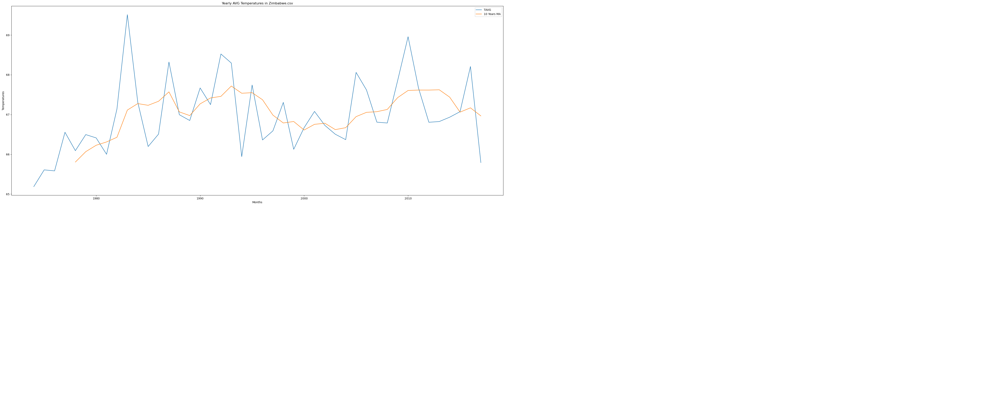

	 Zimbabwe.csv  data :
              TAVG          NAME
DATE                           
1974-01-01  70.65  Zimbabwe.csv
1974-02-01  69.95  Zimbabwe.csv
1974-03-01  68.50  Zimbabwe.csv
1974-04-01  63.25  Zimbabwe.csv
1974-05-01  59.70  Zimbabwe.csv
...           ...           ...
2017-06-01  57.70  Zimbabwe.csv
2017-07-01  57.00  Zimbabwe.csv
2017-08-01  59.80  Zimbabwe.csv
2017-09-01  67.66  Zimbabwe.csv
2017-10-01  72.60  Zimbabwe.csv

[526 rows x 2 columns] 




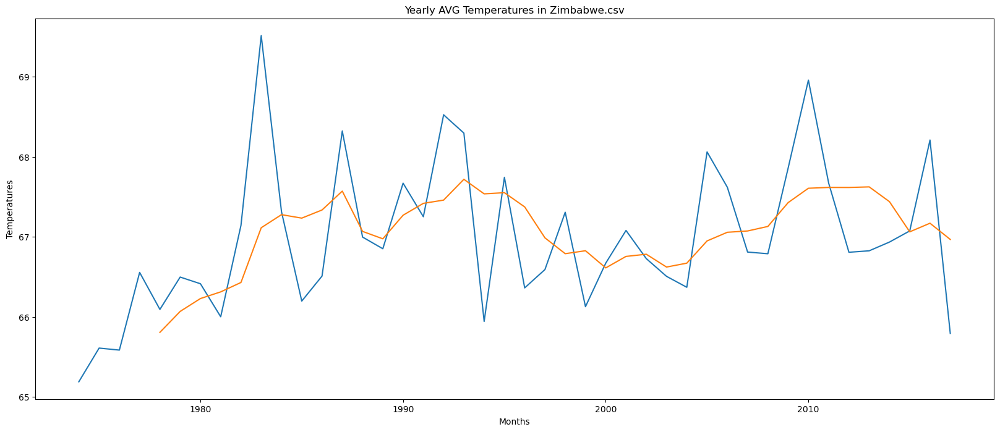

Baseline data in validation DATE
2012-12-01    70.00
2013-01-01    72.20
2013-02-01    72.76
2013-03-01    71.87
2013-04-01    71.10
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 60.953 celsius degrees 




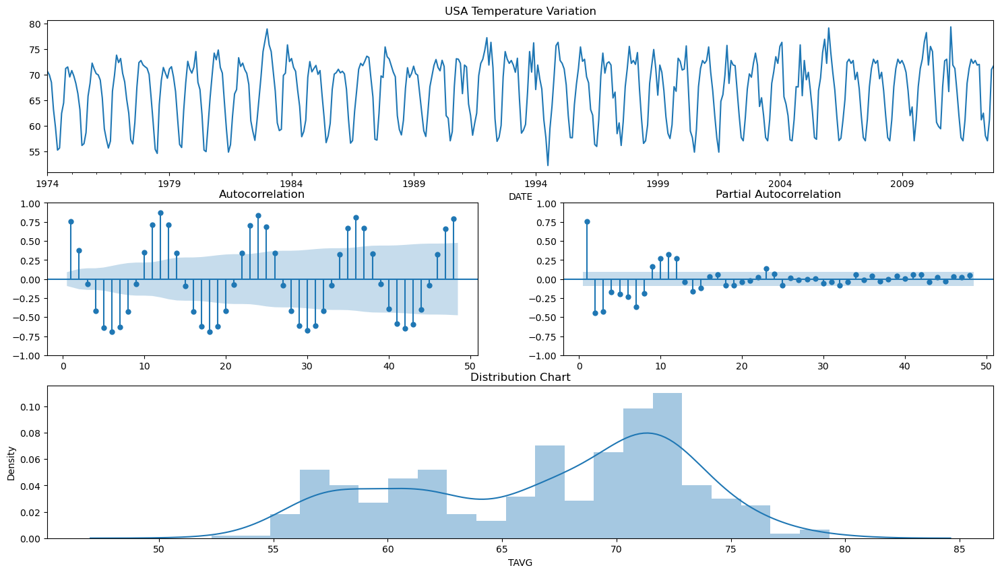


Results of Dickey-Fuller Test:
Test Statistic                  -4.8745
p-value                          0.0000
Lags Used                       14.0000
Number of Observations Used    451.0000
Critical Value (1%)             -3.4449
Critical Value (5%)             -2.8680
Critical Value (10%)            -2.5702
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


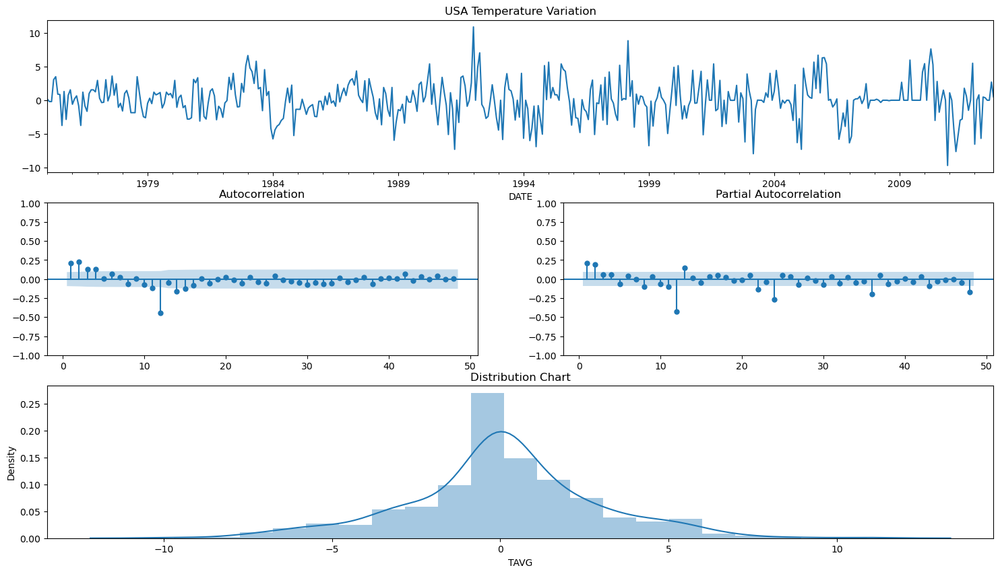


Results of Dickey-Fuller Test:
Test Statistic                  -7.9005
p-value                          0.0000
Lags Used                       12.0000
Number of Observations Used    441.0000
Critical Value (1%)             -3.4453
Critical Value (5%)             -2.8681
Critical Value (10%)            -2.5703
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 1.9239 celsius degrees
It's a decrease of -96.84% in the RMSE
             TAVG          NAME       Pred     Error
DATE                                                
2012-11-01  70.00  Zimbabwe.csv  74.056963 -4.056963
2012-12-01  72.20  Zimbabwe.csv  72.232421 -0.032421
2013-01-01  72.76  Zimbabwe.csv  72.722638  0.037362
2013-02-01  71.87  Zimbabwe.csv  71.806090  0.063910
2013-03-01  71.10  Zimbabwe.csv  70.964627  0.135373 




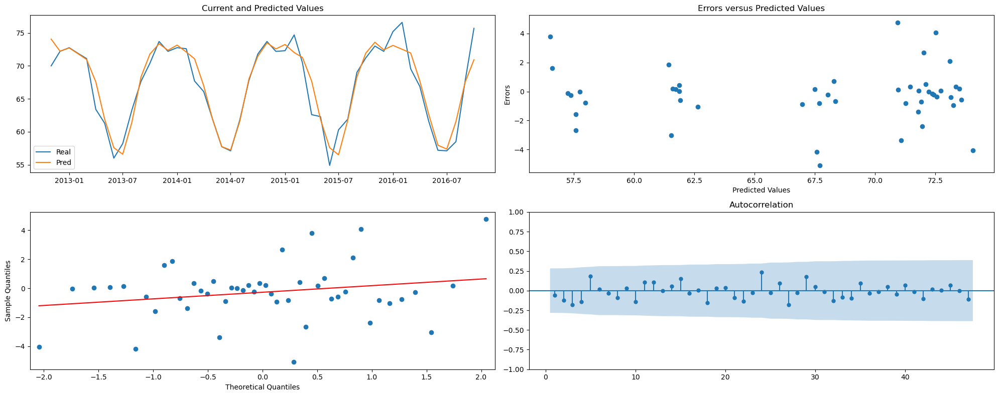

DATE
1974-01-01    70.65
1974-02-01    69.95
1974-03-01    68.50
1974-04-01    63.25
1974-05-01    59.70
Name: TAVG, dtype: float64 




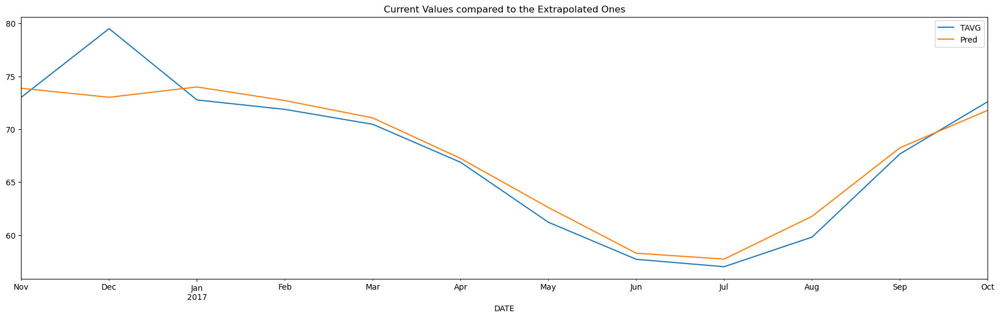

The baseline RMSE for the test baseline was 4.49 celsius degrees
The baseline RMSE for the test extrapolation was 2.11 celsius degrees
That is an improvement of 53.14%
Processing files in folder: paraguay
Reading file: paraguay.csv
         DATE   TAVG
0  1974-01-01  83.47
1  1974-02-01  81.94
2  1974-03-01  79.92
3  1974-04-01  75.54
4  1974-05-01  69.25

             TAVG
DATE             
1974-01-01  83.47
1974-02-01  81.94
1974-03-01  79.92
1974-04-01  75.54
1974-05-01  69.25
...           ...
2023-09-01  71.32
2023-10-01  79.45
2023-11-01  78.31
2023-12-01  87.05
2024-01-01  85.10

[601 rows x 1 columns]

Index(['TAVG'], dtype='object')
paraguay.csv
             TAVG          NAME
DATE                           
1974-01-01  83.47  paraguay.csv
1974-02-01  81.94  paraguay.csv
1974-03-01  79.92  paraguay.csv
1974-04-01  75.54  paraguay.csv
1974-05-01  69.25  paraguay.csv
...           ...           ...
2023-09-01  71.32  paraguay.csv
2023-10-01  79.45  paraguay.csv
2023-11-01  78.31

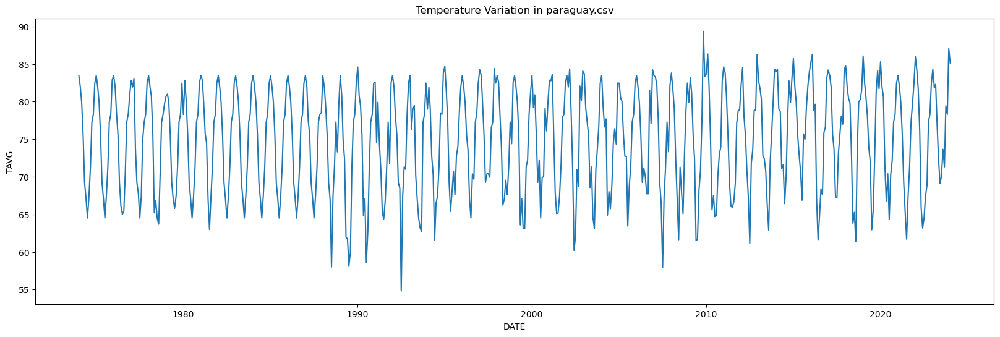

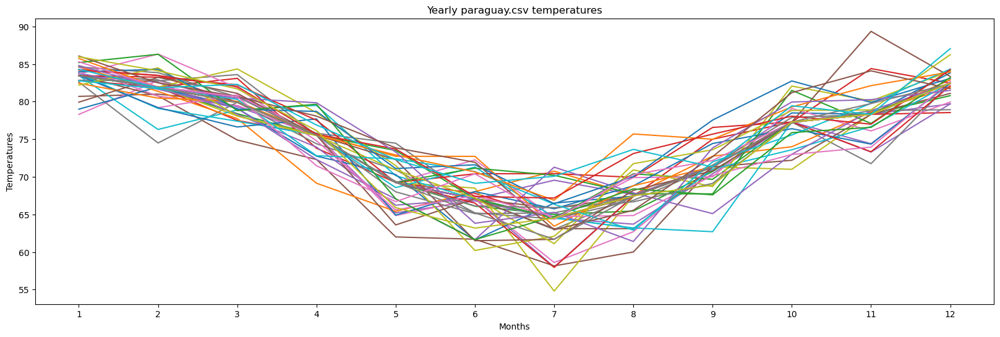

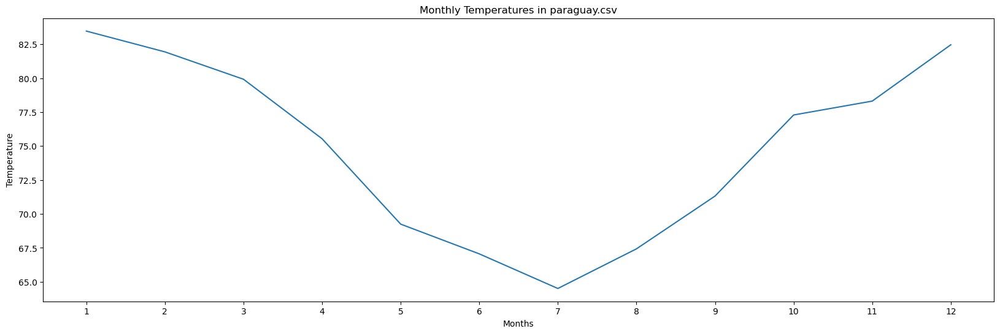

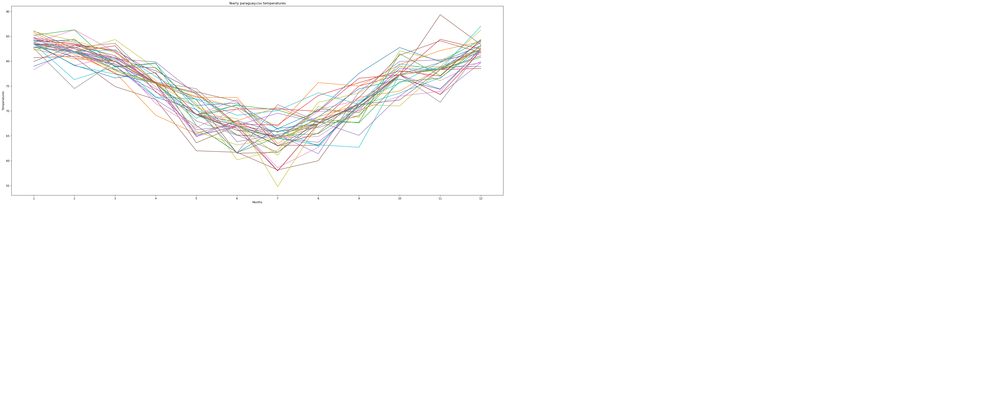

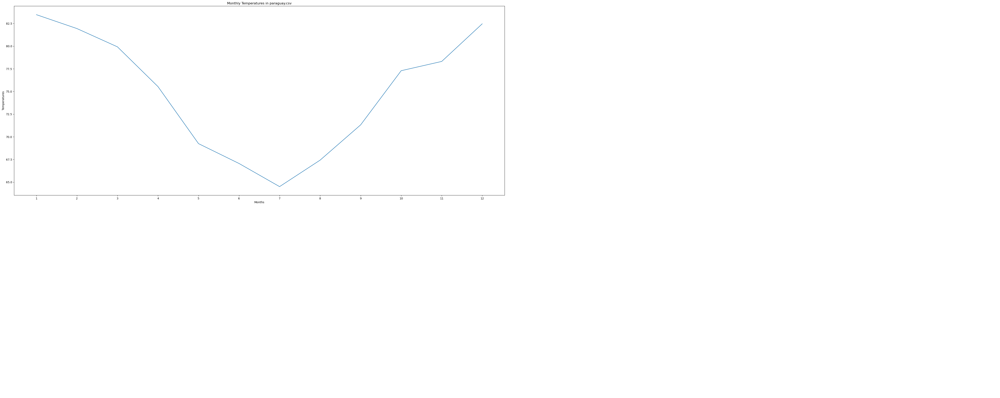

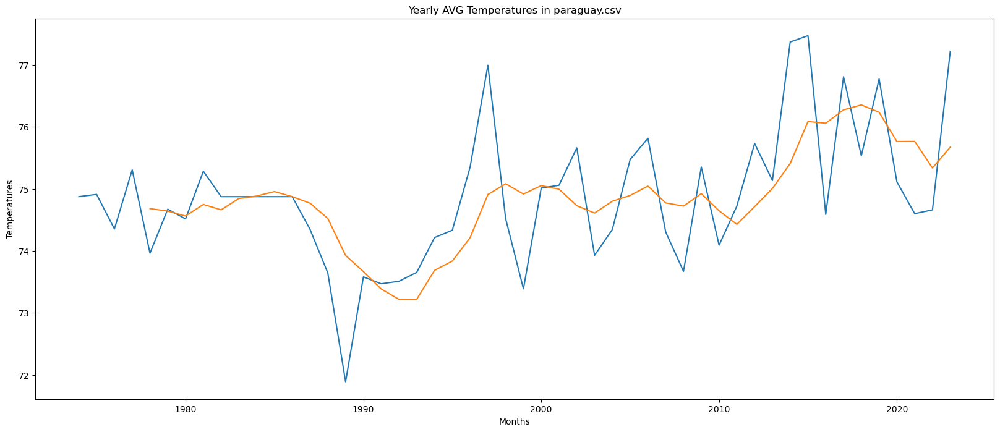

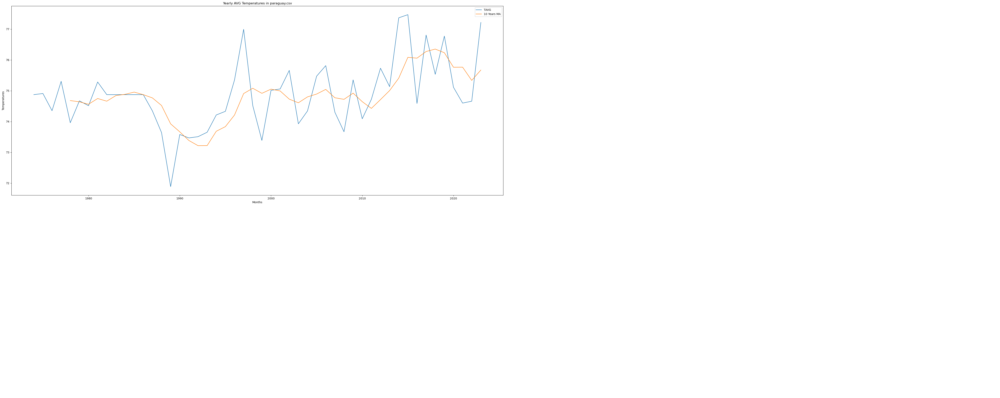

	 paraguay.csv  data :
              TAVG          NAME
DATE                           
1974-01-01  83.47  paraguay.csv
1974-02-01  81.94  paraguay.csv
1974-03-01  79.92  paraguay.csv
1974-04-01  75.54  paraguay.csv
1974-05-01  69.25  paraguay.csv
...           ...           ...
2023-09-01  71.32  paraguay.csv
2023-10-01  79.45  paraguay.csv
2023-11-01  78.31  paraguay.csv
2023-12-01  87.05  paraguay.csv
2024-01-01  85.10  paraguay.csv

[601 rows x 2 columns] 




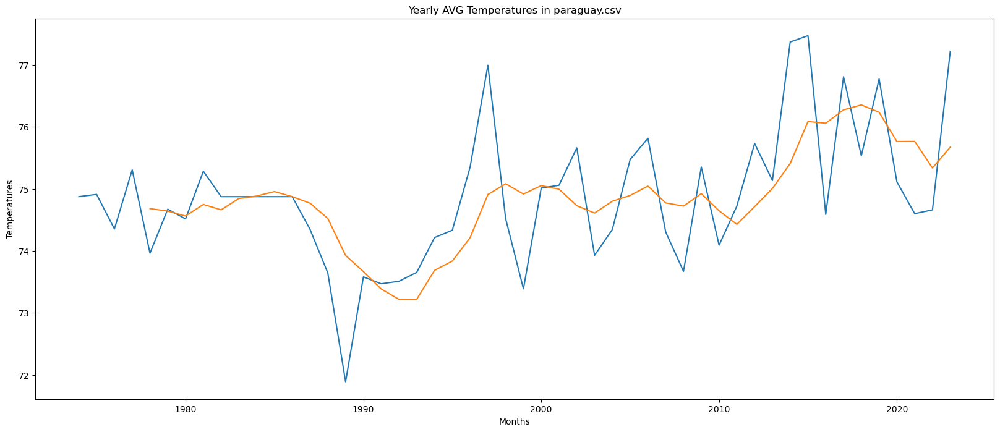

Baseline data in validation DATE
2019-02-01    86.07
2019-03-01    82.50
2019-04-01    80.67
2019-05-01    78.07
2019-06-01    73.85
Name: TAVG, dtype: float64 


The RMSE of the baseline that we will try to diminish is 69.1315 celsius degrees 




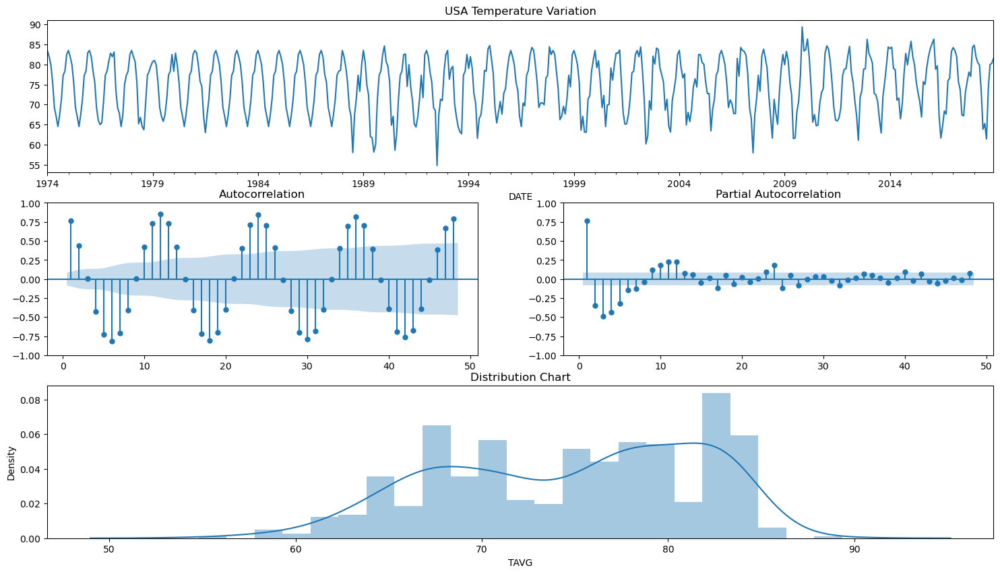


Results of Dickey-Fuller Test:
Test Statistic                  -4.1593
p-value                          0.0008
Lags Used                       16.0000
Number of Observations Used    523.0000
Critical Value (1%)             -3.4429
Critical Value (5%)             -2.8671
Critical Value (10%)            -2.5697
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary


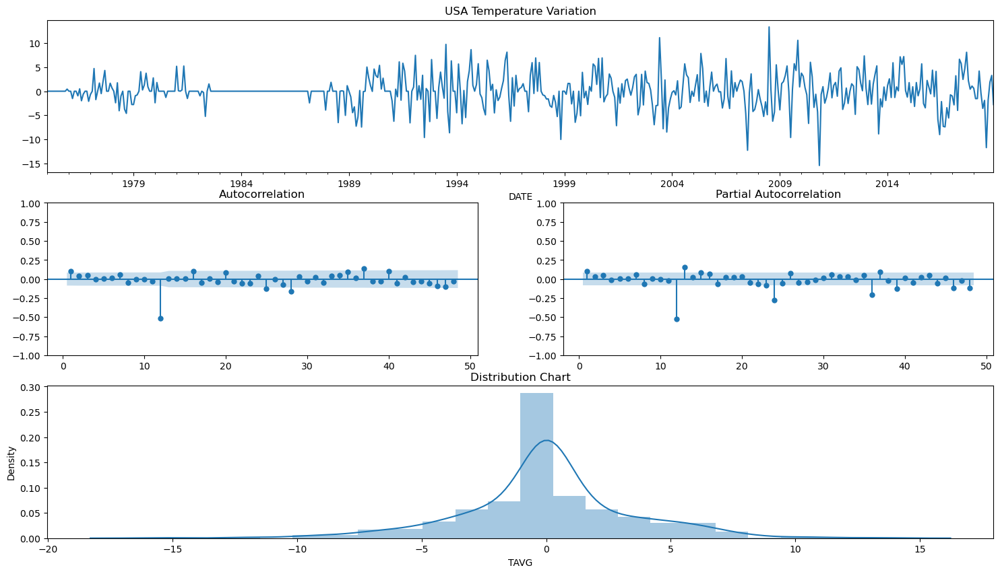


Results of Dickey-Fuller Test:
Test Statistic                  -6.2518
p-value                          0.0000
Lags Used                       16.0000
Number of Observations Used    511.0000
Critical Value (1%)             -3.4432
Critical Value (5%)             -2.8672
Critical Value (10%)            -2.5698
dtype: float64

The Test Statistics is lower than the Critical Value of 5%.
The serie seems to be stationary
The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was 2.1139 celsius degrees
It's a decrease of -96.94% in the RMSE
             TAVG          NAME       Pred     Error
DATE                                                
2019-01-01  86.07  paraguay.csv  83.964943  2.105057
2019-02-01  82.50  paraguay.csv  82.978750 -0.478750
2019-03-01  80.67  paraguay.csv  80.424223  0.245777
2019-04-01  78.07  paraguay.csv  76.449353  1.620647
2019-05-01  73.85  paraguay.csv  70.210682  3.639318 




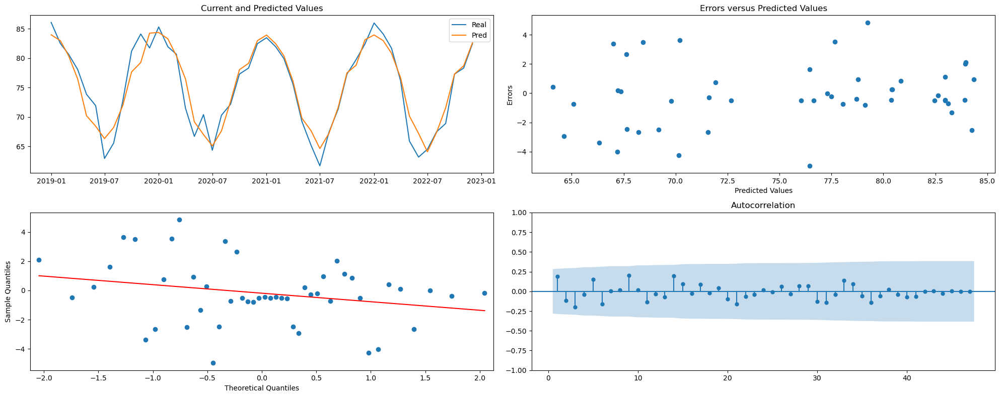

DATE
1974-01-01    83.47
1974-02-01    81.94
1974-03-01    79.92
1974-04-01    75.54
1974-05-01    69.25
Name: TAVG, dtype: float64 




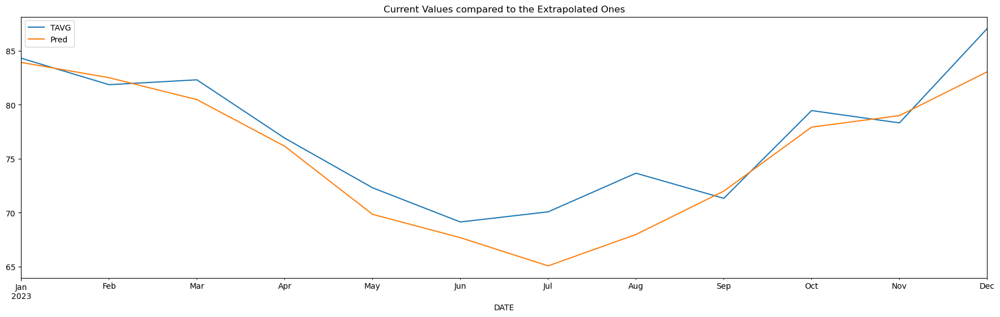

The baseline RMSE for the test baseline was 4.37 celsius degrees
The baseline RMSE for the test extrapolation was 2.73 celsius degrees
That is an improvement of 37.63%


In [14]:
data_folder = "folder_data"

for folder in sorted(os.listdir(data_folder)):
    folder_path = os.path.join(data_folder, folder)
    if os.path.isdir(folder_path):
        print(f"Processing files in folder: {folder}")
        for file in os.listdir(folder_path):
            file_path = os.path.join(folder_path, file)
            pkl_files_exist = any(file.endswith('.pkl') for file in os.listdir(folder_path))
            if file.endswith('.csv') and pkl_files_exist==False:
                print(f"Reading file: {file}")
                df = pd.read_csv(file_path)
                print(df.head())
                print()
                
                df['DATE'] = pd.to_datetime(df['DATE'])
                df.reset_index(drop=True, inplace=True)
                df.set_index('DATE', inplace=True)
                print(df)
                print()
                
#                 check1 = input("check1 --")
                
                print(df.columns)
                if "NAME" not in df.columns:
                    print(file)
                    df['NAME'] = file
                print(df)
                    
                df = df[(df['NAME'] != 'ABERDEEN PHILLIPS FIELD, MD US') & (df['NAME'] != '1 N MCLEANSBORO, IL US')]

                cities = df['NAME'].unique()
                print(cities)
                print()

                for city in cities:
                    city_data = df[df['NAME'] == city]
                    plt.figure(figsize=(20,6))
                    sns.lineplot(x=city_data.index, y=city_data['TAVG'])
                    plt.title('Temperature Variation in '+city)
                    plt.show()

                for city in cities:
                    city_data = df[df['NAME'] == city]
                    city_data['month'] = city_data.index.month
                    city_data['year'] = city_data.index.year
                    pivot = pd.pivot_table(city_data, values='TAVG', index='month', columns='year', aggfunc='mean')
                    pivot.plot(figsize=(20,6))
                    plt.title('Yearly '+city+' temperatures')
                    plt.xlabel('Months')
                    plt.ylabel('Temperatures')
                    plt.xticks([x for x in range(1,13)])
                    plt.legend().remove()
                    plt.show()

                    monthly_seasonality = pivot.mean(axis=1)
                    monthly_seasonality.plot(figsize=(20,6))
                    plt.title('Monthly Temperatures in '+city)
                    plt.xlabel('Months')
                    plt.ylabel('Temperature')
                    plt.xticks([x for x in range(1,13)])
                    plt.show()

                if len(cities) == 1:
                    axis1, axis2 = 2,2
                else:
                    input_str = input("Number of cities into grid:")
                    axis1, axis2 = map(int, input_str.split())

                fig, axs = plt.subplots(axis1,axis2, figsize=(100, 100))
                axs = axs.flatten()

                for i, city in enumerate(cities):
                    city_data = df[df['NAME'] == city]
                    city_data['month'] = city_data.index.month
                    city_data['year'] = city_data.index.year
                    pivot = pd.pivot_table(city_data, values='TAVG', index='month', columns='year', aggfunc='mean')
                    pivot.plot(ax=axs[i], figsize=(50, 20))
                    axs[i].set_title('Yearly '+city+' temperatures')
                    axs[i].set_xlabel('Months')
                    axs[i].set_ylabel('Temperatures')
                    axs[i].set_xticks([x for x in range(1, 13)])
                    axs[i].legend().remove()

                for i in range(len(cities), len(axs)):
                    axs[i].axis('off')

                plt.tight_layout()
                plt.show()

                fig, axs = plt.subplots(axis1, axis2, figsize=(100, 100))
                axs = axs.flatten()

                for i, city in enumerate(cities):
                    city_data = df[df['NAME'] == city]
                    city_data['month'] = city_data.index.month
                    city_data['year'] = city_data.index.year
                    pivot = pd.pivot_table(city_data, values='TAVG', index='month', columns='year', aggfunc='mean')
                    monthly_seasonality = pivot.mean(axis=1)
                    monthly_seasonality.plot(ax=axs[i], figsize=(50, 20))
                    axs[i].set_title('Monthly Temperatures in '+city)
                    axs[i].set_xlabel('Months')
                    axs[i].set_ylabel('Temperatures')
                    axs[i].set_xticks([x for x in range(1, 13)])

                for i in range(len(cities), len(axs)):
                    axs[i].axis('off')

                plt.tight_layout()
                plt.show()

                for i, city in enumerate(cities):
                    city_data = df[df['NAME'] == city]
                    city_data['month'] = city_data.index.month
                    city_data['year'] = city_data.index.year
                    city_data = city_data[city_data['year'] <= 2023]
                    year_avg = pd.pivot_table(city_data, values='TAVG', index='year', aggfunc='mean')
                    year_avg['5 Years MA'] = year_avg['TAVG'].rolling(5).mean()
                    year_avg[['TAVG','5 Years MA']].plot(figsize=(20, 8))
                    plt.title('Yearly AVG Temperatures in '+city)
                    plt.xlabel('Months')
                    plt.ylabel('Temperatures')
                    plt.legend().remove()
                    plt.show()

                fig, axs = plt.subplots(axis1, axis2, figsize=(100, 100))
                axs = axs.flatten()

                for i, city in enumerate(cities):
                    city_data = df[df['NAME'] == city]
                    city_data['month'] = city_data.index.month
                    city_data['year'] = city_data.index.year
                    city_data = city_data[city_data['year'] <= 2023]
                    year_avg = pd.pivot_table(city_data, values='TAVG', index='year', aggfunc='mean')
                    year_avg['10 Years MA'] = year_avg['TAVG'].rolling(5).mean()
                    year_avg[['TAVG','10 Years MA']].plot(ax=axs[i], figsize=(50, 20))
                    axs[i].set_title('Yearly AVG Temperatures in '+city)
                    axs[i].set_xlabel('Months')
                    axs[i].set_ylabel('Temperatures')

                for i in range(len(cities), len(axs)):
                    axs[i].axis('off')

                plt.tight_layout()
                plt.show()

                for city in cities:
                    data = df[df['NAME'] == city]
                    print("\t",city," data :\n",data,"\n\n")
                    data['month'] = data.index.month
                    data['year'] = data.index.year
                    data = data[data['year'] <= 2023]
                    year_avg = pd.pivot_table(data, values='TAVG', index='year', aggfunc='mean')
                    year_avg['10 Years MA'] = year_avg['TAVG'].rolling(5).mean()
                    year_avg[['TAVG','10 Years MA']].plot(figsize=(20, 8))
                    plt.title('Yearly AVG Temperatures in '+city)
                    plt.xlabel('Months')
                    plt.ylabel('Temperatures')
                    plt.legend().remove()
                    plt.show()
                    
#                     check2 = input("check2 --")

                    train = data[:-60].copy()
                    val = data[-60:-12].copy()
                    test = data[-12:].copy()

                    baseline = val['TAVG'].shift()
                    baseline.dropna(inplace=True)
                    print("Baseline data in validation",baseline.head(),"\n\n")

                    def measure_rmse(y_true, y_pred):
                        return sqrt(mean_squared_error(y_true,y_pred))
                    rmse_base = measure_rmse(val.iloc[1:,2],baseline)
                    print(f'The RMSE of the baseline that we will try to diminish is {round(rmse_base,4)} celsius degrees',"\n\n")


                    # The first approach is to check the series without any transformation
                    check_stationarity(train['TAVG'])


                    check_stationarity(train['TAVG'].diff(12).dropna())

#                     print("Enter the values of p, d, q, P, D, Q, S:")
#                     params = []
#                     for _ in range(7):
#                         param = int(input("Enter a number: "))
#                         params.append(param)

#                     # Prompt the user to enter 1 character
#                     trend = input("Enter a character for trend: ")
                    params = [3,0,0,0,1,1,12]
                    trend = 'c'

                    # Extract parameters
                    pdq = params[:3]
                    PDQS = params[3:]
                    
                    

                    val['Pred'] = walk_forward(train['TAVG'], val['TAVG'], (pdq,PDQS,trend))

                    # Measuring the error of the prediction
                    rmse_pred = measure_rmse(val['TAVG'], val['Pred'])

                    print(f"The RMSE of the SARIMA(3,0,0),(0,1,1,12),'c' model was {round(rmse_pred,4)} celsius degrees")
                    print(f"It's a decrease of {round((rmse_pred/rmse_base-1)*100,2)}% in the RMSE")

                    # Creating the error column
                    val['Error'] = val['TAVG'] - val['Pred']

                    def plot_error(data, figsize=(20,8)):
                        '''
                        There must have 3 columns following this order: Temperature, Prediction, Error
                        '''
                        plt.figure(figsize=figsize)
                        ax1 = plt.subplot2grid((2,2), (0,0))
                        ax2 = plt.subplot2grid((2,2), (0,1))
                        ax3 = plt.subplot2grid((2,2), (1,0))
                        ax4 = plt.subplot2grid((2,2), (1,1))

                        #Plotting the Current and Predicted values
                        ax1.plot(data[['TAVG', 'Pred']])
                        ax1.legend(['Real','Pred'])
                        ax1.set_title('Current and Predicted Values')

                        # Residual vs Predicted values
                        ax2.scatter(data[['Pred']], data[['Error']])
                        ax2.set_xlabel('Predicted Values')
                        ax2.set_ylabel('Errors')
                        ax2.set_title('Errors versus Predicted Values')

                        ## QQ Plot of the residual
                        sm.graphics.qqplot(data[['Error']], line='r', ax=ax3)

                        # Autocorrelation plot of the residual
                        plot_acf(data[['Error']], lags=(len(data[['Error']])-1),zero=False, ax=ax4)
                        plt.tight_layout()
                        plt.show()

                    # We need to remove some columns to plot the charts
                    val.drop(['month','year'], axis=1, inplace=True)
                    print(val.head(),"\n\n")
                    plot_error(val)

                    #Creating the new concatenating the training and validation set:
                    future = pd.concat([train['TAVG'], val['TAVG']])
                    print(future.head(),"\n\n")

                    # Using the same parameters of the fitted model
                    model = sm.tsa.statespace.SARIMAX(future, order=(3,0,0), seasonal_order=(0,1,1,12), trend='c')
                    result = model.fit(disp=False)

                    test['Pred'] = result.predict(start=(len(future)), end=(len(future)+13))
                    test[['TAVG', 'Pred']].plot(figsize=(22,6))
                    plt.title('Current Values compared to the Extrapolated Ones')
                    plt.show()

                    test_baseline = test['TAVG'].shift()

                    test_baseline[0] = test['TAVG'][0]
                    
                    pkl_file = file_path.replace('.csv', '_'+city+'.pkl')
                    parts = pkl_file.split('/')
                    filename = parts[-1]
                    filename_without_extension = filename.replace('.csv', '')
                    pkl_file = '/'.join(parts[:-1]) + '/' + filename_without_extension


                    with open(pkl_file, 'wb') as f:
                        pickle.dump(result, f)

                    rmse_test_base = measure_rmse(test['TAVG'],test_baseline)
                    rmse_test_extrap = measure_rmse(test['TAVG'], test['Pred'])

                    print(f'The baseline RMSE for the test baseline was {round(rmse_test_base,2)} celsius degrees')
                    print(f'The baseline RMSE for the test extrapolation was {round(rmse_test_extrap,2)} celsius degrees')
                    print(f'That is an improvement of {-round((rmse_test_extrap/rmse_test_base-1)*100,2)}%')
                    

                    

 
